# Image super resolution

Image Super Resolution (SR from now on), refers to the task of recovering a high-resolution image (HR) from a single low-resolution one (LR).

It is popularly used in several applications of different fields, such as surveillance or medical.

Literature presents approaches to SR, ranging from interpolation-based upsampling methods to learning-based one. In particular, deep learning based methods have achieved superior performances against others, and are now considered the state of the art for this task.

# Goals
In this notebook, we will work on SR task by developing and comparing two main approaches:

*   Trivial image upsampling algorithm
*   Generative Adversarial Networks.
Based on a paper [`[1]`](https://colab.research.google.com/drive/1dDpsHrkIQ_W5bf-rczIR9TiW6XgOMl6p#scrollTo=V6PV0POvoHdY&line=3&uniqifier=1)

The pre-trained models can be found [here](https://drive.google.com/drive/folders/10PdjkYNisyBSBiisjygN_ino4TBVNtAk?usp=sharing)

# First steps

In [ ]:
#We need to install Hugging Face datasets
! pip install  "datasets" "pytorch-lightning"


In [ ]:
# @title Libraries

import torch
import torch.nn as nn
from torchvision.models.vgg import vgg16
import os
import numpy as np
import pandas as pd
from PIL import Image
from torchvision.utils import save_image
from torch import optim
from torch.utils.data import DataLoader, Dataset
from tqdm import tqdm
import torchvision.transforms as T
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import random
import math
import urllib.request
from skimage.util import random_noise
from skimage.metrics import structural_similarity
from datasets import load_dataset
import pytorch_lightning as pl
from torchvision.utils import make_grid
from mpl_toolkits.axes_grid1 import ImageGrid

torch.__version__

'1.11.0+cu113'

In [ ]:
#@title Reproducibility
pl.seed_everything(3)


Global seed set to 3


3

# Datasets
In our project we decided to use DIV2K for training and validation and Set5 for testing

## DIV2K
We train our models on the DIV2K dataset, introduced by [Agustsson and
Timofte 2017](https://people.ee.ethz.ch/~timofter/publications/Agustsson-CVPRW-2017.pdf) [2].

DIV2K is a SR dataset which contains 1000 RGB high-definition high-resolution images and the corresponding low resolution ones for 2, 3, and 4 downscaling factors. Those images are splitted in 800 for training, 100 for validation, and 100 for testing. The dataset contains different types of images, such as portrait, scenery, and object shots.

In [ ]:
#@title ## Normalization
#@markdown We first calculated the mean and standard deviation
#@markdown of the images in our dataset with this code
#@markdown and obtain the following values

#@markdown code idea based on [the following](https://www.kaggle.com/code/kozodoi/computing-dataset-mean-and-std/notebook)

%%script echo mean: tensor([0.4485, 0.4376, 0.4046]) std: tensor([0.2356, 0.2236, 0.2516])

# placeholders

pixel_sum = torch.tensor([0.0, 0.0, 0.0])
pixel_squared_sum = torch.tensor([0.0, 0.0, 0.0])

# loop through images in the dataset
# this code has to be run on a dataset without
# any transformation applied

for (image, _) in tqdm(train_loader):
    pixel_sum += image.sum(axis=[0, 2, 3]) / (image.shape[2]
            * image.shape[3])
    pixel_squared_sum += (image ** 2).sum(axis=[0, 2, 3]) / (image.shape[2]
            * image.shape[3])

# pixel count

count = len(train_dataset)

# mean and std

total_mean = pixel_sum / count
total_var = (pixel_squared_sum / count) - (total_mean ** 2)
total_std = torch.sqrt(total_var)

# output

print (f'mean: {total_mean}')
print (f'std: {total_std}')


mean: tensor([0.4485, 0.4376, 0.4046]) std: tensor([0.2356, 0.2236, 0.2516])


In [ ]:
# Normalization parameters for our dataset

mean = [0.4485, 0.4375, 0.4046]
std = [0.2806, 0.2663, 0.2894]

# Size of images with which train the model

low_res_size = (24, 24) 
high_res_size = (96, 96)


The following code will download the train and validation set of DIV2K from the [hugging face datasets library](https://huggingface.co/datasets/eugenesiow/Div2k) and preprocess it accordingly to our application

In [ ]:
class DIV2K_dataset(Dataset):

    '''
    DIV2K_dataset Class
        
    '''

    def __init__(self, split):
        '''Initialize the dataset. Split should be train or validation'''

        super().__init__()
        self.data = load_dataset('eugenesiow/Div2k', 'bicubic_x4',
                                 split=split)

    def __len__(self):
        '''Denotes the total number of samples'''

        return len(self.data)

    def __getitem__(self, idx):
        '''Generates one sample of data'''

        lr = mpimg.imread(self.data['lr'][idx])
        hr = mpimg.imread(self.data['hr'][idx])

        lr = (255 * lr.astype(np.float32)).astype(np.uint8)
        hr = (255 * hr.astype(np.float32)).astype(np.uint8)

        lr = self.low_transform(lr)
        hr = self.high_transform(hr)

        lr = self.transform(lr)
        hr = self.transform(hr)

        return (lr, hr)

    low_transform = T.Compose([T.ToPILImage(), T.CenterCrop(low_res_size)])

    high_transform = T.Compose([T.ToPILImage(), T.CenterCrop(high_res_size)])

    transform = T.Compose([T.ToTensor(), T.Normalize(mean=mean, std=std)])
    

In [ ]:
train_dataset = DIV2K_dataset(split='train')
val_dataset = DIV2K_dataset(split='validation')


Extracting data files:   0%|          | 0/4 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating validation split: 0 examples [00:00, ? examples/s]

Dataset div2k downloaded and prepared to /root/.cache/huggingface/datasets/eugenesiow___div2k/bicubic_x4/2.0.0/d7599f94c7e662a3eed3547efc7efa52b2ed71082b40fc2e42a693870e35b677. Subsequent calls will reuse this data.


Reusing dataset div2k (/root/.cache/huggingface/datasets/eugenesiow___div2k/bicubic_x4/2.0.0/d7599f94c7e662a3eed3547efc7efa52b2ed71082b40fc2e42a693870e35b677)


## Set5
We test our models on the Set5 dataset, a dataset consisting of 5 images ("baby", "bird", "butterfly", "head", "woman") commonly used for testing performance of Image Super-Resolution models.

The following code will download the Set5 dataset from the [hugging face datasets library](https://huggingface.co/datasets/eugenesiow/Set5)

In [ ]:
class Set5_dataset(Dataset):

    def __init__(self):
        '''Initialize the dataset'''

        super().__init__()
        self.data = load_dataset('eugenesiow/Set5', 'bicubic_x4',
                                 split='validation')

    def __len__(self):
        '''Denotes the total number of samples'''

        return len(self.data)

    def __getitem__(self, idx):
        '''Generates one sample of data'''

        lr = mpimg.imread(self.data['lr'][idx])
        hr = mpimg.imread(self.data['hr'][idx])

        lr = (255 * lr.astype(np.float32)).astype(np.uint8)
        hr = (255 * hr.astype(np.float32)).astype(np.uint8)

        lr = self.transform(lr)
        hr = self.transform(hr)

        return (lr, hr)

    transform = T.Compose([T.ToPILImage(), T.ToTensor()])
    

In [ ]:
test_dataset = Set5_dataset()

Generating validation split: 0 examples [00:00, ? examples/s]

Dataset set5 downloaded and prepared to /root/.cache/huggingface/datasets/eugenesiow___set5/bicubic_x4/1.0.0/e0c6fb24ad5c097bcc602e43704e322b619ce96a3bb212e085cabdafae69727f. Subsequent calls will reuse this data.


# Evaluation Metrics

## PSNR
Peak signal-to-noise ratio (PSNR) is an expression for the ratio between the maximum possible value (power) of a signal and the power of distorting noise that affects the quality of its representation. Therefore, a small value of the PSNR implies high numerical differences between images.

Let us assume we are dealing with a standard 2D array of data or matrix. The dimensions of the correct image matrix and the dimensions of the degraded image matrix must be identical. The mathematical representation of the PSNR is as follows:

<h4><center>$ \text{PSNR} = 10\log_{10}\left(\frac{\text{MAX}^2_i}{MSE}\right)$</center></h4>

where $\text{MAX}_i$ is the maximum possible pixel value of the image. When the pixels are represented using 8 bits per sample, this is 255.

$MSE$ is the usual Mean Square Error that is defined per-pixel and per-channel. Given two $m \times n$ RGB images x, and y, we can compute MSE as:

<h5><center>
$ \text{MSE} = \frac{1}{3mn} \sum_{i=1}^{m} \sum_{j=1}^{n} \sum_{c=1}^{3}\left\| x_{i,j,c} - y_{i,j,c} \right\|^2 $</center></h5>

In our application, the correct image is the original high resolution one while the degraded image is the super-resolved one (i.e., the reconstruction we do from a low-resolution image)

In [ ]:
def PSNR(reference_image, generated_image):
    mse = torch.mean((reference_image - generated_image) ** 2)
    if mse == 0:  # same image
        return 100
    else:
        MAX = 255.0  # 8 bits per sample
        psnr = 10 * math.log10(MAX ** 2 / mse)
        return psnr
        

Higher PSNR values should correspond to higher quality of the reconstructed image, but this is not always the case. Indeed, PSNR values, just like other MSE-based metrics, usually do not match well with perceived
visual quality.

This is the reason why in our project we decided to also use another quality metric, called structural similarity index measure.

## SSIM
SSIM, developed by Wang et al. [3], is a well-known quality metric. It is used to measure the perceptual difference (i.e., similarity) between two images and it is considered to be correlated with the quality perception of the human visual system (HVS).
It is designed based on structural information of the image, i.e., luminance, contrast and structure (dependencies between pixels).

The SSIM of two images $x$ and $y$ is defined as:

<h5><center>$SSIM (x,y)=l(x,y)\cdot c(x,y) \cdot s(x,y)$</center></h5>

where:
* $ l(x,y) = {2\mu_{x}\mu_{y}+C_{1} \over \mu_{x}^{2}+\mu_{y}^{2}+C_{1}} $ 
measures the closeness of the two images' mean luminances $(\mu_{x}$ and $\mu_{y})$
* $ c(x,y)={2\sigma_{x}\sigma_{y}+C_{2} \over \sigma_{x}^{2}+\sigma_{y}^{2}+C_{2}} $
measures the closeness of the two images' contrast through their covariance $(\sigma_{xy})$
and their standard deviations $(\sigma_{x}$ and $\sigma_{y})$
* $ s(x,y)={\sigma_{xy}+C_{3} \over \sigma_{x}\sigma_{y}+C_{3}} $
measures the correlation coefficient between the two images.

 $c_1$, $c_2$ and $c_3$ are positive constants used to avoid a null denominator.

The values of the SSIM are between -1 and 1. A value of -1 means no correlation between images, and 1 means that they are the same image. In our implementation we normalize those values to be between 0 and 1.

For best results, we've used the implementation available in PyTorch since it is applied locally (i.e., calculating SSIM index in small regions of the image and taking the mean overall) rather than globally. 


In [ ]:
def SSIM(reference_image, generated_image):

    # remove batch sizes
    
    if len(reference_image.shape) == 4:
        reference_image = reference_image.squeeze(0)
    if len(generated_image.shape) == 4:
        generated_image = generated_image.squeeze(0)

    reference_image = reference_image.cpu().permute(1, 2, 0).numpy()
    generated_image = generated_image.cpu().permute(1, 2, 0).numpy()
    
    ss = structural_similarity(
        reference_image,
        generated_image,
        multichannel=True,
        gaussian_weights=True,
        sigma=1.5,
        use_sample_covariance=False,
        )

    return (ss + 1) / 2 #Normalization
    

# Utility functions

The following split the Set5 dataset into two lists for better analysis

In [ ]:
low_res_images = []
high_res_images = []
for i in test_dataset:
    low_res_images.append(i[0])
    high_res_images.append(i[1])
    

Function that computes PSNR and SSIM over a set of super resolved images w.r.t. the high resolution ones in Set5 dataset

In [ ]:
def compute_PSNR_SSIM(sr_images):
    psnr_values = []
    ssim_values = []
    for i in range(len(high_res_images)):
        psnr_values.append(round(PSNR(sr_images[i], high_res_images[i]),2))
        ssim_values.append(round(SSIM(sr_images[i], high_res_images[i]),2))
    return psnr_values, ssim_values
    

Function that joins two lists into a new one

In [ ]:
def join_sets(set1, set2):
    out_set = []
    out_set.extend(set1)
    out_set.extend(set2)
    return out_set

Function that creates a list of 15 images as follow:
5 low resolution images, 5 super resolved images (passed as argument) and 5 high resolution images.

In [ ]:
def get_images_set(in_set):
    out_set = []

    # add low resolution images
    out_set.extend(low_res_images)

    # add super resolved images
    out_set.extend(in_set)

    # add high resolution images
    out_set.extend(high_res_images)

    return out_set

The following help us to organize and print the images obtained with the above functions in a grid.

In [ ]:
def show_grid(
    images,
    rows,
    cols,
    psnr_values,
    ssim_values,
    first_comparison=True,
    ): 
    names = {}
    if(first_comparison):
        names = {'first_model' : 'Upsample',
                 'second_model' : 'SRGAN',
                 'psnr_label' : 'PSNR_SRGAN',
                 'ssim_label' : 'SSIM_SRGAN'}
    else:
        names = {'first_model' : 'SRGAN',
                 'second_model' : 'SRGAN_improved',
                 'psnr_label' : 'PSNR_improved',
                 'ssim_label' : 'SSIM_improved'}
    
    fig = plt.figure(figsize=(16, 16))
    grid = ImageGrid(
        fig,
        rect=111,
        nrows_ncols=(rows, cols),  # creates (rows x cols) grid of axes
        axes_pad=0.1
        )
    
    # this helps us keep count of each image within the grid
    idx = 0
    r = 0 # row counter
    c = 0 # column counter
    
    for ax, im in zip(grid, images):
        if(rows == 3):
            # print rows labeles
            if(idx==cols*r and r==0):
                ax.set_ylabel('lr', fontsize='xx-large')

            if(idx==cols*r and r==1):
                ax.set_ylabel('sr', fontsize='xx-large')

            if(idx==cols*r and r==2):
                ax.set_ylabel('hr', fontsize='xx-large')

        # if lines=2 we're making a comparison between our models
        elif(rows == 2):
            # print rows lables
            if(idx==cols*r and r==0):
                ax.set_ylabel(names['first_model'], fontsize='xx-large')

            if(idx==cols*r and r==1):
                ax.set_ylabel(names['second_model'], fontsize='xx-large')

        # Write psnr and ssim of the model(s)
        if (r == rows - 1): # we are in the last row
            if(rows==3):
                ax.set_xlabel(f'PSNR:{psnr_values[c]}\n' +
                              f'SSIM:{ssim_values[c]}')
                c += 1

            elif(rows==2):
                ax.set_xlabel(f'PSNR:{psnr_values[c]}\n' +
                              names['psnr_label'] + f':{psnr_values[c+4]}\n' +
                              f'SSIM:{ssim_values[c]}\n' +
                              f"{names['ssim_label']}:{ssim_values[c+4]}")
                c += 1
            
        idx += 1

        if(idx%cols == 0 and idx!=0):
            r += 1 # you are at a new row

        img = T.Resize((96,96))(im)
        ax.imshow(img.permute(1, 2, 0))

    plt.show()
    

# Trivial upsample algorithm


For the upsampling algorithm we choose to implement a simple algorithm in which the image is upscaled by a factor of 4. The values of interpolated pixels are (randomly) selected by following a normal distribution centered in the mean between the two consecutive pixels (in the row) in the lr image, and with a standard deviation of 0.2.

In [ ]:
def upsample(lr_image):
    (channel, m, n) = lr_image.shape
    upsample_factor = 4
    hr_image = torch.zeros(channel, m * 4, n * 4)

    for d in range(channel):
        for i in range(0, 4 * m):
            for j in range(0, 4 * n):
                if i % 4 == 0 and j % 4 == 0:
                    hr_image[d, i, j] = lr_image[d, int(i / 4), int(j
                            / 4)]
                else:
                    if int(j / 4) + 1 < n:
                        mean = (lr_image[d, int(i / 4), int(j / 4)]
                                + lr_image[d, int(i / 4), int(j / 4)
                                + 1]) / 2
                    else:
                        mean = lr_image[d, int(i / 4), int(j / 4)]
                    rand = np.clip(random.gauss(mean, 0.2), 0.0, 1.0)
                    hr_image[d, i, j] = rand

    return hr_image

## Test results

Let's evaluate the model against the popular Set5 dataset

In [ ]:
#Trivial approach results
set5_first = list(map(lambda x: upsample(x),low_res_images))

In [ ]:
psnr_values_first, ssim_values_first = compute_PSNR_SSIM(set5_first)

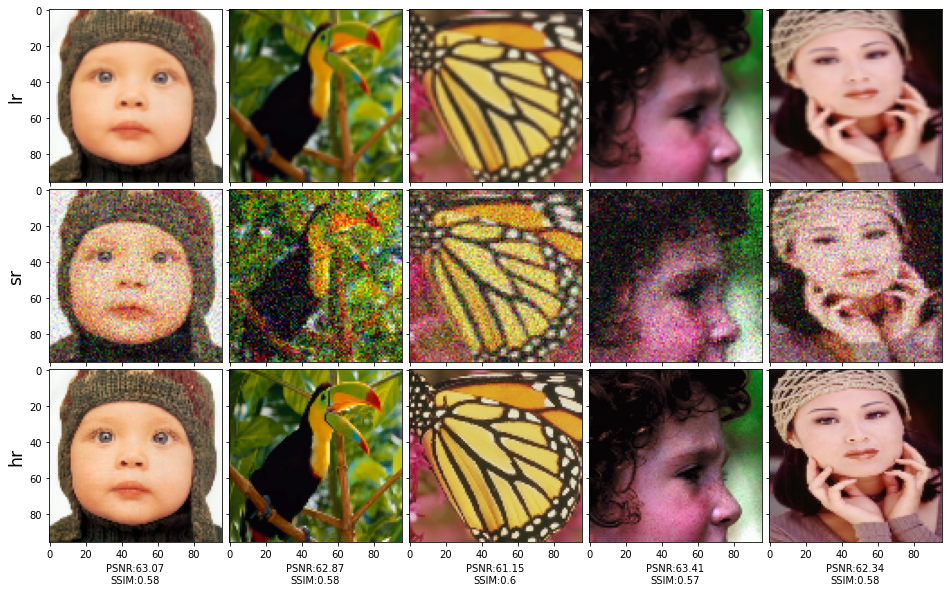

In [ ]:
in_set_first = get_images_set(set5_first)
show_grid(
    images=in_set_first, 
    rows=3, 
    cols=5, 
    psnr_values=psnr_values_first, 
    ssim_values=ssim_values_first
    )

The output grid shows **low resolution images at row 0**, **super resolved images at row 1** and **original high resolution images at row 2**.

**Evaluation metrics** are provided under each image.

As we expected, the images are highly affected by noise. This is due to the fact that the algorithm we used introduced some randomness.

We can also notice how in this case PSNR values are higher that the SSIM ones, when compared. This is a proof of how SSIM values match better with perceived visual quality than PSNR ones.

# SRGAN approach

We decided to get inspired to one of those models considered to be the state of the art with respect to the super resolution task. In [this](https://arxiv.org/pdf/1609.04802.pdf) paper we read about the so called *SRGAN*. With the term *SRGAN* we indicate a GAN (*Generative Adversarial Network*) trained purposely for the Super Resolution (*SR*) task.

Model architecture and loss functions code is based on the following [repository](https://github.com/leftthomas/SRGAN
).

### Configuration variables

In [ ]:
LEARNING_RATE = 1e-4
NUM_EPOCHS = 100
TRAINING_BATCH_SIZE = 16
VALIDATION_BATCH_SIZE = 1

DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
NUM_WORKERS = os.cpu_count()

CHECKPOINT_GEN = 'gen.pth'
CHECKPOINT_DISC = 'disc.pth'
CHECKPOINT_IMPROVED_GEN = 'gen_improved.pth'
CHECKPOINT_IMPROVED_DISC = 'disc_improved.pth'
LOAD_MODEL = True
SAVE_MODEL = True
SHOW_RESULTS = True


In [ ]:
#DataLoaders

train_loader = DataLoader(dataset=train_dataset, num_workers=NUM_WORKERS, batch_size=TRAINING_BATCH_SIZE, shuffle=True)
val_loader = DataLoader(dataset=val_dataset, num_workers=NUM_WORKERS, batch_size=VALIDATION_BATCH_SIZE, shuffle=False)


### Utility functions

Prints an image grid

In [ ]:
def show_tensor_images(image_tensor):
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:4], nrow=4)
    plt.axis('off')
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()
    

Once every 10 iterations, the loss of the network (either generator or discriminator) is appended into a list. Such list will be eventually plotted

In [ ]:
def update_plot_data(net, loss):
    net.counter += 1
    if (net.counter % 10 == 0):
        net.progress.append(loss.item())
        pass
        

This function allows us to print plots of collected data

In [ ]:
def plot_progress(self, label, yticks, ylim, color, marker):
    df = pd.DataFrame(self, columns=[label])
    df.plot(
        ylim=ylim,
        figsize=(16, 8),
        alpha=0.5,
        marker=marker,
        grid=True,
        yticks=yticks,
        color=color,
    )
    

In [ ]:
def save_checkpoint(model, optimizer, filename='my_checkpoint.pth'):
    print ('=> Saving checkpoint')
    checkpoint = {'state_dict': model.state_dict(),
                  'optimizer': optimizer.state_dict()}
    torch.save(checkpoint, filename)


def load_checkpoint(checkpoint_file, model, optimizer, lr):
    print ('=> Loading checkpoint')
    checkpoint = torch.load(checkpoint_file, map_location=DEVICE)
    model.load_state_dict(checkpoint['state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer'])
    model.eval()


The following returns an array of super resolved images from the low resolution ones in Set5 dataset, given a generator

In [ ]:
def get_sr_images(generator):
    out_set = []
    for lr in low_res_images:
        input = lr.to(DEVICE).view(1, 3, lr.shape[1], lr.shape[2])
        sr = generator(input).to('cpu').detach()
        output = sr.view(3, sr.shape[2], sr.shape[3])
        out_set.append(output)
    return out_set


## Basic blocks 

One of the most powerful design choice behind SRGAN is the *residual block*.
In traditional neural networks, each layer feeds into the next layer. In a network with residual blocks, each layer feeds into the next layer and directly into the layers about 2–3 hops away.

In [ ]:
class ResidualBlock(nn.Module):

    def __init__(self, channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(channels, channels, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(channels)
        self.prelu = nn.PReLU()
        self.conv2 = nn.Conv2d(channels, channels, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(channels)

    def forward(self, x):
        residual = self.conv1(x)
        residual = self.bn1(residual)
        residual = self.prelu(residual)
        residual = self.conv2(residual)
        residual = self.bn2(residual)

        return x + residual
        

Upsampling blocks contain layers that increase the spatial resolution of images and generate a high-resolution image.

In [ ]:
class UpsampleBLock(nn.Module):

    def __init__(self, in_channels, up_scale):
        super(UpsampleBLock, self).__init__()
        self.conv = nn.Conv2d(in_channels, in_channels * up_scale ** 2,
                              kernel_size=3, padding=1)
        self.pixel_shuffle = nn.PixelShuffle(up_scale)
        self.prelu = nn.PReLU()

    def forward(self, x):
        x = self.conv(x)
        x = self.pixel_shuffle(x)
        x = self.prelu(x)
        return x
        

## Generator

The generator architecture

> ![SRGAN Generator](https://drive.google.com/uc?id=10Cl3TG7cdtw8x5YMb128-jH-xw9Yz90U)

In [ ]:
class Generator(nn.Module):

    def __init__(self, scale_factor):
        upsample_block_num = int(math.log(scale_factor, 2))

        super(Generator, self).__init__()
        self.block1 = nn.Sequential(nn.Conv2d(3, 64, kernel_size=9,
                                    padding=4), nn.PReLU())
        self.block2 = ResidualBlock(64)
        self.block3 = ResidualBlock(64)
        self.block4 = ResidualBlock(64)
        self.block5 = ResidualBlock(64)
        self.block6 = ResidualBlock(64)
        self.block7 = nn.Sequential(nn.Conv2d(64, 64, kernel_size=3,
                                    padding=1), nn.BatchNorm2d(64))
        block8 = [UpsampleBLock(64, 2) for _ in
                  range(upsample_block_num)]
        block8.append(nn.Conv2d(64, 3, kernel_size=9, padding=4))
        self.block8 = nn.Sequential(*block8)
        self.counter = 0
        self.progress = []

    def forward(self, x):
        block1 = self.block1(x)
        block2 = self.block2(block1)
        block3 = self.block3(block2)
        block4 = self.block4(block3)
        block5 = self.block5(block4)
        block6 = self.block6(block5)
        block7 = self.block7(block6)
        block8 = self.block8(block1 + block7)

        return (torch.tanh(block8) + 1) / 2
        

## Discriminator

The discriminator architecture

![SRGAN Discriminator](https://drive.google.com/uc?id=1jBBjztejMRvheLp_Iro2x4HAYHfPgmhT)

In [ ]:
class Discriminator(nn.Module):

    def __init__(self):
        super(Discriminator, self).__init__()
        self.net = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 64, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.Conv2d(256, 256, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.Conv2d(256, 512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),
            nn.Conv2d(512, 512, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(512, 1024, kernel_size=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(1024, 1, kernel_size=1),
            )
        self.counter = 0
        self.progress = []

    def forward(self, x):
        batch_size = x.size(0)
        return torch.sigmoid(self.net(x).view(batch_size))


## Loss Functions

Super Resolution goal is to estimate a *super resolved* image ($I^{SR}$) which must be as close as possible to the high resolution version ($I^{HR}$) of a low resolution input image ($I^{LR}$).
In order to achieve this, we want to solve the following:

$θ^*_G$ $=$ $arg min_{θ_G}$ $\frac{1}{N} \displaystyle\sum_{i=1}^{N} l^{SR} (G_{θ_G}(I_i^{LR}), I^{HR}_i)$

where $l^{SR}$ is a weighted combination of several loss components (*perceptual loss*).

In particular, we have:

$l^{SR}$ $=$ $l^{SR}_{image}$ $+$ $10^{-3} l^{SR}_{adv}$ $+$ $6$ $*$ $10^{-3}$ $*$ $l^{SR}_{perception}$ $+$ $2*10^{-8}*l^{SR}_{TV}$



*   $l^{SR}_{image}$ is the MSE between the generator output and the target hr image;
*   $l^{SR}_{adv}$ is $\mathbb{E}[1 - D_{Θ_D}(G_{Θ_G}(I_i^{LR}))]$;
*   $l^{SR}_{perception}$ computes the **VGG loss** between the generator output and the target hr image. In order to do that, a pretrained VGG is employed;
*   $l^{SR}_{TV}$ is **Total Variation loss**.

NOTICE: We also adopted rescaling factors for almost each single loss

#### TV loss

The *total variation loss* is analogous to *regularization loss*. This is introduced for ensuring spatial continuity and smoothness in the generated image and to avoid noisy and overly pixelated results.

In [ ]:
class TVLoss(nn.Module):

    def __init__(self, tv_loss_weight=1):
        super(TVLoss, self).__init__()
        self.tv_loss_weight = tv_loss_weight

    def forward(self, x):
        batch_size = x.size()[0]
        h_x = x.size()[2]
        w_x = x.size()[3]
        count_h = self.tensor_size(x[:, :, 1:, :])
        count_w = self.tensor_size(x[:, :, :, 1:])
        h_tv = torch.pow(x[:, :, 1:, :] - x[:, :, :h_x - 1, :], 2).sum()
        w_tv = torch.pow(x[:, :, :, 1:] - x[:, :, :, :w_x - 1], 2).sum()
        return self.tv_loss_weight * 2 * (h_tv / count_h + w_tv
                / count_w) / batch_size

    @staticmethod
    def tensor_size(t):
        return t.size()[1] * t.size()[2] * t.size()[3]


#### Generator loss

In [ ]:
class GeneratorLoss(nn.Module):

    def __init__(self):
        super(GeneratorLoss, self).__init__()
        vgg = vgg16(pretrained=True)
        loss_network = nn.Sequential(*list(vgg.features)[:31]).eval()
        for param in loss_network.parameters():
            param.requires_grad = False
        self.loss_network = loss_network
        self.mse_loss = nn.MSELoss()
        self.tv_loss = TVLoss()

    def forward(
        self,
        out_labels, # probability that input is evaluated as hr
        out_images, # output of generator
        target_images, # real hr image
        ):

        # Adversarial Loss

        adversarial_loss = torch.mean(1 - out_labels)

        # Perception Loss

        perception_loss = self.mse_loss(self.loss_network(out_images),
                self.loss_network(target_images))

        # Image Loss

        image_loss = self.mse_loss(out_images, target_images)

        # TV Loss

        tv_loss = self.tv_loss(out_images)
        return image_loss + 0.001 * adversarial_loss + 0.006 \
            * perception_loss + 2e-8 * tv_loss


#### Discriminator loss

Following state of the art [Goodfellow et al.](https://arxiv.org/pdf/1406.2661.pdf), we optimized the Discriminator network $D_{Θ_D}$ in an alternate manner along with the Generator $G_{Θ_G}$, by solving the *min-max problem*.

$min_{Θ_G}$ $max_{Θ_D}$ $𝔼_{{I_i^{HR}}∼(I_{train}^{HR})}$ $[logD_{Θ_D}(I_i^{HR})]$
$+$ $𝔼_{{I_i^{LR}}∼(I_{train}^{LR})}$ $[log(1 - D_{Θ_D}(G_{Θ_G}(I_i^{LR})))]$

## Training loop

*    **D_xs** stores values of D(x), i.e. the average output (across the batch) of 
the discriminator for the all real batch. D(x) represents the probability that the discriminator classifies x as real data. Hence, this should start close to 1 then, theoretically converge to 0.5 when generator gets better.
* **D_G_zs** has similar role. It stores tha average output of discriminator for all fake batches. In this case, we expect an initial value close to 0 which, theoretically converges to 0.5 as the generator gets better
* **psnrs** stores the values of psnr measured exclusively in the validation set
* **ssims** behaves similarly to psnrs but it holds ssim values

In [ ]:
D_xs = []
D_G_zs = []
psnrs = []
ssims = []

In [ ]:
def training_loop(D_xs, D_G_zs, psnrs, ssims, improved=False):
    netG = Generator(4).to(DEVICE)
    netD = Discriminator().to(DEVICE)

    generator_criterion = GeneratorLoss().to(DEVICE)

    optimizerG = optim.Adam(netG.parameters(), lr=LEARNING_RATE)
    optimizerD = optim.Adam(netD.parameters(), lr=LEARNING_RATE)

    for epoch in range(1, NUM_EPOCHS + 1):
        train_loop = tqdm(train_loader)

        netG.train()
        netD.train()

        batches = 0
        d_loss_holder = 0
        g_loss_holder = 0

        for (idx, (lr, hr)) in enumerate(train_loop):

        # This part concerns the improvements that are explained at
        # the end of the notebook

            if improved:
                rnd = random.randrange(1, 4, 1)
                if rnd == 1: # salt
                    lr = torch.tensor(random_noise(lr, mode='salt',
                                      amount=0.05), dtype=torch.float)
                    hr = torch.tensor(random_noise(hr, mode='salt',
                                      amount=0.05), dtype=torch.float)
                elif rnd == 2: # gaussian
                    lr = torch.tensor(random_noise(lr, mode='gaussian', mean=0,
                                      var=0.05, clip=True), dtype=torch.float)
                    hr = torch.tensor(random_noise(hr, mode='gaussian', mean=0,
                                      var=0.05, clip=True), dtype=torch.float)
                elif rnd == 3: # pepper
                    lr = torch.tensor(random_noise(lr, mode='pepper',
                                      amount=0.05), dtype=torch.float)
                    hr = torch.tensor(random_noise(hr, mode='pepper',
                                      amount=0.05), dtype=torch.float)

            batches += TRAINING_BATCH_SIZE

            real_img = hr.clone().detach().requires_grad_(True)
            real_img = real_img.to(DEVICE)
            z = lr.clone().detach().requires_grad_(True)
            z = z.to(DEVICE)
            fake_img = netG(z)

            netD.zero_grad()
            real_out = netD(real_img).mean()
            fake_out = netD(fake_img).mean()
            d_loss = 1 - real_out + fake_out

            # Update and append D(x)

            D_x = netD(real_img).view(-1).mean().item()
            D_xs.append(D_x)

            # Update the discriminator loss for plot

            update_plot_data(netD, d_loss)

            d_loss.backward(retain_graph=True)
            optimizerD.step()

            netG.zero_grad()
            fake_img = netG(z)
            fake_out = netD(fake_img).mean()
            g_loss = generator_criterion(fake_out, fake_img, real_img)

            # Update and append D(G(z))

            D_G_z = netD(fake_img).view(-1).mean().item()
            D_G_zs.append(D_G_z)

            # Update the generator loss for plot

            update_plot_data(netG, g_loss)

            g_loss.backward()
            fake_img = netG(z)
            fake_out = netD(fake_img).mean()
            optimizerG.step()

            d_loss_holder += d_loss.item() * TRAINING_BATCH_SIZE
            g_loss_holder += g_loss.item() * TRAINING_BATCH_SIZE

        with torch.no_grad():
            (lr_val, hr_val) = val_dataset[epoch - 1]
            hr_val = hr_val.to(DEVICE).view(VALIDATION_BATCH_SIZE, 3,
                    hr_val.shape[1], hr_val.shape[2])
            lr_val = lr_val.to(DEVICE).view(VALIDATION_BATCH_SIZE, 3,
                    lr_val.shape[1], lr_val.shape[2])
            netG.eval()
            sr_val = netG(lr_val)
            psnr = PSNR(hr_val, sr_val)
            psnrs.append(psnr)
            ssim = SSIM(hr_val, sr_val)
            ssims.append(ssim)

        if(SHOW_RESULTS):
            show_tensor_images(lr)
            show_tensor_images(fake_img)
            show_tensor_images(hr)
            print(f'Epoch: {epoch}' +
                  f'\nGenerator Loss: {g_loss_holder / batches}' +
                  f'\nDiscriminator Loss: {d_loss_holder / batches}' +
                  f'\nD(x): {D_x}' +
                  f'\nD(G(z)): {D_G_z}' +
                  f'\nPSNR for validation sample {epoch-1}: {psnr}' +
                  f'\nSSIM for validation sample {epoch-1}: {ssim}')
            
    if SAVE_MODEL:
        if improved:
            save_checkpoint(netG, optimizerG, filename=CHECKPOINT_IMPROVED_GEN)
            save_checkpoint(netD, optimizerD, filename=CHECKPOINT_IMPROVED_DISC)
        else:
            save_checkpoint(netG, optimizerG, filename=CHECKPOINT_GEN)
            save_checkpoint(netD, optimizerD, filename=CHECKPOINT_DISC)

    return netG, netD

100%|██████████| 50/50 [02:01<00:00,  2.43s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


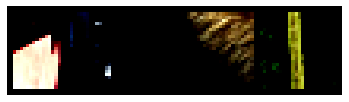

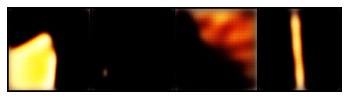

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


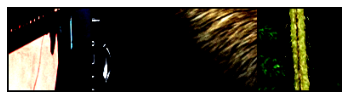

Epoch: 1
Generator Loss: 0.7068939942121506
Discriminator Loss: 0.4779755449295044
D(x): 0.9104917049407959
D(G(z)): 0.11144526302814484
PSNR for validation sample 0: 49.04628368340424
SSIM for validation sample 0: 0.5396045753717087


100%|██████████| 50/50 [01:58<00:00,  2.37s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


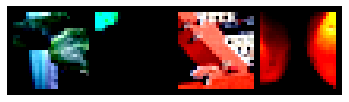

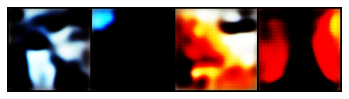

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


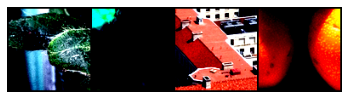

Epoch: 2
Generator Loss: 0.5696104073524475
Discriminator Loss: 0.07525164574384689
D(x): 0.9832708239555359
D(G(z)): 0.01154179498553276
PSNR for validation sample 1: 47.70271404671168
SSIM for validation sample 1: 0.5218740187145902


100%|██████████| 50/50 [01:59<00:00,  2.38s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


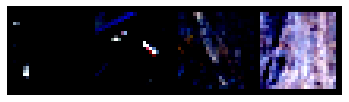

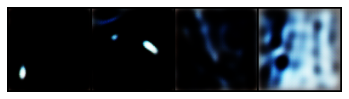

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


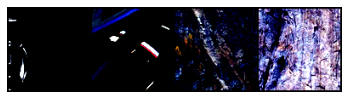

Epoch: 3
Generator Loss: 0.5582173043489456
Discriminator Loss: 0.0219275857321918
D(x): 0.996839165687561
D(G(z)): 0.0027099389117211103
PSNR for validation sample 2: 49.0802815789248
SSIM for validation sample 2: 0.49559966170435954


100%|██████████| 50/50 [01:58<00:00,  2.37s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


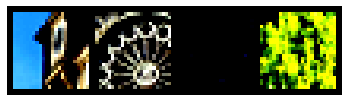

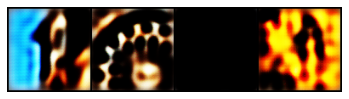

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


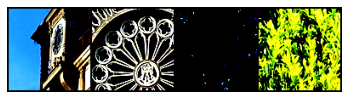

Epoch: 4
Generator Loss: 0.5499152952432632
Discriminator Loss: 0.02205936877988279
D(x): 0.9960485696792603
D(G(z)): 0.00515837874263525
PSNR for validation sample 3: 53.51241674415278
SSIM for validation sample 3: 0.5440453889956982


100%|██████████| 50/50 [01:59<00:00,  2.39s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


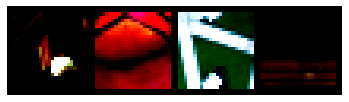

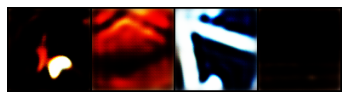

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


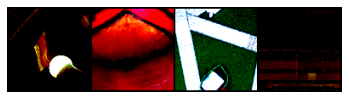

Epoch: 5
Generator Loss: 0.5455506789684296
Discriminator Loss: 0.014014448237139732
D(x): 0.9988929033279419
D(G(z)): 0.002003359142690897
PSNR for validation sample 4: 58.20114517971944
SSIM for validation sample 4: 0.6189260062159019


100%|██████████| 50/50 [01:58<00:00,  2.36s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


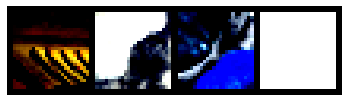

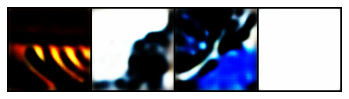

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


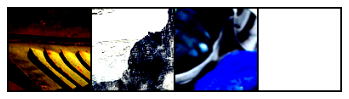

Epoch: 6
Generator Loss: 0.5427524638175965
Discriminator Loss: 0.0033864169754087925
D(x): 0.9993717670440674
D(G(z)): 0.0009055349510163069
PSNR for validation sample 5: 48.813667777799346
SSIM for validation sample 5: 0.5205356888520093


100%|██████████| 50/50 [01:58<00:00,  2.37s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


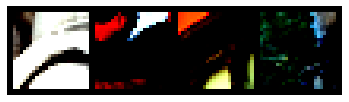

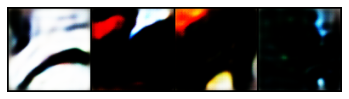

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


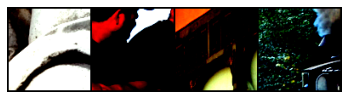

Epoch: 7
Generator Loss: 0.540359126329422
Discriminator Loss: 0.0021787427039816976
D(x): 0.9989548921585083
D(G(z)): 0.00036068324698135257
PSNR for validation sample 6: 48.40636136145635
SSIM for validation sample 6: 0.5165939222520568


100%|██████████| 50/50 [01:59<00:00,  2.39s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


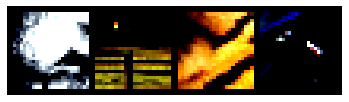

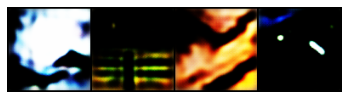

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


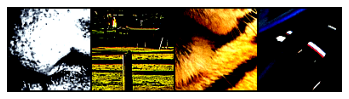

Epoch: 8
Generator Loss: 0.5377454197406769
Discriminator Loss: 0.003998186519602313
D(x): 0.9997796416282654
D(G(z)): 0.0007660954724997282
PSNR for validation sample 7: 52.54450791016306
SSIM for validation sample 7: 0.5403987019945118


100%|██████████| 50/50 [02:00<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


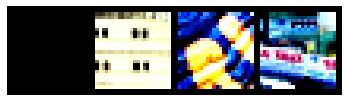

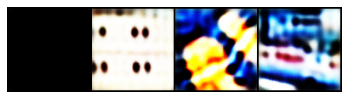

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


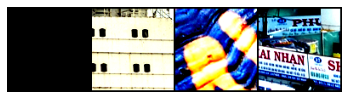

Epoch: 9
Generator Loss: 0.5361421030759811
Discriminator Loss: 0.002120486747007817
D(x): 0.9997279047966003
D(G(z)): 0.00043397670378908515
PSNR for validation sample 8: 55.05135261255585
SSIM for validation sample 8: 0.681835050866692


100%|██████████| 50/50 [01:58<00:00,  2.36s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


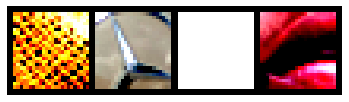

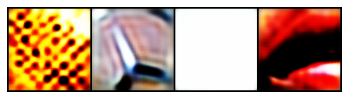

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


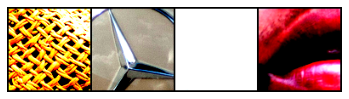

Epoch: 10
Generator Loss: 0.5346654486656189
Discriminator Loss: 0.0010687119798967616
D(x): 0.9995912909507751
D(G(z)): 0.0003202689695172012
PSNR for validation sample 9: 51.58026085207489
SSIM for validation sample 9: 0.503165102511004


100%|██████████| 50/50 [01:58<00:00,  2.37s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


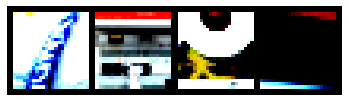

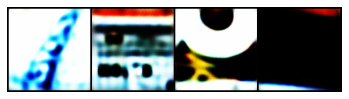

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


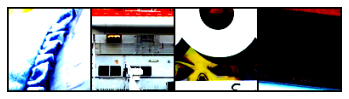

Epoch: 11
Generator Loss: 0.5334696090221405
Discriminator Loss: 0.0010978575964691118
D(x): 0.9997007846832275
D(G(z)): 0.0001805357460398227
PSNR for validation sample 10: 47.503172521336055
SSIM for validation sample 10: 0.5001116638346259


100%|██████████| 50/50 [01:58<00:00,  2.38s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


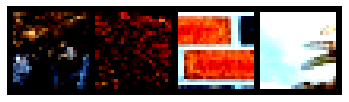

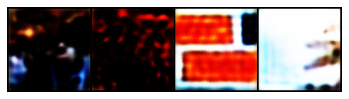

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


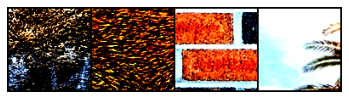

Epoch: 12
Generator Loss: 0.532053427696228
Discriminator Loss: 0.0008585667388979345
D(x): 0.9997789859771729
D(G(z)): 0.00010349161311751232
PSNR for validation sample 11: 48.123576837776
SSIM for validation sample 11: 0.5015633872453696


100%|██████████| 50/50 [02:03<00:00,  2.47s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


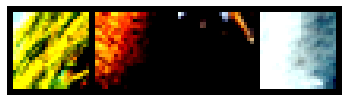

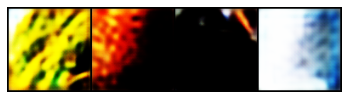

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


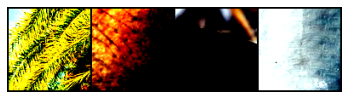

Epoch: 13
Generator Loss: 0.5309331405162812
Discriminator Loss: 0.0006401327176718041
D(x): 0.9997349977493286
D(G(z)): 0.00021221948554739356
PSNR for validation sample 12: 47.26210546919722
SSIM for validation sample 12: 0.5131694553103835


100%|██████████| 50/50 [02:11<00:00,  2.63s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


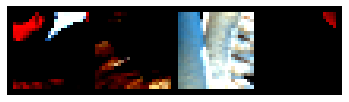

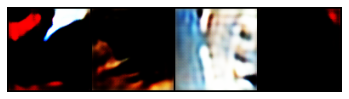

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


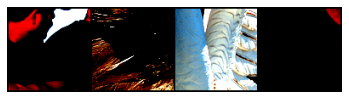

Epoch: 14
Generator Loss: 0.5301188081502914
Discriminator Loss: 0.00070144939905731
D(x): 0.9998497366905212
D(G(z)): 0.00019200248061679304
PSNR for validation sample 13: 54.375915863051276
SSIM for validation sample 13: 0.5747356639906763


100%|██████████| 50/50 [01:59<00:00,  2.39s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


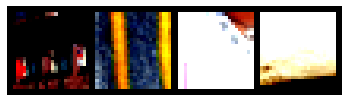

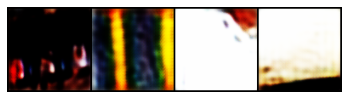

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


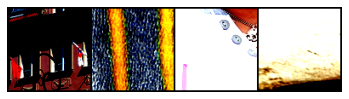

Epoch: 15
Generator Loss: 0.529642825126648
Discriminator Loss: 0.0005851159096346237
D(x): 0.9996520280838013
D(G(z)): 0.0001865337253548205
PSNR for validation sample 14: 55.30947978977291
SSIM for validation sample 14: 0.6059563185477378


100%|██████████| 50/50 [02:12<00:00,  2.65s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


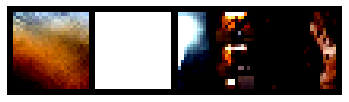

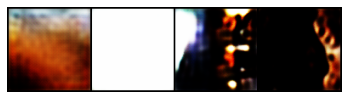

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


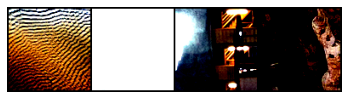

Epoch: 16
Generator Loss: 0.5290919190645218
Discriminator Loss: 0.00044730965921189634
D(x): 0.9998759627342224
D(G(z)): 8.246190554928035e-05
PSNR for validation sample 15: 52.009839298177
SSIM for validation sample 15: 0.5320702671718776


100%|██████████| 50/50 [02:20<00:00,  2.81s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


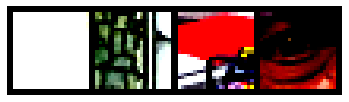

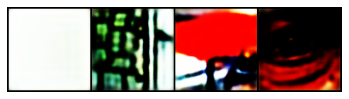

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


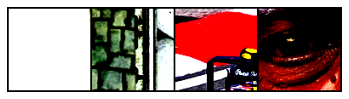

Epoch: 17
Generator Loss: 0.5283830332756042
Discriminator Loss: 0.000425658258900512
D(x): 0.9996991157531738
D(G(z)): 0.0011645294725894928
PSNR for validation sample 16: 55.16536695947004
SSIM for validation sample 16: 0.6435016825270834


100%|██████████| 50/50 [02:08<00:00,  2.56s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


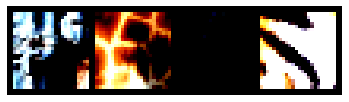

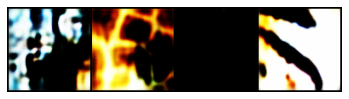

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


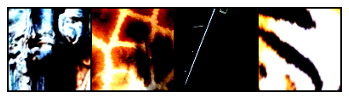

Epoch: 18
Generator Loss: 0.5277352350950241
Discriminator Loss: 0.0003107040180475451
D(x): 0.9998836517333984
D(G(z)): 0.0002232710539828986
PSNR for validation sample 17: 53.34722211940001
SSIM for validation sample 17: 0.6230161105366895


100%|██████████| 50/50 [02:22<00:00,  2.84s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


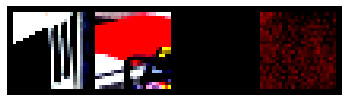

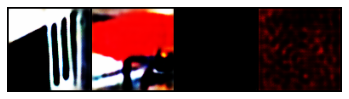

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


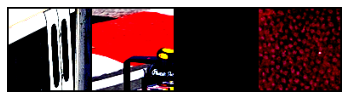

Epoch: 19
Generator Loss: 0.527359876036644
Discriminator Loss: 0.00025863386443234046
D(x): 0.9998993873596191
D(G(z)): 8.556574903195724e-05
PSNR for validation sample 18: 50.35439901206951
SSIM for validation sample 18: 0.5091153019924242


100%|██████████| 50/50 [02:09<00:00,  2.59s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


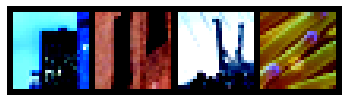

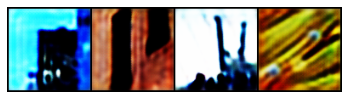

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


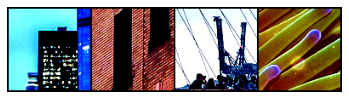

Epoch: 20
Generator Loss: 0.5271281462907791
Discriminator Loss: 0.00026176951112574895
D(x): 0.9999268054962158
D(G(z)): 0.00019811281526926905
PSNR for validation sample 19: 56.441203534231036
SSIM for validation sample 19: 0.6381429101807999


100%|██████████| 50/50 [02:19<00:00,  2.78s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


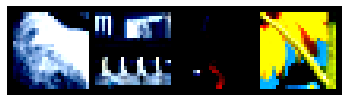

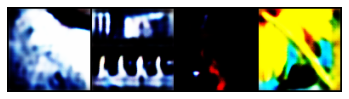

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


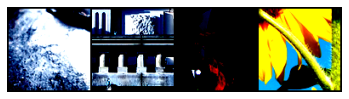

Epoch: 21
Generator Loss: 0.5265136098861695
Discriminator Loss: 0.00024239728634711355
D(x): 0.9999602437019348
D(G(z)): 0.00012014593812637031
PSNR for validation sample 20: 44.85602907393535
SSIM for validation sample 20: 0.5000809720163825


100%|██████████| 50/50 [02:29<00:00,  2.98s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


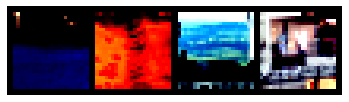

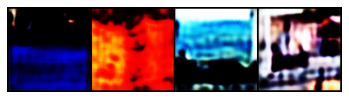

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


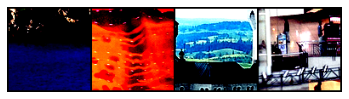

Epoch: 22
Generator Loss: 0.526040118932724
Discriminator Loss: 0.00017938009594217874
D(x): 0.9999136328697205
D(G(z)): 9.434607636649162e-05
PSNR for validation sample 21: 58.304525694934924
SSIM for validation sample 21: 0.6244589064675601


100%|██████████| 50/50 [02:14<00:00,  2.70s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


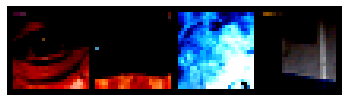

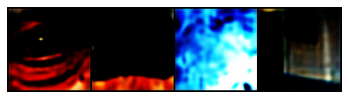

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


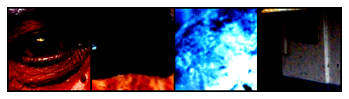

Epoch: 23
Generator Loss: 0.5256429278850555
Discriminator Loss: 0.0002583060890901834
D(x): 0.9999587535858154
D(G(z)): 7.132201426429674e-05
PSNR for validation sample 22: 55.42362809468216
SSIM for validation sample 22: 0.6310965627312789


100%|██████████| 50/50 [02:16<00:00,  2.73s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


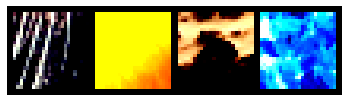

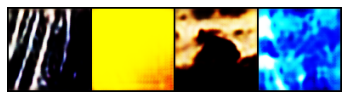

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


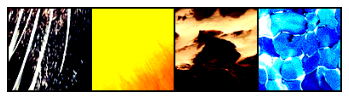

Epoch: 24
Generator Loss: 0.5254192197322846
Discriminator Loss: 0.00018805795974913053
D(x): 0.9999794960021973
D(G(z)): 0.00013040110934525728
PSNR for validation sample 23: 48.24653273678286
SSIM for validation sample 23: 0.5048880351535535


100%|██████████| 50/50 [02:04<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


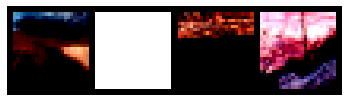

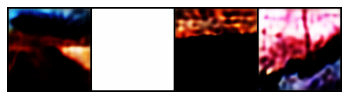

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


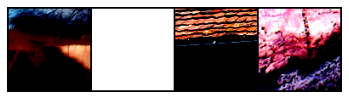

Epoch: 25
Generator Loss: 0.5251883035898208
Discriminator Loss: 0.00013509746771887875
D(x): 0.9999531507492065
D(G(z)): 4.37479029642418e-05
PSNR for validation sample 24: 48.33273145045932
SSIM for validation sample 24: 0.5391265264966677


100%|██████████| 50/50 [02:01<00:00,  2.42s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


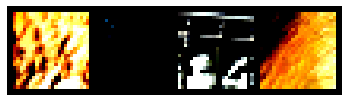

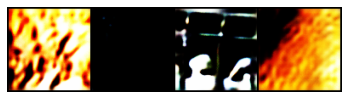

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


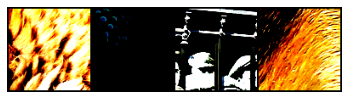

Epoch: 26
Generator Loss: 0.5245879858732223
Discriminator Loss: 0.00023345599460299126
D(x): 0.9999478459358215
D(G(z)): 5.025170685257763e-05
PSNR for validation sample 25: 51.55616681706613
SSIM for validation sample 25: 0.5595510868593717


100%|██████████| 50/50 [02:11<00:00,  2.63s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


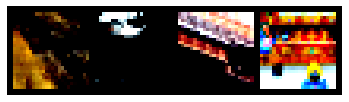

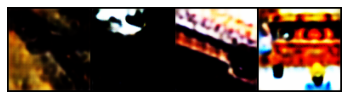

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


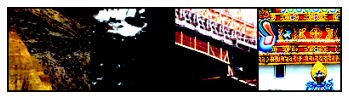

Epoch: 27
Generator Loss: 0.5248900598287582
Discriminator Loss: 0.0001928976857016096
D(x): 0.9994369149208069
D(G(z)): 0.0004286383627913892
PSNR for validation sample 26: 53.45185891892251
SSIM for validation sample 26: 0.5049367029104024


100%|██████████| 50/50 [02:13<00:00,  2.66s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


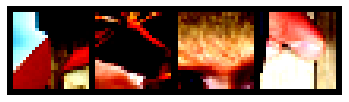

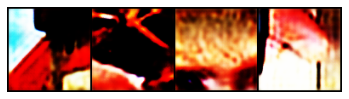

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


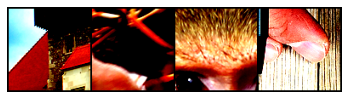

Epoch: 28
Generator Loss: 0.5243328255414963
Discriminator Loss: 0.00012187514039396774
D(x): 0.9999522566795349
D(G(z)): 4.132289905101061e-05
PSNR for validation sample 27: 47.12997632991609
SSIM for validation sample 27: 0.5047397753786845


100%|██████████| 50/50 [02:01<00:00,  2.42s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


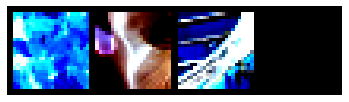

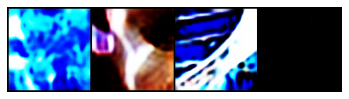

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


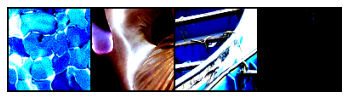

Epoch: 29
Generator Loss: 0.5243776911497116
Discriminator Loss: 0.00011351179724442772
D(x): 0.9999793767929077
D(G(z)): 2.2025260477676056e-05
PSNR for validation sample 28: 50.89554119064398
SSIM for validation sample 28: 0.5169950181980886


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


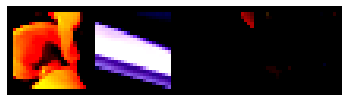

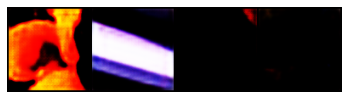

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


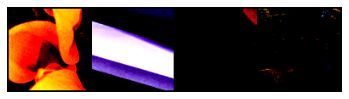

Epoch: 30
Generator Loss: 0.5238976645469665
Discriminator Loss: 0.0001045299071847694
D(x): 0.9999315142631531
D(G(z)): 3.9615584682906047e-05
PSNR for validation sample 29: 52.72556942544065
SSIM for validation sample 29: 0.5774332206829618


100%|██████████| 50/50 [02:25<00:00,  2.90s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


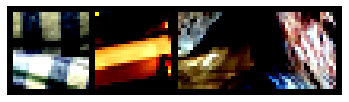

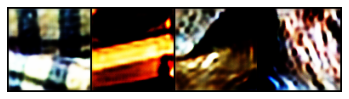

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


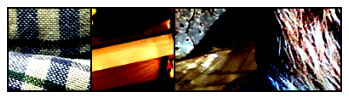

Epoch: 31
Generator Loss: 0.5237235784530639
Discriminator Loss: 8.935933346947423e-05
D(x): 0.9999640583992004
D(G(z)): 5.1115519454469904e-05
PSNR for validation sample 30: 52.516540348052764
SSIM for validation sample 30: 0.6624982641598741


100%|██████████| 50/50 [02:07<00:00,  2.54s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


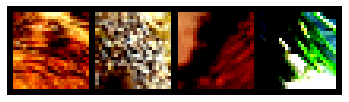

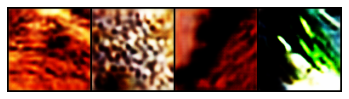

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


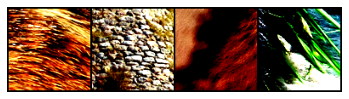

Epoch: 32
Generator Loss: 0.5237578475475311
Discriminator Loss: 9.0407675888855e-05
D(x): 0.9999520778656006
D(G(z)): 1.7636673874221742e-05
PSNR for validation sample 31: 50.244756299109056
SSIM for validation sample 31: 0.5382079430452827


100%|██████████| 50/50 [02:30<00:00,  3.00s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


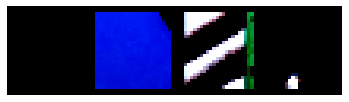

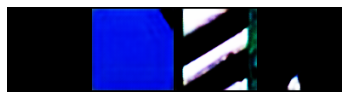

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


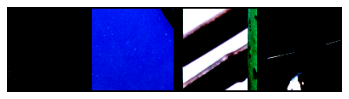

Epoch: 33
Generator Loss: 0.5233811700344085
Discriminator Loss: 0.0002599391839612508
D(x): 0.9999690651893616
D(G(z)): 1.5657507901778445e-05
PSNR for validation sample 32: 51.40002099412073
SSIM for validation sample 32: 0.7701231168931801


100%|██████████| 50/50 [02:25<00:00,  2.91s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


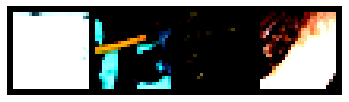

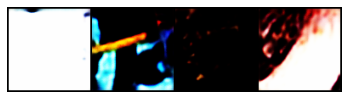

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


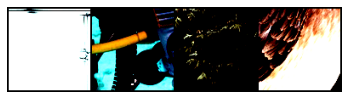

Epoch: 34
Generator Loss: 0.5229002332687378
Discriminator Loss: 0.00014407543669221922
D(x): 0.9999746084213257
D(G(z)): 1.804506428015884e-05
PSNR for validation sample 33: 49.65445496817316
SSIM for validation sample 33: 0.5022730128932881


100%|██████████| 50/50 [02:23<00:00,  2.88s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


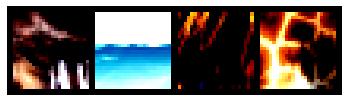

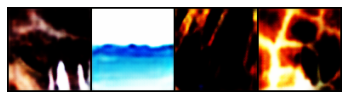

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


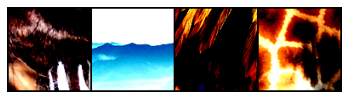

Epoch: 35
Generator Loss: 0.5229247432947158
Discriminator Loss: 0.00012619931865629042
D(x): 0.9999798536300659
D(G(z)): 1.6078955013654195e-05
PSNR for validation sample 34: 52.99880309215152
SSIM for validation sample 34: 0.514811991344638


100%|██████████| 50/50 [02:19<00:00,  2.80s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


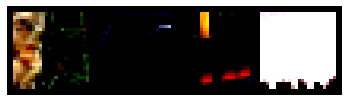

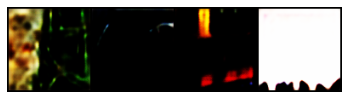

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


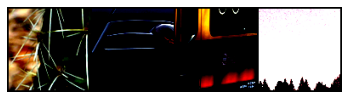

Epoch: 36
Generator Loss: 0.5226144501566887
Discriminator Loss: 0.00010034228471340611
D(x): 0.9999821186065674
D(G(z)): 6.871096957183909e-06
PSNR for validation sample 35: 51.37390709901088
SSIM for validation sample 35: 0.5613060499717348


100%|██████████| 50/50 [02:30<00:00,  3.00s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


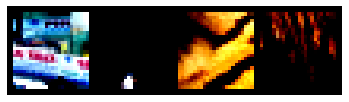

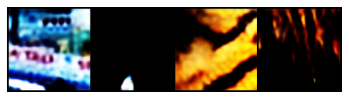

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


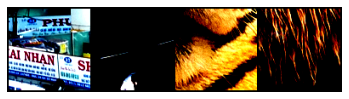

Epoch: 37
Generator Loss: 0.5225829976797104
Discriminator Loss: 8.655186120449798e-05
D(x): 0.9999809265136719
D(G(z)): 2.2205664208740927e-05
PSNR for validation sample 36: 51.68917229972824
SSIM for validation sample 36: 0.6137715550984633


100%|██████████| 50/50 [02:24<00:00,  2.89s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


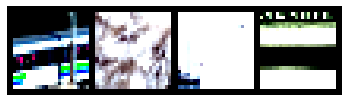

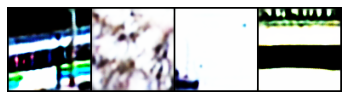

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


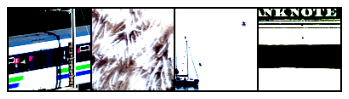

Epoch: 38
Generator Loss: 0.5220683830976486
Discriminator Loss: 8.588882206822746e-05
D(x): 0.9999576210975647
D(G(z)): 9.193663572659716e-05
PSNR for validation sample 37: 54.79395876527205
SSIM for validation sample 37: 0.6769431713250217


100%|██████████| 50/50 [02:01<00:00,  2.43s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


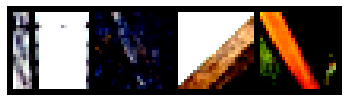

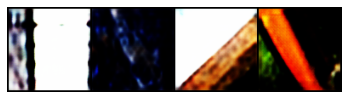

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


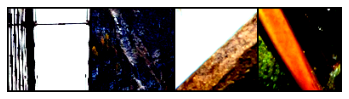

Epoch: 39
Generator Loss: 0.5220636832714081
Discriminator Loss: 8.458825759589672e-05
D(x): 0.9999871850013733
D(G(z)): 1.3261827007227112e-05
PSNR for validation sample 38: 50.92336043355267
SSIM for validation sample 38: 0.508020588219276


100%|██████████| 50/50 [02:03<00:00,  2.46s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


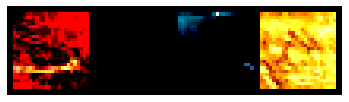

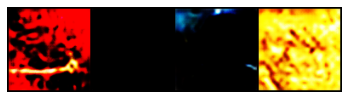

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


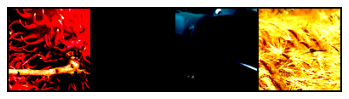

Epoch: 40
Generator Loss: 0.5219771057367325
Discriminator Loss: 0.0001595725619699806
D(x): 0.9999884963035583
D(G(z)): 8.6238769654301e-06
PSNR for validation sample 39: 48.38578900322399
SSIM for validation sample 39: 0.4998609424522122


100%|██████████| 50/50 [02:00<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


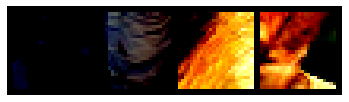

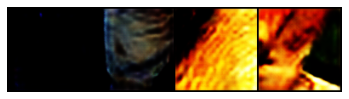

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


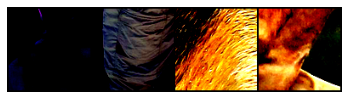

Epoch: 41
Generator Loss: 0.5220243483781815
Discriminator Loss: 0.0001132975596920005
D(x): 0.9999811053276062
D(G(z)): 0.00017345137894153595
PSNR for validation sample 40: 49.21377589113761
SSIM for validation sample 40: 0.5274010606564806


100%|██████████| 50/50 [02:00<00:00,  2.42s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


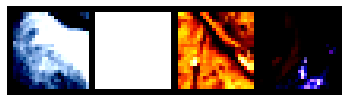

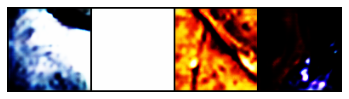

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


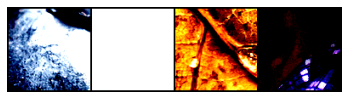

Epoch: 42
Generator Loss: 0.5219138669967651
Discriminator Loss: 5.6538188182457816e-05
D(x): 0.9999874830245972
D(G(z)): 2.1720545191783458e-05
PSNR for validation sample 41: 57.26655448768423
SSIM for validation sample 41: 0.7973523859801495


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


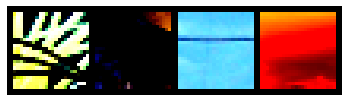

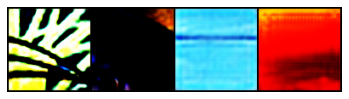

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


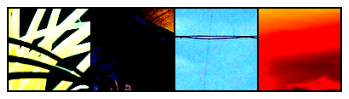

Epoch: 43
Generator Loss: 0.5217398434877396
Discriminator Loss: 4.524719861365156e-05
D(x): 0.9999909400939941
D(G(z)): 5.77217542740982e-06
PSNR for validation sample 42: 50.36440746823285
SSIM for validation sample 42: 0.5471826680839799


100%|██████████| 50/50 [01:59<00:00,  2.39s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


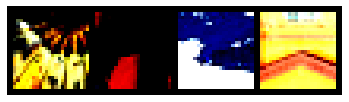

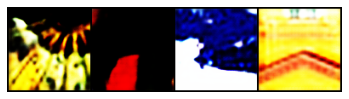

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


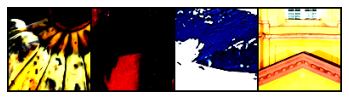

Epoch: 44
Generator Loss: 0.5212527698278427
Discriminator Loss: 4.355905675765825e-05
D(x): 0.9999964237213135
D(G(z)): 7.413667390210321e-06
PSNR for validation sample 43: 51.674125108853644
SSIM for validation sample 43: 0.917610918680634


100%|██████████| 50/50 [02:02<00:00,  2.45s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


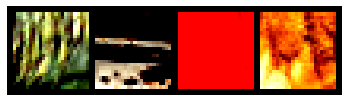

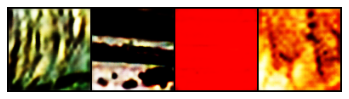

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


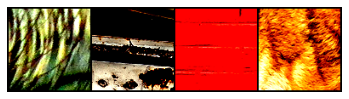

Epoch: 45
Generator Loss: 0.5209000831842423
Discriminator Loss: 4.1604525122238556e-05
D(x): 0.9999889135360718
D(G(z)): 2.4067212507361546e-05
PSNR for validation sample 44: 48.82753222289991
SSIM for validation sample 44: 0.8009810591175359


100%|██████████| 50/50 [02:23<00:00,  2.86s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


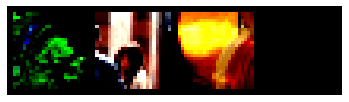

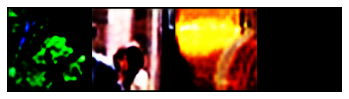

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


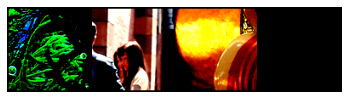

Epoch: 46
Generator Loss: 0.5207794022560119
Discriminator Loss: 4.352437124907738e-05
D(x): 0.9999927878379822
D(G(z)): 9.964052878785878e-06
PSNR for validation sample 45: 51.44355107990857
SSIM for validation sample 45: 0.6013050811004013


100%|██████████| 50/50 [02:18<00:00,  2.76s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


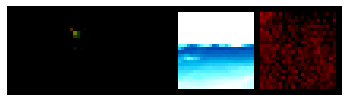

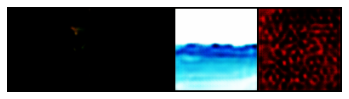

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


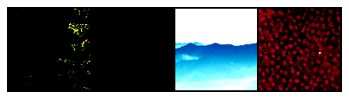

Epoch: 47
Generator Loss: 0.5205188816785813
Discriminator Loss: 3.535219149853219e-05
D(x): 0.9999687671661377
D(G(z)): 1.8804625142365694e-05
PSNR for validation sample 46: 48.03331223063041
SSIM for validation sample 46: 0.5365463649136741


100%|██████████| 50/50 [02:04<00:00,  2.49s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


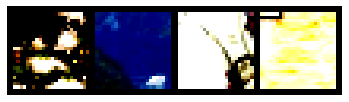

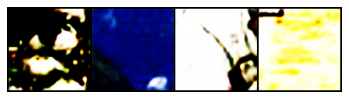

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


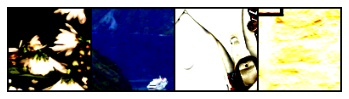

Epoch: 48
Generator Loss: 0.5205901533365249
Discriminator Loss: 3.855367374853813e-05
D(x): 0.9999783039093018
D(G(z)): 1.2857963156420738e-05
PSNR for validation sample 47: 51.79490705231839
SSIM for validation sample 47: 0.5055204548344006


100%|██████████| 50/50 [02:19<00:00,  2.78s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


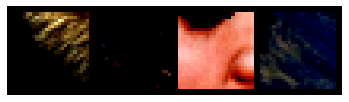

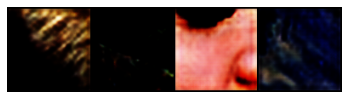

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


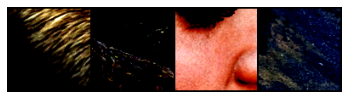

Epoch: 49
Generator Loss: 0.5208310282230377
Discriminator Loss: 3.1949790864018726e-05
D(x): 0.999970018863678
D(G(z)): 6.541104994539637e-06
PSNR for validation sample 48: 47.47724524230679
SSIM for validation sample 48: 0.502174665058752


100%|██████████| 50/50 [02:15<00:00,  2.72s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


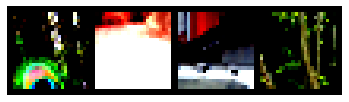

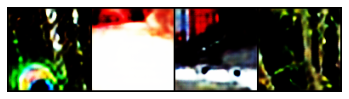

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


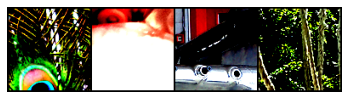

Epoch: 50
Generator Loss: 0.5203699523210525
Discriminator Loss: 2.9902872902312084e-05
D(x): 0.9999887347221375
D(G(z)): 7.834268217266072e-06
PSNR for validation sample 49: 49.71298685137193
SSIM for validation sample 49: 0.5406718883565111


100%|██████████| 50/50 [01:59<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


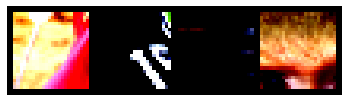

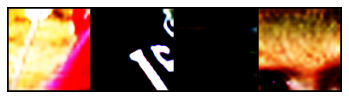

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


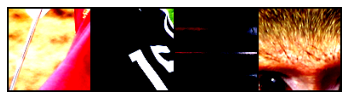

Epoch: 51
Generator Loss: 0.5201034539937973
Discriminator Loss: 3.4428200669935905e-05
D(x): 0.9999914169311523
D(G(z)): 3.6848623494734056e-06
PSNR for validation sample 50: 48.46971396475482
SSIM for validation sample 50: 0.5683684175577547


100%|██████████| 50/50 [02:01<00:00,  2.44s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


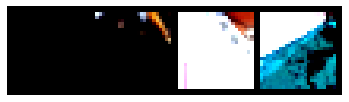

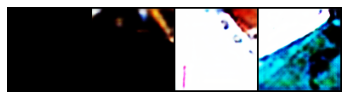

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


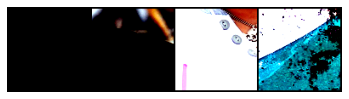

Epoch: 52
Generator Loss: 0.5200706976652145
Discriminator Loss: 3.0154353589750825e-05
D(x): 0.9999703168869019
D(G(z)): 1.7109499822254293e-05
PSNR for validation sample 51: 47.4383032074079
SSIM for validation sample 51: 0.5033389848610988


100%|██████████| 50/50 [02:00<00:00,  2.42s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


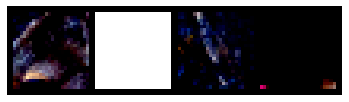

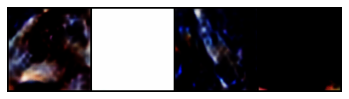

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


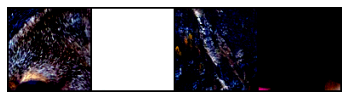

Epoch: 53
Generator Loss: 0.5201754826307297
Discriminator Loss: 4.455590144061716e-05
D(x): 0.9999674558639526
D(G(z)): 6.6327367676422e-05
PSNR for validation sample 52: 50.895816424350755
SSIM for validation sample 52: 0.5650183293240045


100%|██████████| 50/50 [02:01<00:00,  2.43s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


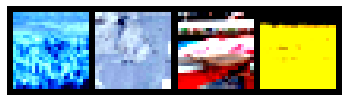

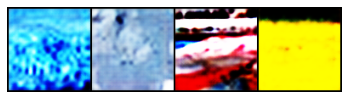

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


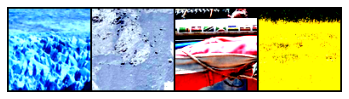

Epoch: 54
Generator Loss: 0.5197628998756408
Discriminator Loss: 3.2696290181775114e-05
D(x): 0.9999961853027344
D(G(z)): 4.6300579015223775e-06
PSNR for validation sample 53: 52.978784697522045
SSIM for validation sample 53: 0.586583196514207


100%|██████████| 50/50 [01:59<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


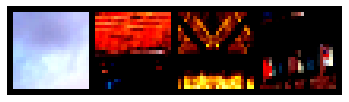

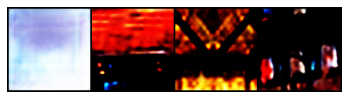

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


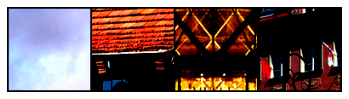

Epoch: 55
Generator Loss: 0.5195581930875778
Discriminator Loss: 2.8810689691454172e-05
D(x): 0.9999964833259583
D(G(z)): 2.723937086557271e-06
PSNR for validation sample 54: 61.59905564456406
SSIM for validation sample 54: 0.683847150354923


100%|██████████| 50/50 [02:01<00:00,  2.42s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


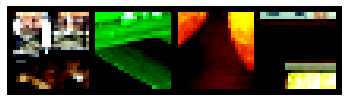

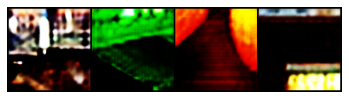

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


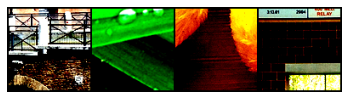

Epoch: 56
Generator Loss: 0.5196691834926606
Discriminator Loss: 2.3023189596642625e-05
D(x): 0.9999903440475464
D(G(z)): 1.0480529454071075e-05
PSNR for validation sample 55: 49.76480517155288
SSIM for validation sample 55: 0.5041886277229338


100%|██████████| 50/50 [01:59<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


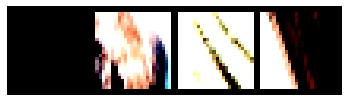

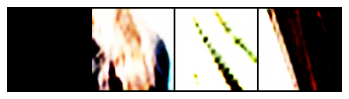

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


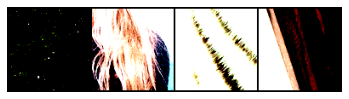

Epoch: 57
Generator Loss: 0.519299184679985
Discriminator Loss: 2.2609269763051998e-05
D(x): 0.9999939203262329
D(G(z)): 4.060659193783067e-06
PSNR for validation sample 56: 55.76676985119661
SSIM for validation sample 56: 0.8318113867591632


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


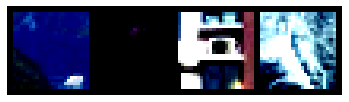

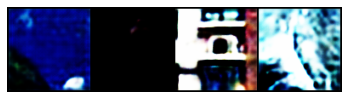

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


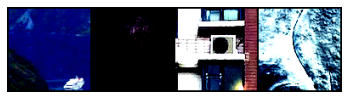

Epoch: 58
Generator Loss: 0.5190648531913757
Discriminator Loss: 2.4631448623040343e-05
D(x): 0.9999977946281433
D(G(z)): 2.6115253604075406e-06
PSNR for validation sample 57: 56.34255563430646
SSIM for validation sample 57: 0.6411917530694339


100%|██████████| 50/50 [02:02<00:00,  2.44s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


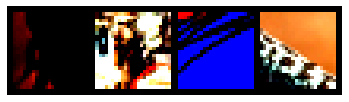

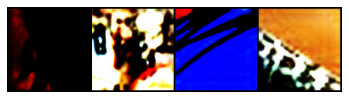

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


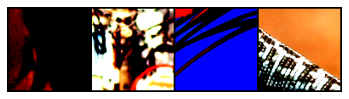

Epoch: 59
Generator Loss: 0.5191452306509018
Discriminator Loss: 2.5630140808061696e-05
D(x): 0.9999912977218628
D(G(z)): 1.3775072147836909e-05
PSNR for validation sample 58: 48.33675011172844
SSIM for validation sample 58: 0.5007157548775047


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


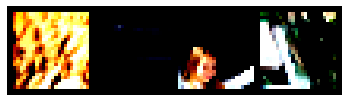

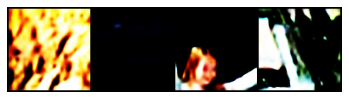

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


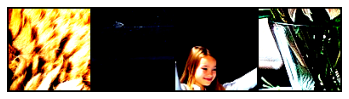

Epoch: 60
Generator Loss: 0.5186458283662796
Discriminator Loss: 1.8087857542923304e-05
D(x): 0.9999889135360718
D(G(z)): 1.6952399164438248e-05
PSNR for validation sample 59: 50.59363405178366
SSIM for validation sample 59: 0.5744276747511112


100%|██████████| 50/50 [02:01<00:00,  2.43s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


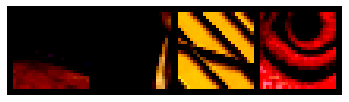

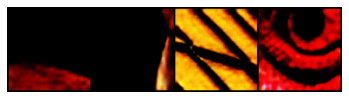

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


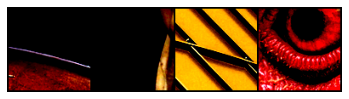

Epoch: 61
Generator Loss: 0.5186758416891099
Discriminator Loss: 2.5035043163370573e-05
D(x): 0.9998281002044678
D(G(z)): 1.1650967280729674e-05
PSNR for validation sample 60: 50.91039733989156
SSIM for validation sample 60: 0.5453472872929259


100%|██████████| 50/50 [02:00<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


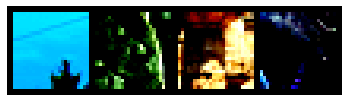

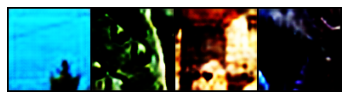

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


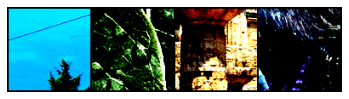

Epoch: 62
Generator Loss: 0.5185073006153107
Discriminator Loss: 1.953148042957764e-05
D(x): 0.9999945163726807
D(G(z)): 7.877119969634805e-06
PSNR for validation sample 61: 59.40760426905229
SSIM for validation sample 61: 0.5835977494322265


100%|██████████| 50/50 [02:01<00:00,  2.43s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


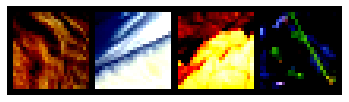

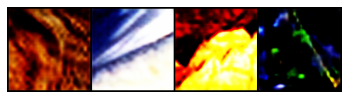

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


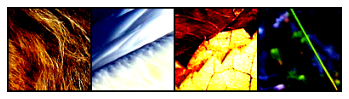

Epoch: 63
Generator Loss: 0.5186215281486511
Discriminator Loss: 2.2459426854766207e-05
D(x): 0.999985933303833
D(G(z)): 1.3530485375667922e-05
PSNR for validation sample 62: 56.52531585553871
SSIM for validation sample 62: 0.5911763607515816


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


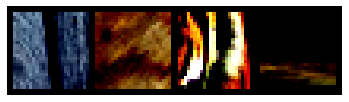

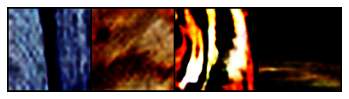

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


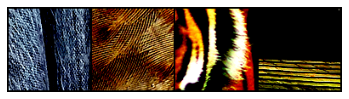

Epoch: 64
Generator Loss: 0.5184337055683136
Discriminator Loss: 1.5971431721482077e-05
D(x): 0.9999970197677612
D(G(z)): 2.2919607545190956e-06
PSNR for validation sample 63: 54.51652472231743
SSIM for validation sample 63: 0.5530975625143137


100%|██████████| 50/50 [02:00<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


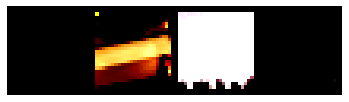

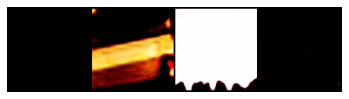

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


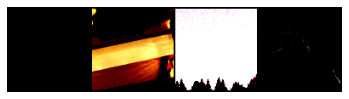

Epoch: 65
Generator Loss: 0.5182630217075348
Discriminator Loss: 1.7343269419143326e-05
D(x): 0.9999933838844299
D(G(z)): 3.6679014101537177e-06
PSNR for validation sample 64: 58.59733279949337
SSIM for validation sample 64: 0.6211640041222077


100%|██████████| 50/50 [02:01<00:00,  2.44s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


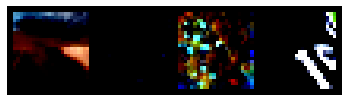

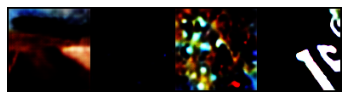

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


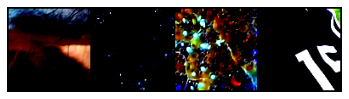

Epoch: 66
Generator Loss: 0.5182406014204025
Discriminator Loss: 1.891907287244976e-05
D(x): 0.9999946355819702
D(G(z)): 3.302801360405283e-06
PSNR for validation sample 65: 69.86293299175605
SSIM for validation sample 65: 0.7967577351465971


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


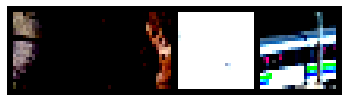

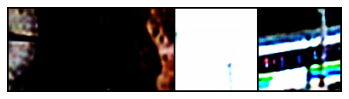

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


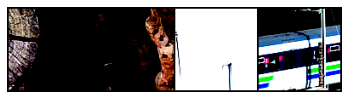

Epoch: 67
Generator Loss: 0.5176001393795013
Discriminator Loss: 1.5228236138682405e-05
D(x): 0.9999967217445374
D(G(z)): 3.1895806387183256e-06
PSNR for validation sample 66: 51.931139409572665
SSIM for validation sample 66: 0.5902560911655979


100%|██████████| 50/50 [02:01<00:00,  2.44s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


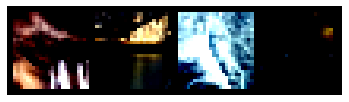

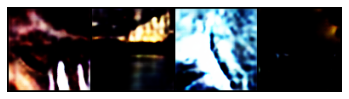

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


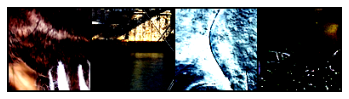

Epoch: 68
Generator Loss: 0.518074260354042
Discriminator Loss: 1.5223111654449895e-05
D(x): 0.9999932646751404
D(G(z)): 1.2399143088259734e-05
PSNR for validation sample 67: 51.09341821221852
SSIM for validation sample 67: 0.5897207179570996


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


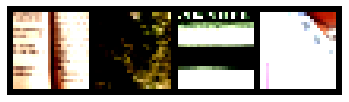

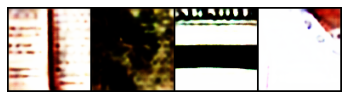

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


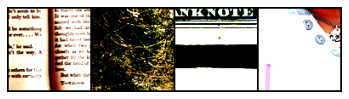

Epoch: 69
Generator Loss: 0.5174589127302169
Discriminator Loss: 1.3442563022181275e-05
D(x): 0.9999957084655762
D(G(z)): 1.9789988527918467e-06
PSNR for validation sample 68: 49.4552301471159
SSIM for validation sample 68: 0.6356420655773674


100%|██████████| 50/50 [02:01<00:00,  2.44s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


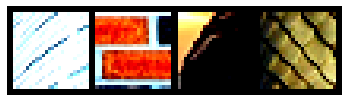

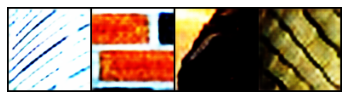

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


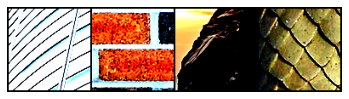

Epoch: 70
Generator Loss: 0.5172319781780242
Discriminator Loss: 1.4515315897369873e-05
D(x): 0.999961256980896
D(G(z)): 1.0757852578535676e-05
PSNR for validation sample 69: 52.71220820139107
SSIM for validation sample 69: 0.537759250423163


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


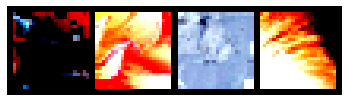

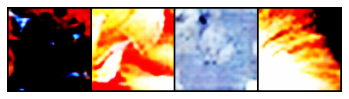

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


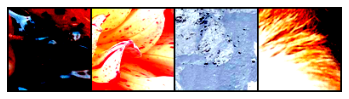

Epoch: 71
Generator Loss: 0.5173607277870178
Discriminator Loss: 1.429316562735039e-05
D(x): 0.9999961853027344
D(G(z)): 1.5964671547408216e-05
PSNR for validation sample 70: 57.52626337799434
SSIM for validation sample 70: 0.6464565787964116


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


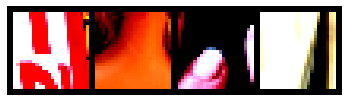

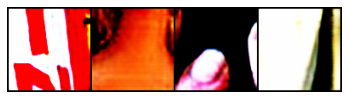

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


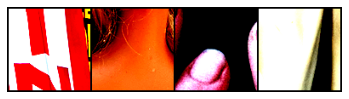

Epoch: 72
Generator Loss: 0.5174818629026413
Discriminator Loss: 1.4813303605478723e-05
D(x): 0.9999959468841553
D(G(z)): 2.8903723432449624e-06
PSNR for validation sample 71: 54.348515724596176
SSIM for validation sample 71: 0.594405432712237


100%|██████████| 50/50 [02:01<00:00,  2.43s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


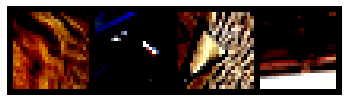

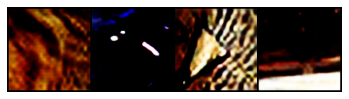

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


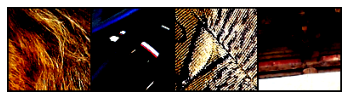

Epoch: 73
Generator Loss: 0.5172692036628723
Discriminator Loss: 1.18838258094911e-05
D(x): 0.999986469745636
D(G(z)): 2.7370108455215814e-06
PSNR for validation sample 72: 50.87193550564879
SSIM for validation sample 72: 0.502513687074198


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


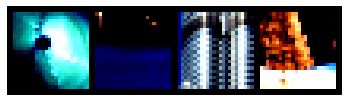

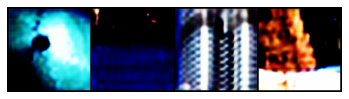

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


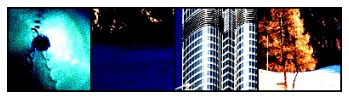

Epoch: 74
Generator Loss: 0.5168355017900467
Discriminator Loss: 1.367479277178063e-05
D(x): 0.9999935626983643
D(G(z)): 2.3760796921123983e-06
PSNR for validation sample 73: 49.058671470327155
SSIM for validation sample 73: 0.8612455377768995


100%|██████████| 50/50 [02:01<00:00,  2.43s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


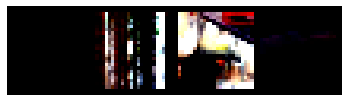

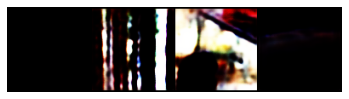

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


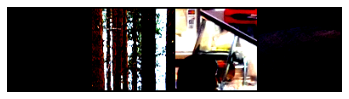

Epoch: 75
Generator Loss: 0.5168161064386367
Discriminator Loss: 1.0966059344355017e-05
D(x): 0.9999973773956299
D(G(z)): 2.1667285636794986e-06
PSNR for validation sample 74: 50.419561620093944
SSIM for validation sample 74: 0.5991332294084218


100%|██████████| 50/50 [02:00<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


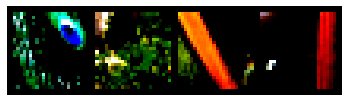

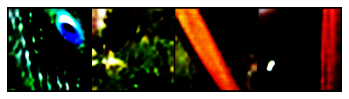

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


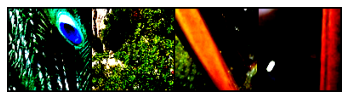

Epoch: 76
Generator Loss: 0.5170863533020019
Discriminator Loss: 1.2142886089350213e-05
D(x): 0.999997615814209
D(G(z)): 3.173234290443361e-06
PSNR for validation sample 75: 46.48635360615438
SSIM for validation sample 75: 0.4999614417820513


100%|██████████| 50/50 [02:01<00:00,  2.43s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


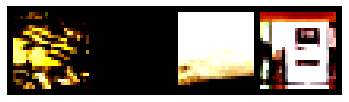

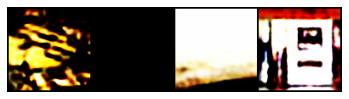

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


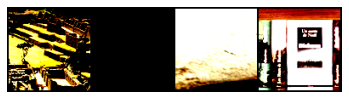

Epoch: 77
Generator Loss: 0.516377734541893
Discriminator Loss: 1.1241522711316066e-05
D(x): 0.9999970197677612
D(G(z)): 1.790078272279061e-06
PSNR for validation sample 76: 48.06332257834417
SSIM for validation sample 76: 0.503448497404227


100%|██████████| 50/50 [01:59<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


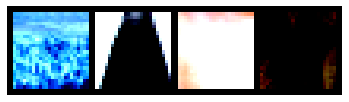

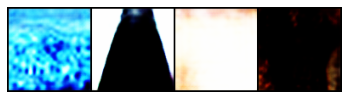

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


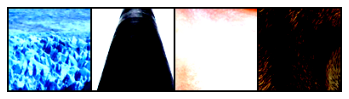

Epoch: 78
Generator Loss: 0.5162654781341552
Discriminator Loss: 1.0943964584839704e-05
D(x): 0.9999967813491821
D(G(z)): 1.9782082745223306e-06
PSNR for validation sample 77: 48.78025229030875
SSIM for validation sample 77: 0.5330720873937371


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


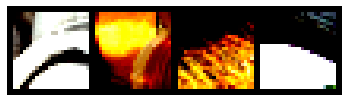

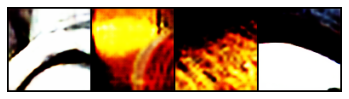

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


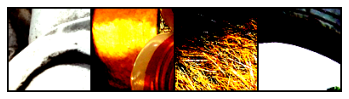

Epoch: 79
Generator Loss: 0.5159847724437714
Discriminator Loss: 1.2249466367393325e-05
D(x): 0.9999974370002747
D(G(z)): 1.4388494491868187e-05
PSNR for validation sample 78: 54.14205267687638
SSIM for validation sample 78: 0.656744245080906


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


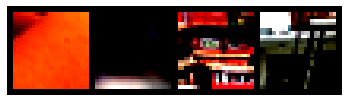

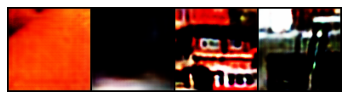

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


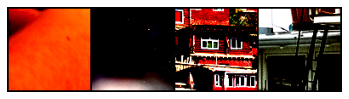

Epoch: 80
Generator Loss: 0.5159709721803665
Discriminator Loss: 1.4652510744781466e-05
D(x): 0.9999924302101135
D(G(z)): 2.7729180146707222e-05
PSNR for validation sample 79: 59.29775411775179
SSIM for validation sample 79: 0.6940559804165088


100%|██████████| 50/50 [02:00<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


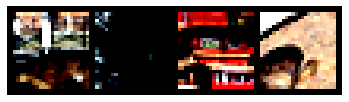

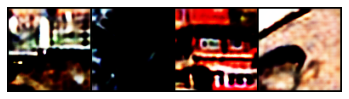

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


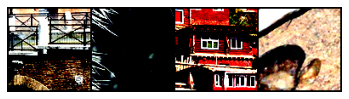

Epoch: 81
Generator Loss: 0.5159241461753845
Discriminator Loss: 1.0119242583641608e-05
D(x): 0.9999904632568359
D(G(z)): 3.9388642107951455e-06
PSNR for validation sample 80: 54.24281005285552
SSIM for validation sample 80: 0.5952461418709902


100%|██████████| 50/50 [02:02<00:00,  2.45s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


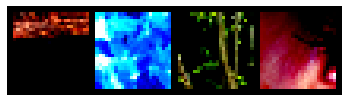

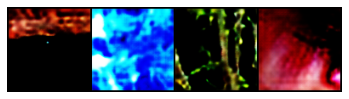

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


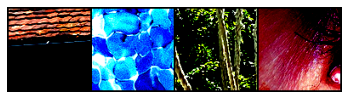

Epoch: 82
Generator Loss: 0.515778449177742
Discriminator Loss: 1.1514953994264943e-05
D(x): 0.9999988079071045
D(G(z)): 7.543961828559986e-07
PSNR for validation sample 81: 51.24518489152265
SSIM for validation sample 81: 0.6600977327714505


100%|██████████| 50/50 [01:59<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


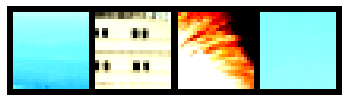

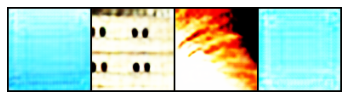

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


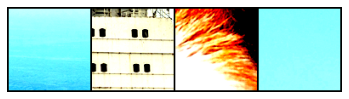

Epoch: 83
Generator Loss: 0.5156807333230973
Discriminator Loss: 9.601378073966772e-06
D(x): 0.9999980926513672
D(G(z)): 2.038173988694325e-06
PSNR for validation sample 82: 56.77856873838418
SSIM for validation sample 82: 0.5015359180871751


100%|██████████| 50/50 [02:01<00:00,  2.43s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


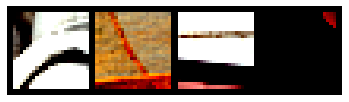

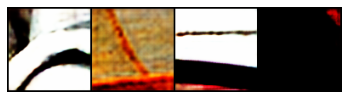

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


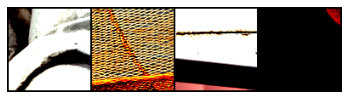

Epoch: 84
Generator Loss: 0.5152274286746978
Discriminator Loss: 8.508324108333908e-06
D(x): 0.999994158744812
D(G(z)): 4.641238319891272e-06
PSNR for validation sample 83: 52.61919539951101
SSIM for validation sample 83: 0.5764676652259341


100%|██████████| 50/50 [01:59<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


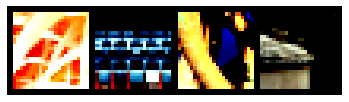

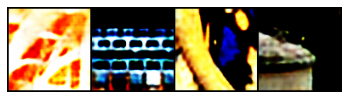

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


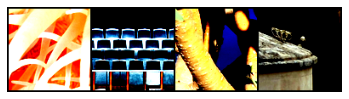

Epoch: 85
Generator Loss: 0.5154050368070603
Discriminator Loss: 7.78079468091164e-06
D(x): 0.9999955296516418
D(G(z)): 2.523242073948495e-06
PSNR for validation sample 84: 51.99640608062508
SSIM for validation sample 84: 0.5040550591615082


100%|██████████| 50/50 [02:00<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


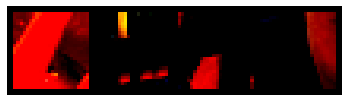

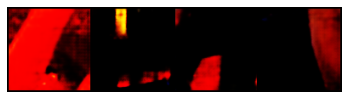

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


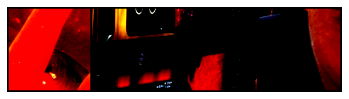

Epoch: 86
Generator Loss: 0.5149614506959915
Discriminator Loss: 6.9395094078572585e-06
D(x): 0.9999949932098389
D(G(z)): 9.906343620968983e-06
PSNR for validation sample 85: 56.19413354796301
SSIM for validation sample 85: 0.6783657431903308


100%|██████████| 50/50 [02:01<00:00,  2.43s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


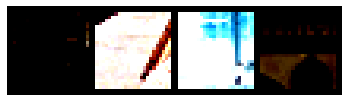

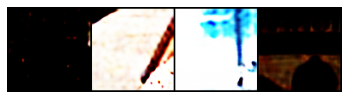

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


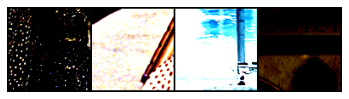

Epoch: 87
Generator Loss: 0.5151649332046508
Discriminator Loss: 6.909305693625356e-06
D(x): 0.9999972581863403
D(G(z)): 2.7656701604428235e-06
PSNR for validation sample 86: 50.453015814311904
SSIM for validation sample 86: 0.5708178170513087


100%|██████████| 50/50 [01:59<00:00,  2.40s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


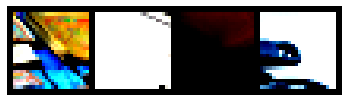

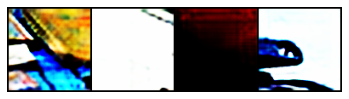

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


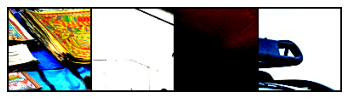

Epoch: 88
Generator Loss: 0.5150001066923141
Discriminator Loss: 1.805162723940157e-05
D(x): 0.9999955892562866
D(G(z)): 1.3175006188248517e-06
PSNR for validation sample 87: 54.26775447966632
SSIM for validation sample 87: 0.6865243057357939


100%|██████████| 50/50 [02:01<00:00,  2.42s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


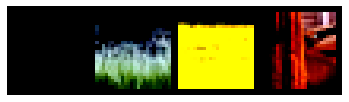

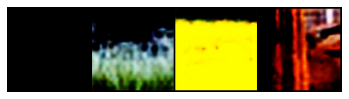

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


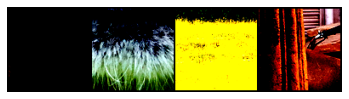

Epoch: 89
Generator Loss: 0.5149885350465775
Discriminator Loss: 1.0162456328544068e-05
D(x): 0.9999986886978149
D(G(z)): 2.1702308004023507e-06
PSNR for validation sample 88: 57.33687225611504
SSIM for validation sample 88: 0.6596429899714544


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


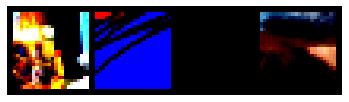

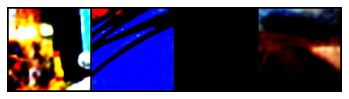

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


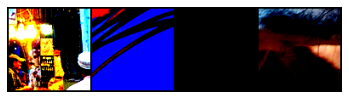

Epoch: 90
Generator Loss: 0.5144946825504303
Discriminator Loss: 6.626017443522869e-06
D(x): 0.9999924302101135
D(G(z)): 1.6698912759238738e-06
PSNR for validation sample 89: 52.66156332647853
SSIM for validation sample 89: 0.552546497299965


100%|██████████| 50/50 [02:01<00:00,  2.42s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


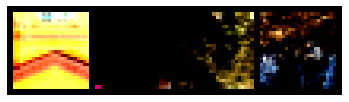

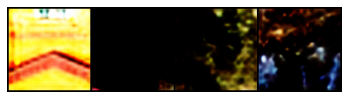

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


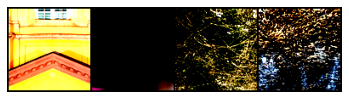

Epoch: 91
Generator Loss: 0.5140130257606507
Discriminator Loss: 6.463678917043581e-06
D(x): 0.9999959468841553
D(G(z)): 7.88849149557791e-07
PSNR for validation sample 90: 52.82077664707742
SSIM for validation sample 90: 0.6001194556588008


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


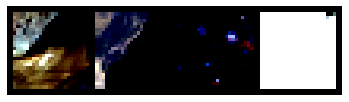

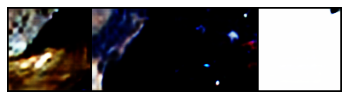

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


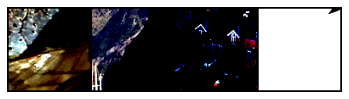

Epoch: 92
Generator Loss: 0.5140696489810943
Discriminator Loss: 6.559254343301291e-06
D(x): 0.9999927282333374
D(G(z)): 3.732107415999053e-06
PSNR for validation sample 91: 52.535802138694685
SSIM for validation sample 91: 0.504060050489818


100%|██████████| 50/50 [02:01<00:00,  2.43s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


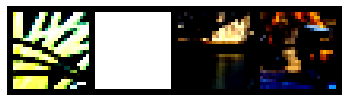

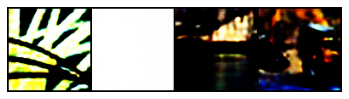

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


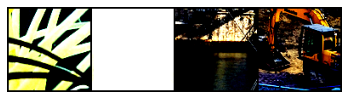

Epoch: 93
Generator Loss: 0.5139989417791366
Discriminator Loss: 6.443927773034374e-06
D(x): 0.9999982118606567
D(G(z)): 8.173180390258494e-07
PSNR for validation sample 92: 46.55862992855334
SSIM for validation sample 92: 0.5000829941272599


100%|██████████| 50/50 [02:00<00:00,  2.41s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


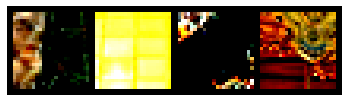

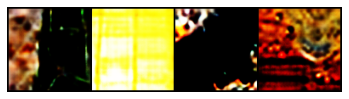

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


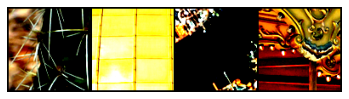

Epoch: 94
Generator Loss: 0.5138553780317306
Discriminator Loss: 5.634304286559199e-06
D(x): 0.9999980926513672
D(G(z)): 1.1434473208282725e-06
PSNR for validation sample 93: 50.727405459515694
SSIM for validation sample 93: 0.5210826438910002


100%|██████████| 50/50 [02:01<00:00,  2.43s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


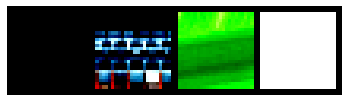

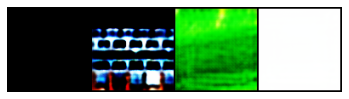

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


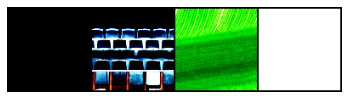

Epoch: 95
Generator Loss: 0.5134487140178681
Discriminator Loss: 5.681496534180042e-06
D(x): 0.9999984502792358
D(G(z)): 4.794329925061902e-06
PSNR for validation sample 94: 52.394437376169584
SSIM for validation sample 94: 0.5178580249709583


100%|██████████| 50/50 [02:01<00:00,  2.44s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


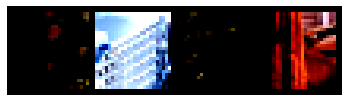

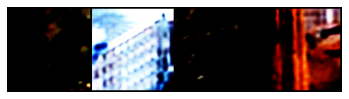

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


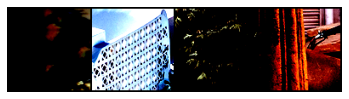

Epoch: 96
Generator Loss: 0.5137175559997559
Discriminator Loss: 4.194525456568954e-06
D(x): 0.9999967813491821
D(G(z)): 1.0403059604868758e-06
PSNR for validation sample 95: 48.940936046370396
SSIM for validation sample 95: 0.5092149615405285


100%|██████████| 50/50 [02:02<00:00,  2.44s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


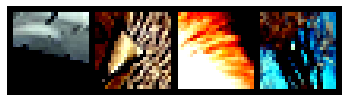

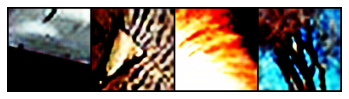

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


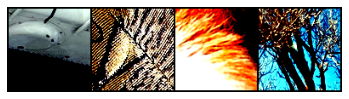

Epoch: 97
Generator Loss: 0.5134649312496186
Discriminator Loss: 6.8761140141759824e-06
D(x): 0.9999901652336121
D(G(z)): 7.990937774593476e-06
PSNR for validation sample 96: 48.270177711803
SSIM for validation sample 96: 0.5334658929283302


100%|██████████| 50/50 [02:01<00:00,  2.44s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


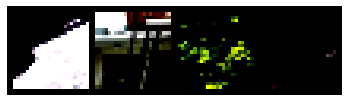

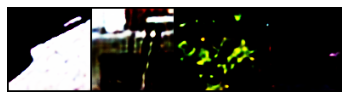

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


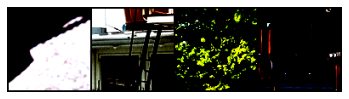

Epoch: 98
Generator Loss: 0.513618438243866
Discriminator Loss: 6.070591907700873e-06
D(x): 0.999987006187439
D(G(z)): 2.5118802113865968e-06
PSNR for validation sample 97: 51.08431638020082
SSIM for validation sample 97: 0.5854778307564591


100%|██████████| 50/50 [02:00<00:00,  2.42s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


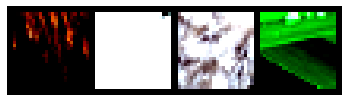

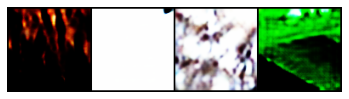

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


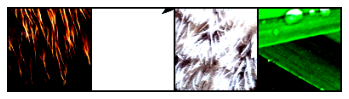

Epoch: 99
Generator Loss: 0.5135095709562302
Discriminator Loss: 5.417217589638313e-06
D(x): 0.9999985694885254
D(G(z)): 1.2556230331028928e-06
PSNR for validation sample 98: 49.3009678197668
SSIM for validation sample 98: 0.5191294165941898


100%|██████████| 50/50 [02:02<00:00,  2.45s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


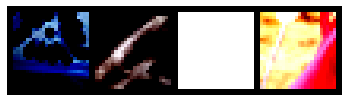

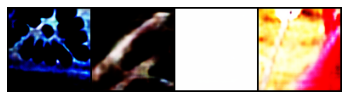

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


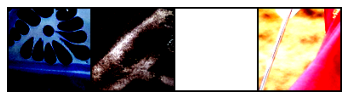

Epoch: 100
Generator Loss: 0.5134277117252349
Discriminator Loss: 5.000463602300442e-06
D(x): 0.9999973177909851
D(G(z)): 1.2627642718143761e-06
PSNR for validation sample 99: 52.59831281456175
SSIM for validation sample 99: 0.6180907080719782
=> Saving checkpoint
=> Saving checkpoint
CPU times: user 18min, sys: 38.9 s, total: 18min 39s
Wall time: 3h 29min 33s


In [ ]:
%%time

netG, netD = training_loop(D_xs, D_G_zs, psnrs, ssims)

## Training results

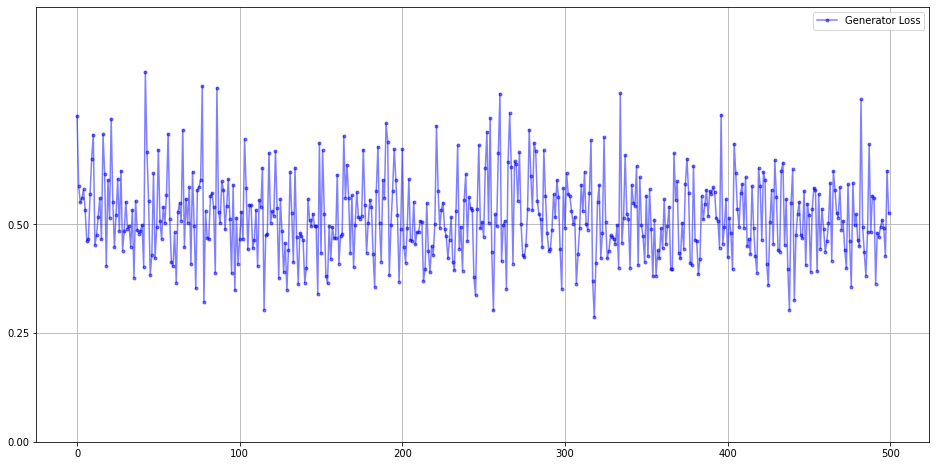

In [ ]:
plot_progress(netG.progress, "Generator Loss", (0, 0.25, 0.5), (0, 1.0), 
              "blue", ".")

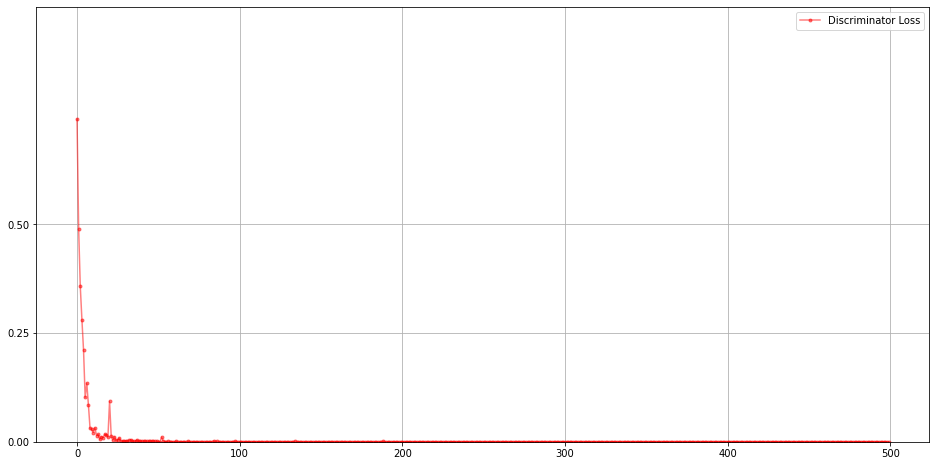

In [ ]:
plot_progress(netD.progress, "Discriminator Loss", (0, 0.25, 0.5), (0, 1.0), 
              "red", ".")

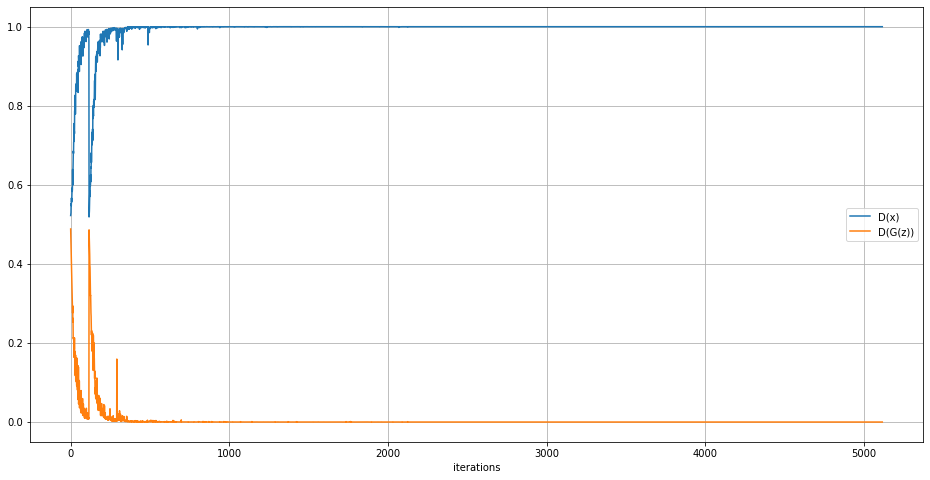

In [ ]:
# D(x) and D(G(z)) behavior
plt.figure(figsize=(16,8))
plt.plot(D_xs,label="D(x)")
plt.plot(D_G_zs,label="D(G(z))")
plt.xlabel("iterations")
plt.grid(True)
plt.legend()
plt.show()

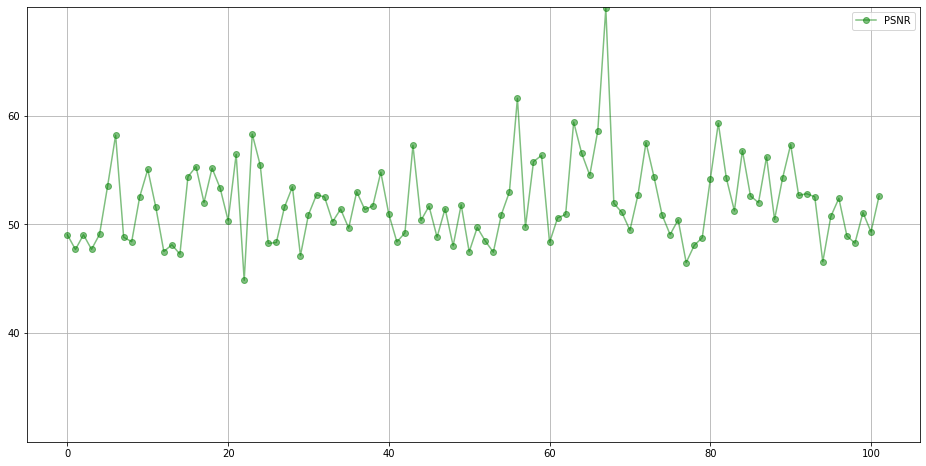

In [ ]:
plot_progress(psnrs, "PSNR", (0, 40, 50, 60), (30, 70), 
              "green", "o")

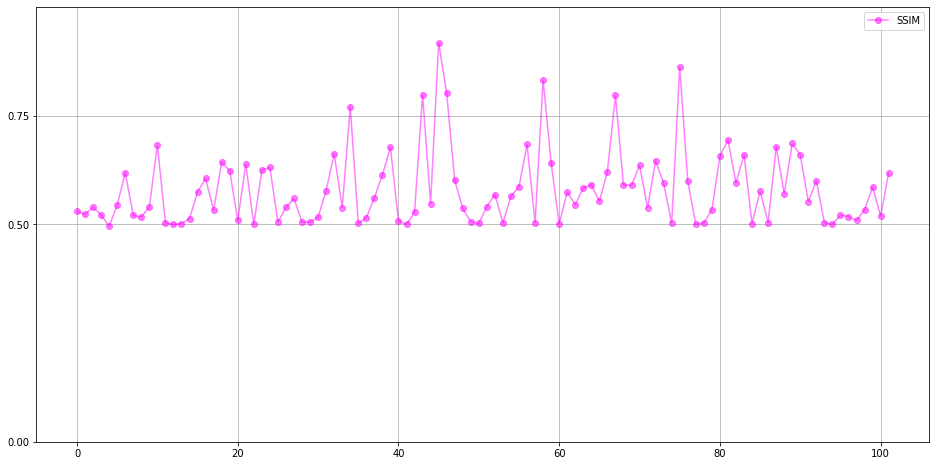

In [ ]:
plot_progress(ssims, "SSIM", (0, 0.5, 0.75), (0, 1.0), 
              "magenta", "o")

In [ ]:
if LOAD_MODEL:
    
    netG = Generator(scale_factor=4).to(DEVICE)
    netD = Discriminator().to(DEVICE)

    optimizerG = optim.Adam(netG.parameters(), lr=LEARNING_RATE)
    optimizerD = optim.Adam(netD.parameters(), lr=LEARNING_RATE)

    load_checkpoint(CHECKPOINT_GEN, netG, optimizerG, LEARNING_RATE)
    load_checkpoint(CHECKPOINT_DISC, netD, optimizerD, LEARNING_RATE)

=> Loading checkpoint
=> Loading checkpoint


## Test results

Let's evaluate the model against the popular Set5 dataset

In [ ]:
#SRGAN approach results
set5_gan = get_sr_images(netG)

In [ ]:
psnr_values_gan, ssim_values_gan = compute_PSNR_SSIM(set5_gan)

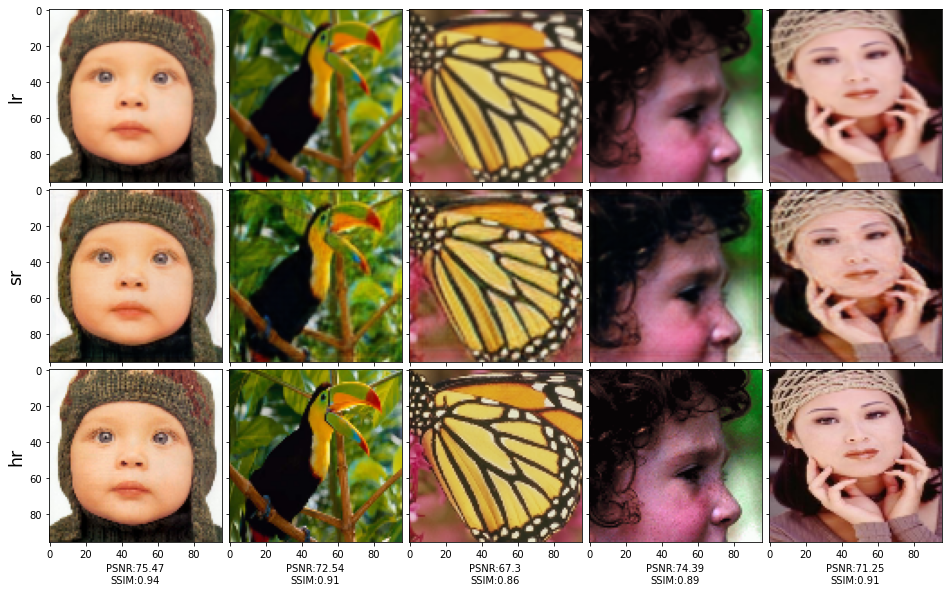

In [ ]:
in_set_gan = get_images_set(set5_gan)
show_grid(
    images=in_set_gan, 
    rows=3, 
    cols=5, 
    psnr_values=psnr_values_gan, 
    ssim_values=ssim_values_gan
    )

The output grid shows **low resolution images at row 0**, **super resolved images at row 1** and **original high resolution images at row 2**.

Results are pretty good, besides some minor artifacts, like some *blurring* and *edge halos*. This can be appreciated especially in the butterfly's wings.

Also, evaluation metric values are good.

# Comparison

We can compare our model output with the above defined trivial algorithm for image upsampling.

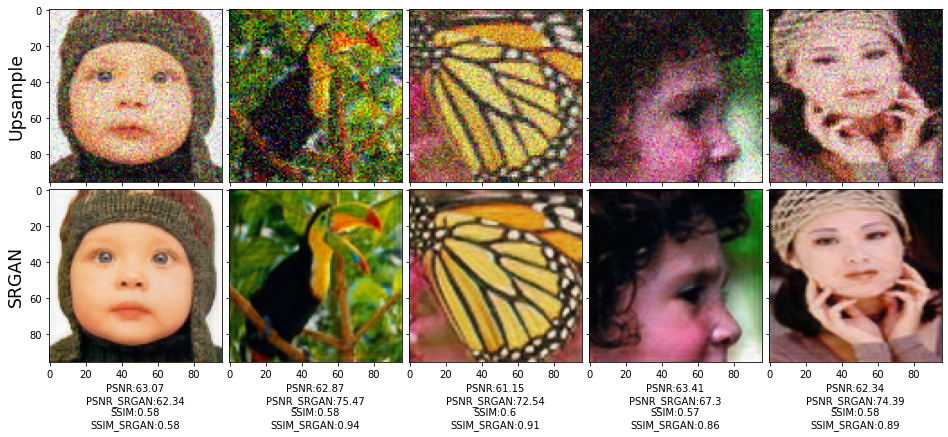

In [ ]:
in_set_comparison = join_sets(set5_first, set5_gan)
psnr_comparison = join_sets(psnr_values_first, psnr_values_gan)
ssim_comparison = join_sets(ssim_values_first, ssim_values_gan)
show_grid(
    images=in_set_comparison, 
    rows=2, 
    cols=5, 
    psnr_values=psnr_comparison, 
    ssim_values=ssim_comparison,
    first_comparison=True
    )

**NOTICE**: The values without the *_SRGAN* suffix refers to the trivial upsampling model.

There is no need to say that SRGAN completely outperform the other model. Images of the former are clearly way smoother and richer in details. Moreover, both PSNR and SSIM values of SRGAN are higher with respect to those of the trivial upsampling algorithm.

# Improvements (Instance Noise)

Even though we are pretty satisfied with the results, there is still something that could be improved. In particular, we can notice from the graph showing D(x) and D(G(z)), that they never reach 0.5, i.e., ideally, the point in which the generator is finally able to "fool" the discriminator.
By reading [this](https://arxiv.org/abs/1610.04490) paper, we convinced ourselves that a step forward in the "race to convergence" might result in an actual improvement of the model.

What emerges from the paper can be summarised in the following:


*   A major reason for GANs' instability may be that the generative distributions are weird and they don't generally overlap with the true data distribution
*   Adding noise to both real and synthetic data during training might help overcome these problems



We took advantage of the *random_noise* library from *skimage.util* to add noise to our images. We tested all the noises available in the library and, finally, we decided to use 3 of them in some random and alternate manner during the training loop.

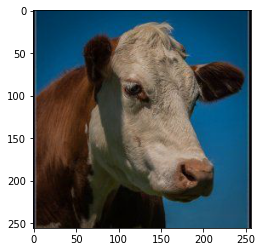

In [ ]:
# Import a co(w)ol image from web

urllib.request.urlretrieve('https://i.pinimg.com/474x/80/43/bf/8043bff85cbcc'\
                           '444a5d5feb1be7e50a2--paint-my-photo-cow.jpg','cow')
sample_image = Image.open('cow')
sample_image = T.ToTensor()(sample_image)
plt.imshow(sample_image.permute(1, 2, 0))


1. **Salt**: replaces random pixels with 1

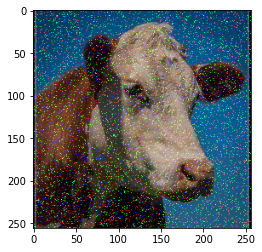

In [ ]:
salt_img = torch.tensor(random_noise(sample_image, mode='salt', amount=0.05))
plt.imshow(salt_img.permute(1, 2, 0))


2. **Gaussian**: gaussian-distributed additive noise

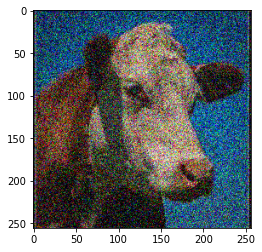

In [ ]:
gauss_img = torch.tensor(random_noise(sample_image, mode='gaussian',
                                      mean=0, var=0.05, clip=True))
plt.imshow(gauss_img.permute(1, 2, 0))


3. **Pepper**: replaces random pixels with 0

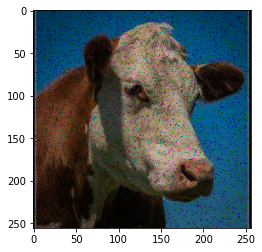

In [ ]:
pepper_img = torch.tensor(random_noise(sample_image, mode='pepper',
                                       amount=0.05))
plt.imshow(pepper_img.permute(1, 2, 0))


## Training loop

Now we train another SRGAN, this time images are going to be altered with noise (one out of the three shown above, picked randomly). In particular, we are going to solve the new problem:

$θ^*_G$ $=$ $arg min_{θ_G}$ $\frac{1}{N} \displaystyle\sum_{i=1}^{N} l^{SR} ([G_{θ_G}(I_i^{LR})]_{noisy}, [I^{HR}_i]_{noisy})$

The following variables are defined as before

In [ ]:
D_xs_improved = []

D_G_zs_improved = []
psnrs_improved = []
ssims_improved = []

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

100%|██████████| 50/50 [02:11<00:00,  2.62s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


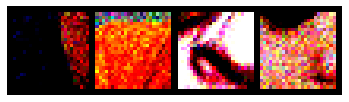

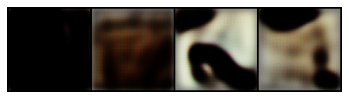

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


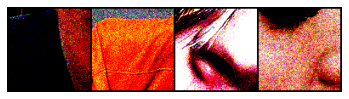

Epoch: 1
Generator Loss: 0.4993840306997299
Discriminator Loss: 0.4945676475763321
D(x): 0.9168139696121216
D(G(z)): 0.14019794762134552
PSNR for validation sample 0: 49.05317825985473
SSIM for validation sample 0: 0.5349387445892132


100%|██████████| 50/50 [02:06<00:00,  2.54s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


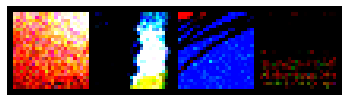

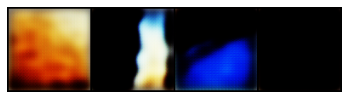

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


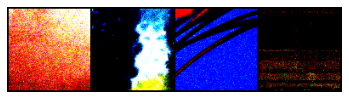

Epoch: 2
Generator Loss: 0.41214235723018644
Discriminator Loss: 0.08599746782332658
D(x): 0.9851133823394775
D(G(z)): 0.01875557377934456
PSNR for validation sample 1: 47.712655503450094
SSIM for validation sample 1: 0.5249164440332427


100%|██████████| 50/50 [02:04<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


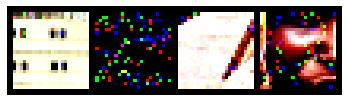

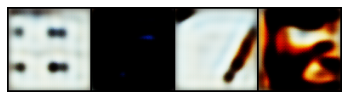

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


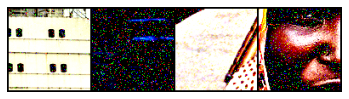

Epoch: 3
Generator Loss: 0.39245511084795
Discriminator Loss: 0.02286562316119671
D(x): 0.9967997074127197
D(G(z)): 0.0024830815382301807
PSNR for validation sample 2: 49.27254282198387
SSIM for validation sample 2: 0.48725297739958223


100%|██████████| 50/50 [02:06<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


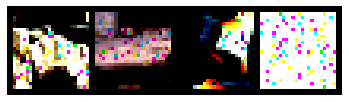

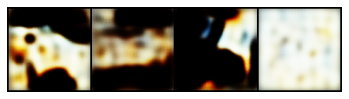

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


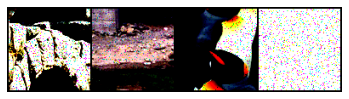

Epoch: 4
Generator Loss: 0.39512726962566375
Discriminator Loss: 0.009394692429341376
D(x): 0.996535062789917
D(G(z)): 0.003001718083396554
PSNR for validation sample 3: 53.54247496807787
SSIM for validation sample 3: 0.5459849519210258


100%|██████████| 50/50 [02:04<00:00,  2.49s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


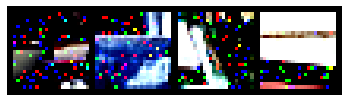

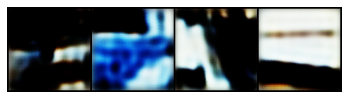

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


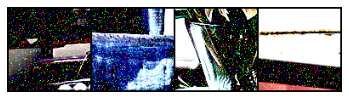

Epoch: 5
Generator Loss: 0.38490901440382
Discriminator Loss: 0.005156531035900116
D(x): 0.9988592267036438
D(G(z)): 0.0007940808427520096
PSNR for validation sample 4: 57.9953481830971
SSIM for validation sample 4: 0.6120132654702962


100%|██████████| 50/50 [02:04<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


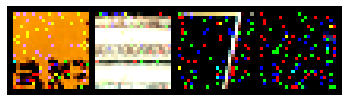

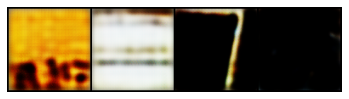

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


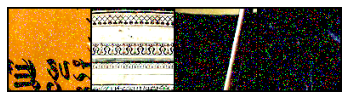

Epoch: 6
Generator Loss: 0.383261034488678
Discriminator Loss: 0.003177630694117397
D(x): 0.9986514449119568
D(G(z)): 0.0010196525836363435
PSNR for validation sample 5: 48.82389867288808
SSIM for validation sample 5: 0.5222432098027302


100%|██████████| 50/50 [02:04<00:00,  2.48s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


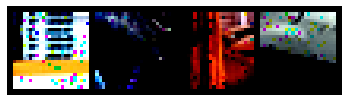

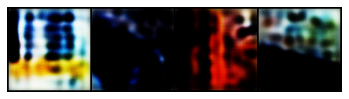

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


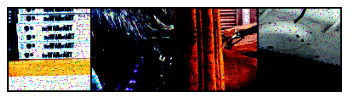

Epoch: 7
Generator Loss: 0.3788105112314224
Discriminator Loss: 0.0021126515918876974
D(x): 0.9990591406822205
D(G(z)): 0.000927616492845118
PSNR for validation sample 6: 49.30421315592487
SSIM for validation sample 6: 0.5541131441134008


100%|██████████| 50/50 [02:03<00:00,  2.48s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


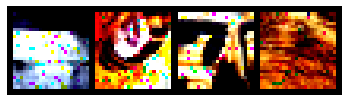

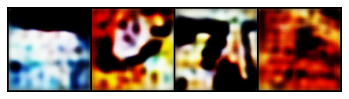

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


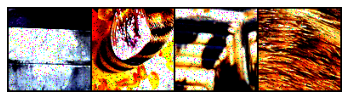

Epoch: 8
Generator Loss: 0.3756261721253395
Discriminator Loss: 0.001625032980227843
D(x): 0.9993889927864075
D(G(z)): 0.0010030369739979506
PSNR for validation sample 7: 52.56861367351309
SSIM for validation sample 7: 0.5401322969688392


100%|██████████| 50/50 [02:04<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


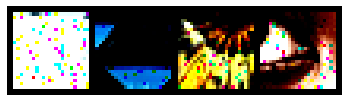

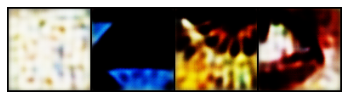

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


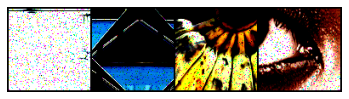

Epoch: 9
Generator Loss: 0.384042301774025
Discriminator Loss: 0.001362769435509108
D(x): 0.9990342855453491
D(G(z)): 0.0017388452542945743
PSNR for validation sample 8: 54.99266241899892
SSIM for validation sample 8: 0.6752608025410078


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


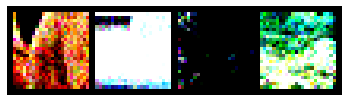

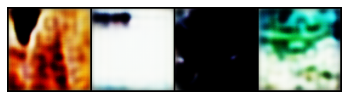

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


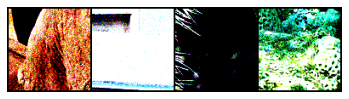

Epoch: 10
Generator Loss: 0.38273572564125063
Discriminator Loss: 0.000996385604084935
D(x): 0.999521017074585
D(G(z)): 0.0005006535211578012
PSNR for validation sample 9: 51.56512428575659
SSIM for validation sample 9: 0.5022082452601544


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


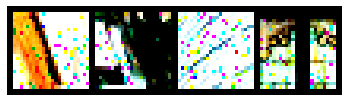

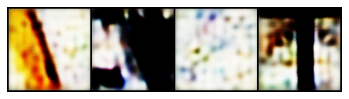

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


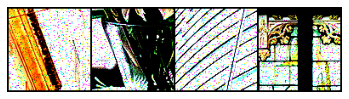

Epoch: 11
Generator Loss: 0.38617539405822754
Discriminator Loss: 0.000884229802468326
D(x): 0.9998449683189392
D(G(z)): 0.00024356070207431912
PSNR for validation sample 10: 47.50348029924659
SSIM for validation sample 10: 0.5001042883426762


100%|██████████| 50/50 [02:04<00:00,  2.49s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


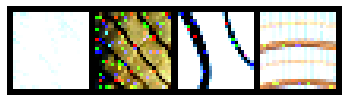

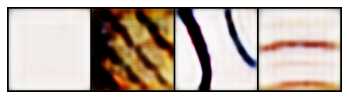

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


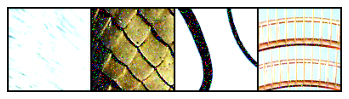

Epoch: 12
Generator Loss: 0.37627042949199674
Discriminator Loss: 0.0007778623519698157
D(x): 0.9997468590736389
D(G(z)): 0.0003876975388266146
PSNR for validation sample 11: 48.124220703301134
SSIM for validation sample 11: 0.500826894369675


100%|██████████| 50/50 [02:05<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


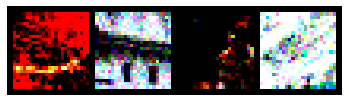

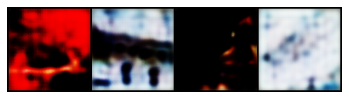

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


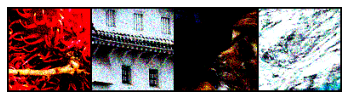

Epoch: 13
Generator Loss: 0.373016417324543
Discriminator Loss: 0.0005913036424317397
D(x): 0.9998272061347961
D(G(z)): 0.00024111535458359867
PSNR for validation sample 12: 47.24054825068543
SSIM for validation sample 12: 0.5106168691703057


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


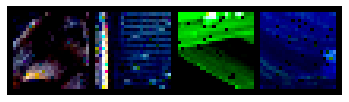

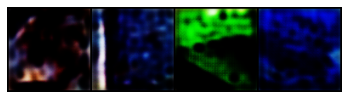

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


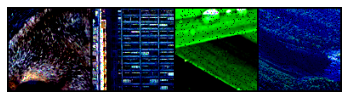

Epoch: 14
Generator Loss: 0.3928359466791153
Discriminator Loss: 0.0005443725929944776
D(x): 0.9996862411499023
D(G(z)): 0.0005385727272368968
PSNR for validation sample 13: 54.20282378560841
SSIM for validation sample 13: 0.5692820005231067


100%|██████████| 50/50 [02:06<00:00,  2.54s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


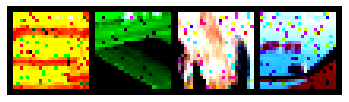

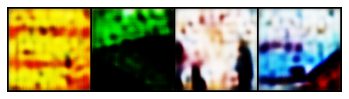

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


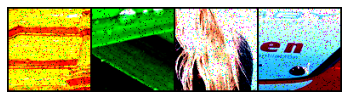

Epoch: 15
Generator Loss: 0.3752600336074829
Discriminator Loss: 0.00041205965739209204
D(x): 0.9998281002044678
D(G(z)): 0.00016415312711615115
PSNR for validation sample 14: 55.247376944089766
SSIM for validation sample 14: 0.5974841845460546


100%|██████████| 50/50 [02:04<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


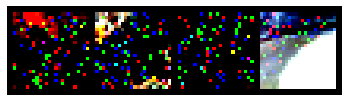

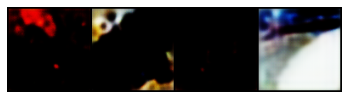

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


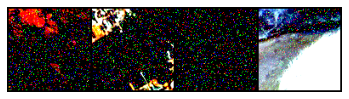

Epoch: 16
Generator Loss: 0.383328383564949
Discriminator Loss: 0.00040856534949853087
D(x): 0.9999098777770996
D(G(z)): 0.00013651384506374598
PSNR for validation sample 15: 52.01262624140769
SSIM for validation sample 15: 0.5334290275274537


100%|██████████| 50/50 [02:06<00:00,  2.53s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


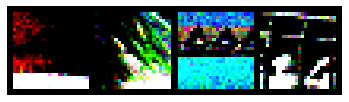

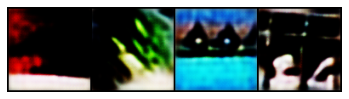

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


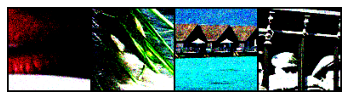

Epoch: 17
Generator Loss: 0.3761000734567642
Discriminator Loss: 0.00029774775306577793
D(x): 0.9997097253799438
D(G(z)): 0.0001688063348410651
PSNR for validation sample 16: 54.85602058929783
SSIM for validation sample 16: 0.6147257198008285


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


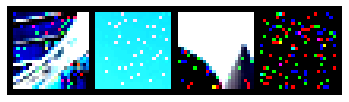

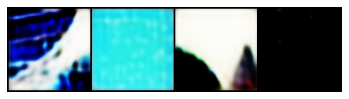

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


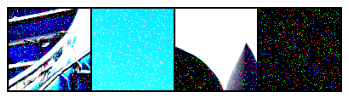

Epoch: 18
Generator Loss: 0.36692363023757935
Discriminator Loss: 0.0003600167758122552
D(x): 0.9998339414596558
D(G(z)): 4.084542888449505e-05
PSNR for validation sample 17: 53.08490112971643
SSIM for validation sample 17: 0.5971680256636103


100%|██████████| 50/50 [02:06<00:00,  2.53s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


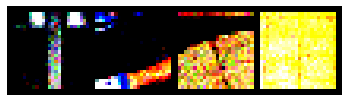

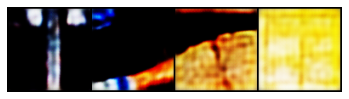

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


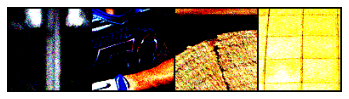

Epoch: 19
Generator Loss: 0.3671096795797348
Discriminator Loss: 0.00034464950040273833
D(x): 0.9998021721839905
D(G(z)): 0.00016575840709265321
PSNR for validation sample 18: 50.34487390769915
SSIM for validation sample 18: 0.5076661317122494


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


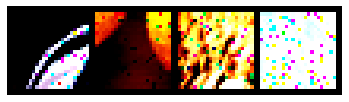

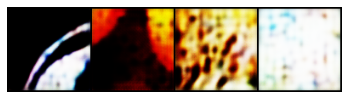

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


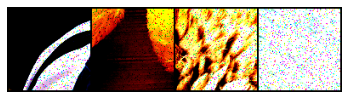

Epoch: 20
Generator Loss: 0.37045730501413343
Discriminator Loss: 0.00026363098688307217
D(x): 0.999971330165863
D(G(z)): 3.564239523257129e-05
PSNR for validation sample 19: 56.28953433243217
SSIM for validation sample 19: 0.6144013961957688


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


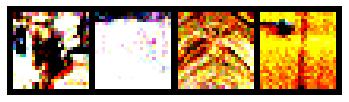

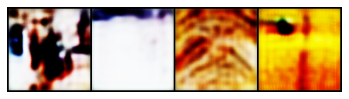

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


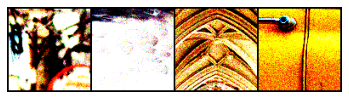

Epoch: 21
Generator Loss: 0.378498974442482
Discriminator Loss: 0.0001677876609028317
D(x): 0.9999792575836182
D(G(z)): 2.5652027034084313e-05
PSNR for validation sample 20: 44.85612889195579
SSIM for validation sample 20: 0.5000810756073614


100%|██████████| 50/50 [02:06<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


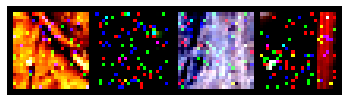

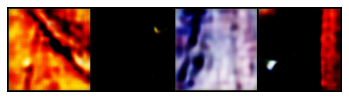

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


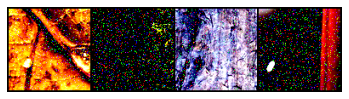

Epoch: 22
Generator Loss: 0.37201658606529237
Discriminator Loss: 0.00019138263935019494
D(x): 0.9999368786811829
D(G(z)): 0.00013131587184034288
PSNR for validation sample 21: 57.95675894404587
SSIM for validation sample 21: 0.5903665493804943


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


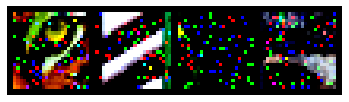

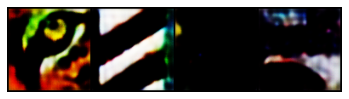

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


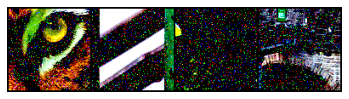

Epoch: 23
Generator Loss: 0.37696135103702544
Discriminator Loss: 0.0001691378592659021
D(x): 0.9996442794799805
D(G(z)): 0.00015161909686867148
PSNR for validation sample 22: 55.49556435685464
SSIM for validation sample 22: 0.6274484600402647


100%|██████████| 50/50 [02:07<00:00,  2.54s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


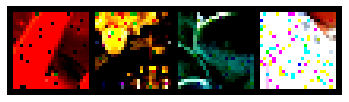

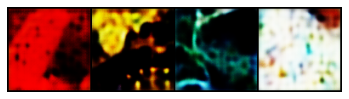

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


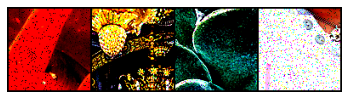

Epoch: 24
Generator Loss: 0.371203655898571
Discriminator Loss: 0.0003079308083397336
D(x): 0.999923586845398
D(G(z)): 4.500075010582805e-05
PSNR for validation sample 23: 48.23454869703633
SSIM for validation sample 23: 0.5034812569835114


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


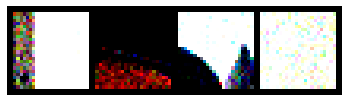

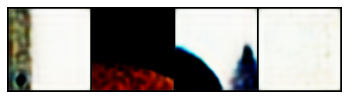

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


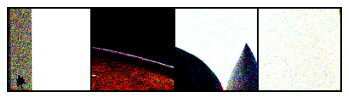

Epoch: 25
Generator Loss: 0.3661449611186981
Discriminator Loss: 0.00021134877133590634
D(x): 0.9999665021896362
D(G(z)): 1.0191506589762866e-05
PSNR for validation sample 24: 48.27923097631819
SSIM for validation sample 24: 0.5298425067047179


100%|██████████| 50/50 [02:06<00:00,  2.53s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


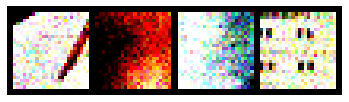

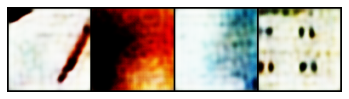

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


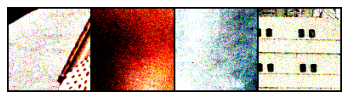

Epoch: 26
Generator Loss: 0.36725451678037646
Discriminator Loss: 0.00013656078528583748
D(x): 0.9999628067016602
D(G(z)): 3.826733154710382e-05
PSNR for validation sample 25: 51.59094087742928
SSIM for validation sample 25: 0.5559830061776743


100%|██████████| 50/50 [02:04<00:00,  2.49s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


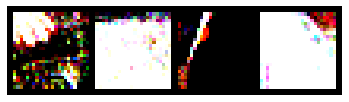

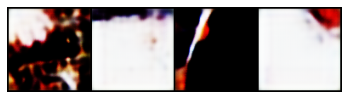

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


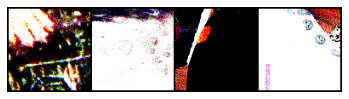

Epoch: 27
Generator Loss: 0.3744986054301262
Discriminator Loss: 0.000145922394876834
D(x): 0.999927282333374
D(G(z)): 2.395611591055058e-05
PSNR for validation sample 26: 53.410449440514434
SSIM for validation sample 26: 0.5040875493954704


100%|██████████| 50/50 [02:04<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


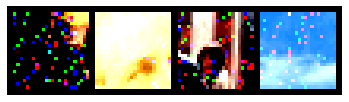

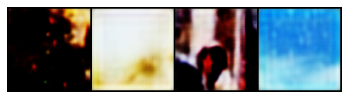

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


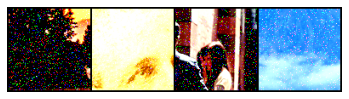

Epoch: 28
Generator Loss: 0.3702976831793785
Discriminator Loss: 9.447342647035839e-05
D(x): 0.9999804496765137
D(G(z)): 1.3960214346298017e-05
PSNR for validation sample 27: 47.08777177143964
SSIM for validation sample 27: 0.502407186999086


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


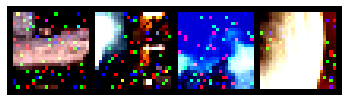

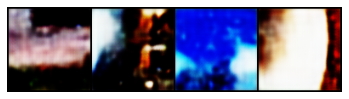

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


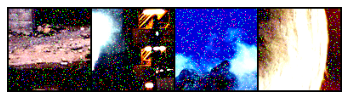

Epoch: 29
Generator Loss: 0.36421007812023165
Discriminator Loss: 8.093979053228395e-05
D(x): 0.9999802112579346
D(G(z)): 1.0319157809135504e-05
PSNR for validation sample 28: 50.87361062695844
SSIM for validation sample 28: 0.5138296066524174


100%|██████████| 50/50 [02:06<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


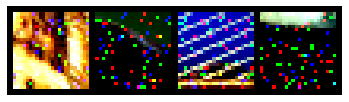

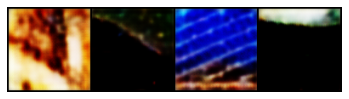

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


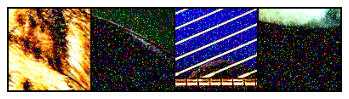

Epoch: 30
Generator Loss: 0.3676052767038345
Discriminator Loss: 7.859417208237573e-05
D(x): 0.999984622001648
D(G(z)): 1.3283641237649135e-05
PSNR for validation sample 29: 52.61500736035895
SSIM for validation sample 29: 0.5616105991293332


100%|██████████| 50/50 [02:04<00:00,  2.49s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


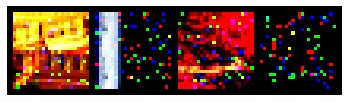

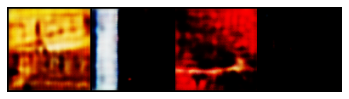

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


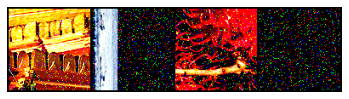

Epoch: 31
Generator Loss: 0.37992400616407396
Discriminator Loss: 6.492181066278135e-05
D(x): 0.9999876022338867
D(G(z)): 1.2880876965937205e-05
PSNR for validation sample 30: 52.45501100868161
SSIM for validation sample 30: 0.6501312088367586


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


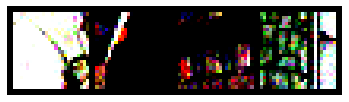

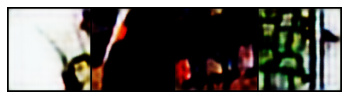

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


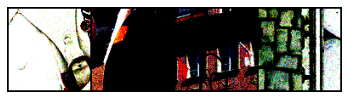

Epoch: 32
Generator Loss: 0.3730643767118454
Discriminator Loss: 6.229101545613957e-05
D(x): 0.9999736547470093
D(G(z)): 1.7821625078795478e-05
PSNR for validation sample 31: 50.2375255576025
SSIM for validation sample 31: 0.5393884685945581


100%|██████████| 50/50 [02:03<00:00,  2.47s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


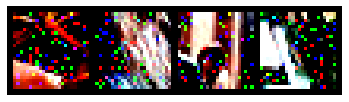

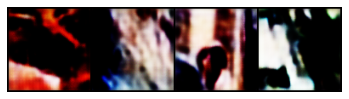

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


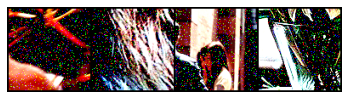

Epoch: 33
Generator Loss: 0.36908460229635237
Discriminator Loss: 6.0870158886245915e-05
D(x): 0.999936580657959
D(G(z)): 0.0001075003674486652
PSNR for validation sample 32: 51.40060840335892
SSIM for validation sample 32: 0.7686484177922579


100%|██████████| 50/50 [02:03<00:00,  2.48s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


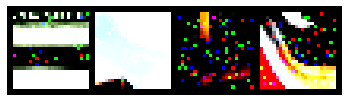

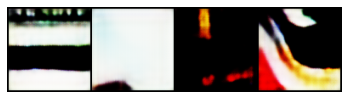

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


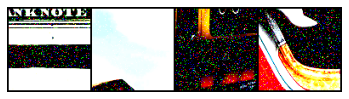

Epoch: 34
Generator Loss: 0.3708828994631767
Discriminator Loss: 8.155866144988977e-05
D(x): 0.999893844127655
D(G(z)): 2.0127154130022973e-05
PSNR for validation sample 33: 49.65302447835461
SSIM for validation sample 33: 0.5014077784077616


100%|██████████| 50/50 [02:04<00:00,  2.49s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


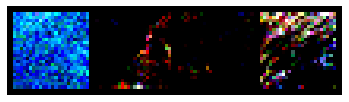

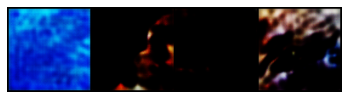

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


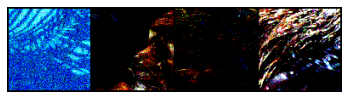

Epoch: 35
Generator Loss: 0.37815163254737855
Discriminator Loss: 6.055955640476895e-05
D(x): 0.999983549118042
D(G(z)): 9.169829354505055e-06
PSNR for validation sample 34: 53.00391452873679
SSIM for validation sample 34: 0.5148152353083202


100%|██████████| 50/50 [02:04<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


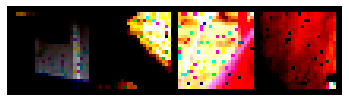

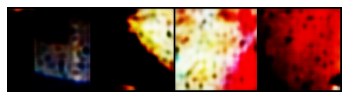

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


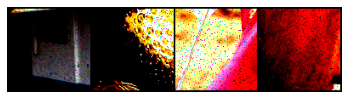

Epoch: 36
Generator Loss: 0.3665594303607941
Discriminator Loss: 5.4202362116484436e-05
D(x): 0.9999793171882629
D(G(z)): 2.463367309246678e-05
PSNR for validation sample 35: 51.25737222716151
SSIM for validation sample 35: 0.5589848138548204


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


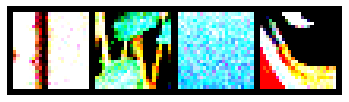

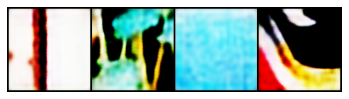

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


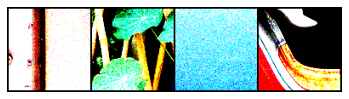

Epoch: 37
Generator Loss: 0.3691373100876808
Discriminator Loss: 5.187098529859213e-05
D(x): 0.9999667406082153
D(G(z)): 2.3884345864644274e-05
PSNR for validation sample 36: 51.61261053411139
SSIM for validation sample 36: 0.6050491562638878


100%|██████████| 50/50 [02:06<00:00,  2.53s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


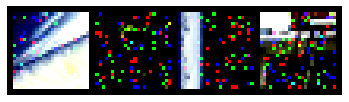

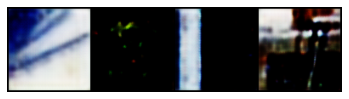

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


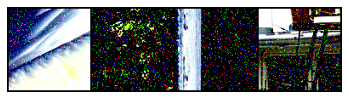

Epoch: 38
Generator Loss: 0.37900775581598284
Discriminator Loss: 4.824779771297472e-05
D(x): 0.9999821782112122
D(G(z)): 1.8449929484631866e-05
PSNR for validation sample 37: 54.77313975368247
SSIM for validation sample 37: 0.6702958668360838


100%|██████████| 50/50 [02:07<00:00,  2.54s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


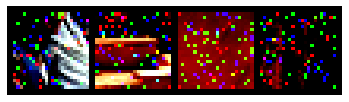

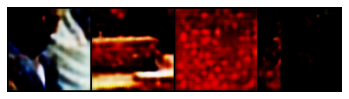

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


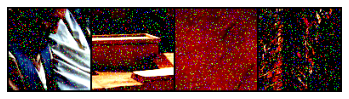

Epoch: 39
Generator Loss: 0.3713845875859261
Discriminator Loss: 3.726018596353242e-05
D(x): 0.9999898672103882
D(G(z)): 1.181312654807698e-05
PSNR for validation sample 38: 50.919788573629
SSIM for validation sample 38: 0.5024299822685646


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


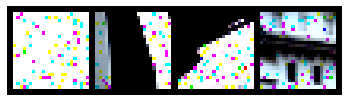

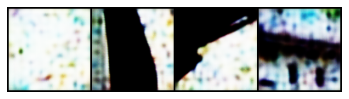

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


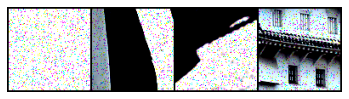

Epoch: 40
Generator Loss: 0.3693163514137268
Discriminator Loss: 4.072829393408028e-05
D(x): 0.9999693632125854
D(G(z)): 2.2389329387806356e-05
PSNR for validation sample 39: 48.38530629068069
SSIM for validation sample 39: 0.5003074592304078


100%|██████████| 50/50 [02:07<00:00,  2.54s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


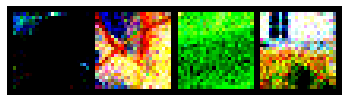

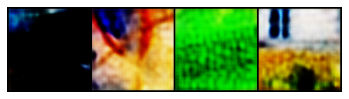

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


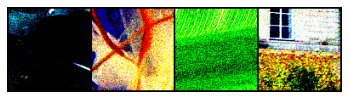

Epoch: 41
Generator Loss: 0.37950529158115387
Discriminator Loss: 4.2854847670241725e-05
D(x): 0.9999606013298035
D(G(z)): 6.595172635570634e-06
PSNR for validation sample 40: 49.19017587800806
SSIM for validation sample 40: 0.5231999330125163


100%|██████████| 50/50 [02:06<00:00,  2.53s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


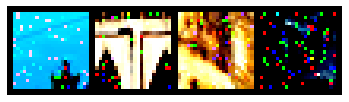

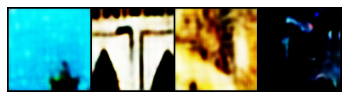

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


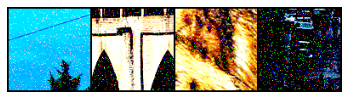

Epoch: 42
Generator Loss: 0.3679353392124176
Discriminator Loss: 3.318322367704241e-05
D(x): 0.9999749660491943
D(G(z)): 2.8694110369542614e-05
PSNR for validation sample 41: 57.23423139779233
SSIM for validation sample 41: 0.7876303661186352


100%|██████████| 50/50 [02:06<00:00,  2.53s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


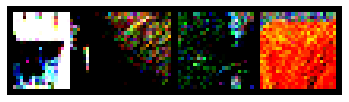

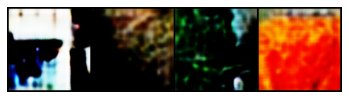

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


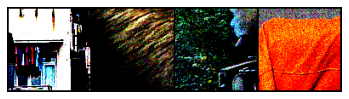

Epoch: 43
Generator Loss: 0.37514695912599566
Discriminator Loss: 5.444040728434629e-05
D(x): 0.9999849796295166
D(G(z)): 9.844372470979579e-06
PSNR for validation sample 42: 50.348738809442175
SSIM for validation sample 42: 0.54668444695908


100%|██████████| 50/50 [02:06<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


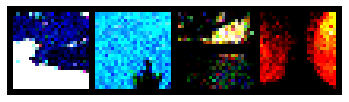

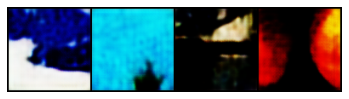

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


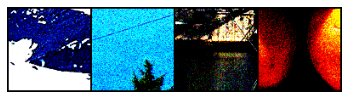

Epoch: 44
Generator Loss: 0.3738911023736
Discriminator Loss: 3.5195349155401346e-05
D(x): 0.9999828338623047
D(G(z)): 1.3785075680061709e-05
PSNR for validation sample 43: 51.67698559918107
SSIM for validation sample 43: 0.9169765567509882


100%|██████████| 50/50 [02:06<00:00,  2.54s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


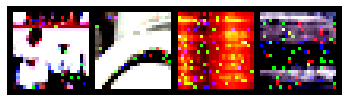

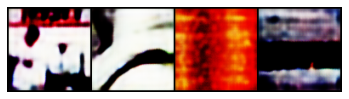

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


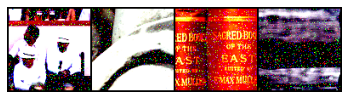

Epoch: 45
Generator Loss: 0.3698068231344223
Discriminator Loss: 3.702842504026194e-05
D(x): 0.9999862909317017
D(G(z)): 9.223128472513054e-06
PSNR for validation sample 44: 48.82724732228024
SSIM for validation sample 44: 0.8009810756088489


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


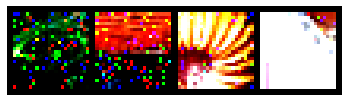

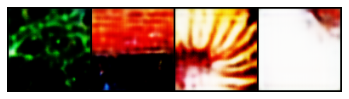

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


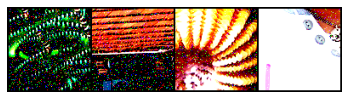

Epoch: 46
Generator Loss: 0.3745943620800972
Discriminator Loss: 2.5807156334849423e-05
D(x): 0.9999956488609314
D(G(z)): 2.6882564725383418e-06
PSNR for validation sample 45: 51.35558335637971
SSIM for validation sample 45: 0.5909874284677096


100%|██████████| 50/50 [02:07<00:00,  2.54s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


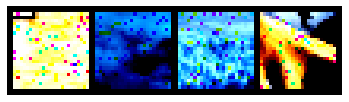

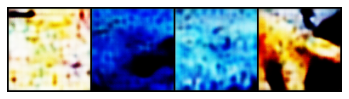

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


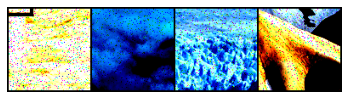

Epoch: 47
Generator Loss: 0.36841916650533674
Discriminator Loss: 2.4686140241101383e-05
D(x): 0.9999763369560242
D(G(z)): 9.793947356229182e-06
PSNR for validation sample 46: 47.96704041754442
SSIM for validation sample 46: 0.534564400792372


100%|██████████| 50/50 [02:03<00:00,  2.47s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


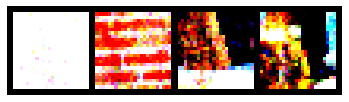

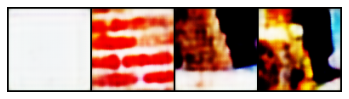

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


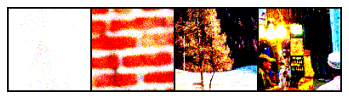

Epoch: 48
Generator Loss: 0.36865726113319397
Discriminator Loss: 2.5786133055589743e-05
D(x): 0.9999810457229614
D(G(z)): 1.8872109649237245e-05
PSNR for validation sample 47: 51.753703655805204
SSIM for validation sample 47: 0.505364709379694


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


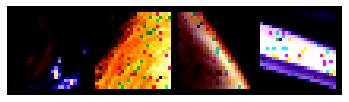

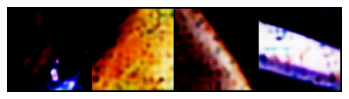

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


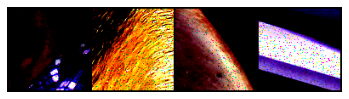

Epoch: 49
Generator Loss: 0.36628165423870085
Discriminator Loss: 2.698605951081845e-05
D(x): 0.9999880790710449
D(G(z)): 7.43743885323056e-06
PSNR for validation sample 48: 47.45317568092734
SSIM for validation sample 48: 0.5000605921815424


100%|██████████| 50/50 [02:04<00:00,  2.48s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


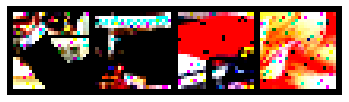

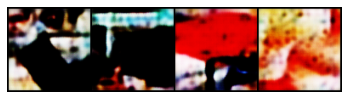

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


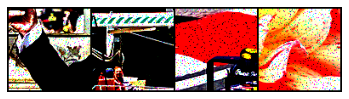

Epoch: 50
Generator Loss: 0.37451042115688327
Discriminator Loss: 2.1718163234254463e-05
D(x): 0.9999923706054688
D(G(z)): 3.857096999126952e-06
PSNR for validation sample 49: 49.721753106792434
SSIM for validation sample 49: 0.5540285858702704


100%|██████████| 50/50 [02:04<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


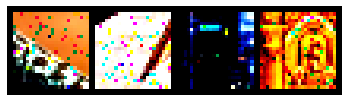

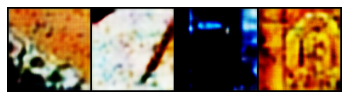

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


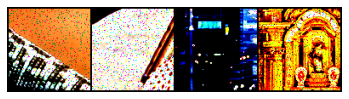

Epoch: 51
Generator Loss: 0.37697906374931334
Discriminator Loss: 2.531348839511338e-05
D(x): 0.9999951720237732
D(G(z)): 5.969462108623702e-06
PSNR for validation sample 50: 48.46612470447753
SSIM for validation sample 50: 0.57152536026251


100%|██████████| 50/50 [02:03<00:00,  2.47s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


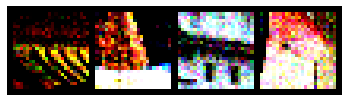

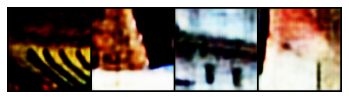

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


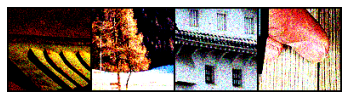

Epoch: 52
Generator Loss: 0.3704165914654732
Discriminator Loss: 2.504975344891136e-05
D(x): 0.9999934434890747
D(G(z)): 3.3206597436219454e-06
PSNR for validation sample 51: 47.436556543975684
SSIM for validation sample 51: 0.5028488356109027


100%|██████████| 50/50 [02:04<00:00,  2.49s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


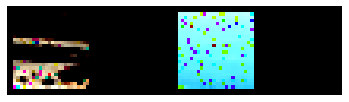

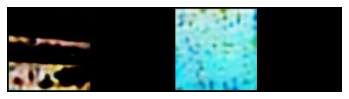

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


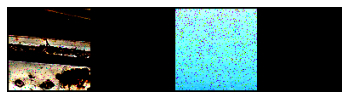

Epoch: 53
Generator Loss: 0.37231838881969453
Discriminator Loss: 2.2373363403858093e-05
D(x): 0.9999967217445374
D(G(z)): 1.6083969285318744e-06
PSNR for validation sample 52: 50.002998650088884
SSIM for validation sample 52: 0.5176795961010113


100%|██████████| 50/50 [02:03<00:00,  2.48s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


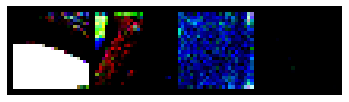

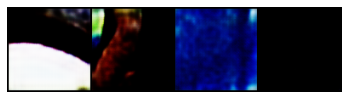

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


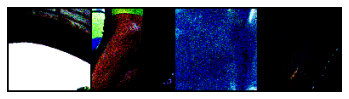

Epoch: 54
Generator Loss: 0.36943289905786514
Discriminator Loss: 2.5581572926967056e-05
D(x): 0.9999874830245972
D(G(z)): 6.296018455032026e-06
PSNR for validation sample 53: 52.66440809359536
SSIM for validation sample 53: 0.5647536025005462


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


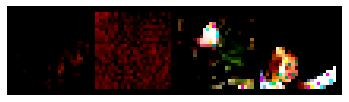

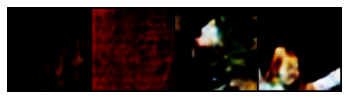

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


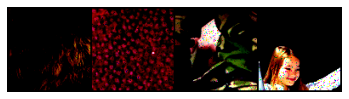

Epoch: 55
Generator Loss: 0.3707162016630173
Discriminator Loss: 1.9393312659303774e-05
D(x): 0.9999850392341614
D(G(z)): 1.3899784789828118e-05
PSNR for validation sample 54: 61.36817321626479
SSIM for validation sample 54: 0.6768638788463368


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


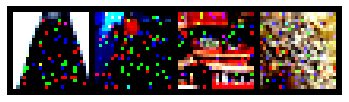

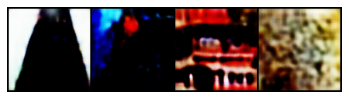

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


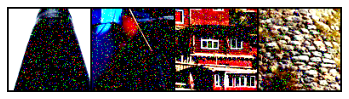

Epoch: 56
Generator Loss: 0.37166093349456786
Discriminator Loss: 2.3630040714124335e-05
D(x): 0.9999927878379822
D(G(z)): 7.414560514007462e-06
PSNR for validation sample 55: 49.76564930517685
SSIM for validation sample 55: 0.5039650789359853


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


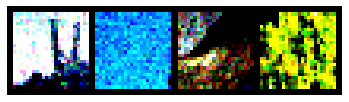

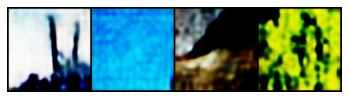

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


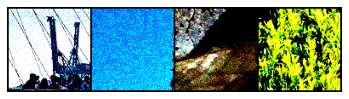

Epoch: 57
Generator Loss: 0.379901502430439
Discriminator Loss: 1.610036510101054e-05
D(x): 0.9999918937683105
D(G(z)): 1.2488552783906925e-05
PSNR for validation sample 56: 55.379873909104454
SSIM for validation sample 56: 0.7916370063408948


100%|██████████| 50/50 [02:04<00:00,  2.48s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


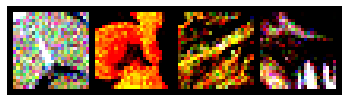

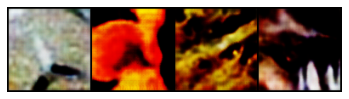

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


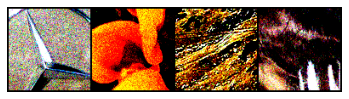

Epoch: 58
Generator Loss: 0.37182236671447755
Discriminator Loss: 1.5749651083751814e-05
D(x): 0.9999948143959045
D(G(z)): 9.402869181940332e-06
PSNR for validation sample 57: 56.0653328113811
SSIM for validation sample 57: 0.5983180994998982


100%|██████████| 50/50 [02:04<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


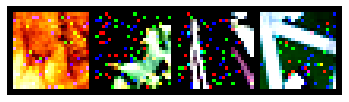

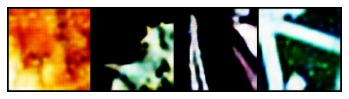

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


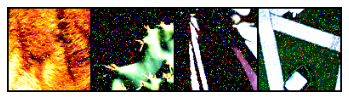

Epoch: 59
Generator Loss: 0.36581855058670043
Discriminator Loss: 1.76609431309771e-05
D(x): 0.9999911785125732
D(G(z)): 2.0341251001809724e-05
PSNR for validation sample 58: 48.33460333873668
SSIM for validation sample 58: 0.5005487322779207


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


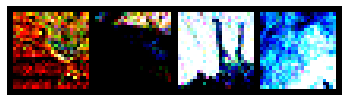

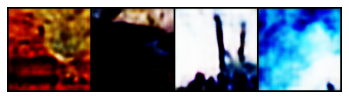

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


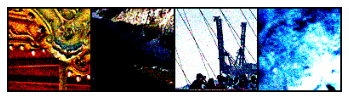

Epoch: 60
Generator Loss: 0.36980739891529085
Discriminator Loss: 1.701700235116732e-05
D(x): 0.9999964833259583
D(G(z)): 2.247187694592867e-06
PSNR for validation sample 59: 50.4399183098749
SSIM for validation sample 59: 0.5551548700567359


100%|██████████| 50/50 [02:06<00:00,  2.53s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


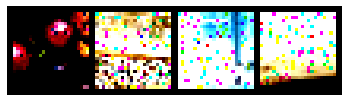

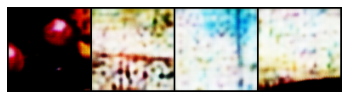

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


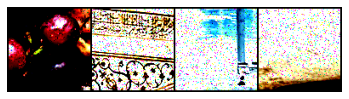

Epoch: 61
Generator Loss: 0.3652018278837204
Discriminator Loss: 1.9531056268533574e-05
D(x): 0.9999986886978149
D(G(z)): 8.269129807558784e-07
PSNR for validation sample 60: 50.88827362714462
SSIM for validation sample 60: 0.5361082322709761


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


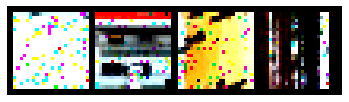

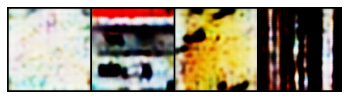

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


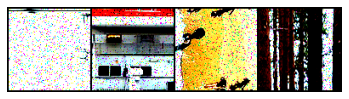

Epoch: 62
Generator Loss: 0.37863950073719027
Discriminator Loss: 1.8069436223413504e-05
D(x): 0.9999908804893494
D(G(z)): 3.1295016924559604e-06
PSNR for validation sample 61: 59.24119045786484
SSIM for validation sample 61: 0.5589387030152074


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


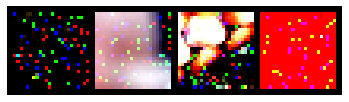

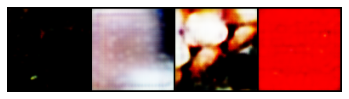

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


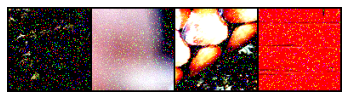

Epoch: 63
Generator Loss: 0.3791121220588684
Discriminator Loss: 1.3653123078256613e-05
D(x): 0.9999932646751404
D(G(z)): 6.241064056666801e-06
PSNR for validation sample 62: 56.562485432618026
SSIM for validation sample 62: 0.5937363660488778


100%|██████████| 50/50 [02:04<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


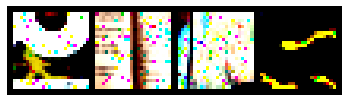

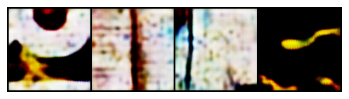

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


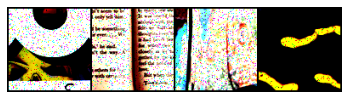

Epoch: 64
Generator Loss: 0.372520337998867
Discriminator Loss: 1.5075486485329748e-05
D(x): 0.9999934434890747
D(G(z)): 7.131184247555211e-06
PSNR for validation sample 63: 54.51079748687829
SSIM for validation sample 63: 0.5451574792305399


100%|██████████| 50/50 [02:06<00:00,  2.53s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


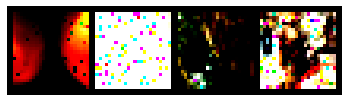

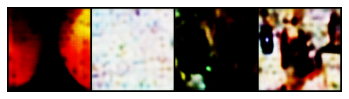

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


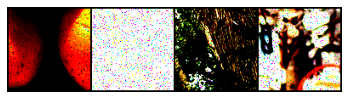

Epoch: 65
Generator Loss: 0.3656156474351883
Discriminator Loss: 1.1275944580120267e-05
D(x): 0.9999948143959045
D(G(z)): 1.7734961375026614e-06
PSNR for validation sample 64: 58.58554415621042
SSIM for validation sample 64: 0.6154396552750324


100%|██████████| 50/50 [02:04<00:00,  2.49s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


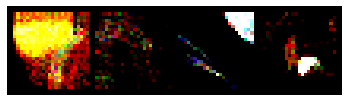

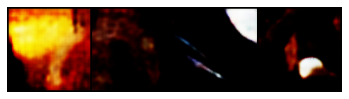

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


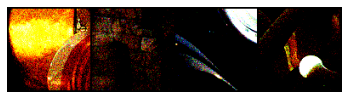

Epoch: 66
Generator Loss: 0.3604656863212585
Discriminator Loss: 1.1745123829314253e-05
D(x): 0.9999650120735168
D(G(z)): 5.100932412460679e-06
PSNR for validation sample 65: 70.19961987489722
SSIM for validation sample 65: 0.7910235354252682


100%|██████████| 50/50 [02:06<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


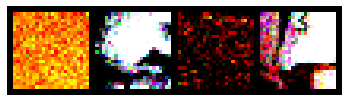

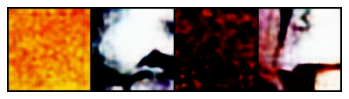

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


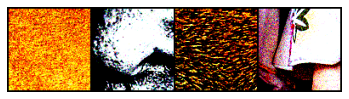

Epoch: 67
Generator Loss: 0.3726997724175453
Discriminator Loss: 1.2471487275433902e-05
D(x): 0.9999978542327881
D(G(z)): 1.5865883824517368e-06
PSNR for validation sample 66: 51.96208622875712
SSIM for validation sample 66: 0.5962727019369385


100%|██████████| 50/50 [02:04<00:00,  2.49s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


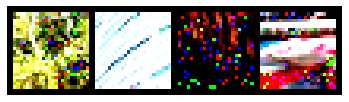

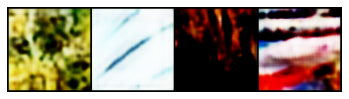

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


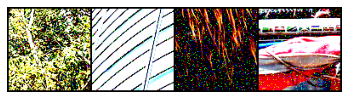

Epoch: 68
Generator Loss: 0.36883430659770966
Discriminator Loss: 1.5641765396594566e-05
D(x): 0.9999834895133972
D(G(z)): 8.57332724990556e-06
PSNR for validation sample 67: 51.067094368477456
SSIM for validation sample 67: 0.5814877287029898


100%|██████████| 50/50 [02:06<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


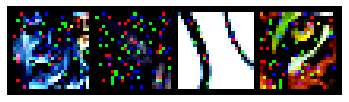

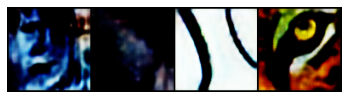

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


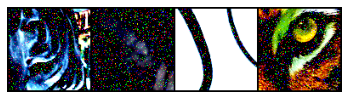

Epoch: 69
Generator Loss: 0.3662313508987427
Discriminator Loss: 1.1440766120358604e-05
D(x): 0.9999943375587463
D(G(z)): 2.5025897230079863e-06
PSNR for validation sample 68: 49.529285548159734
SSIM for validation sample 68: 0.6388933606435925


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


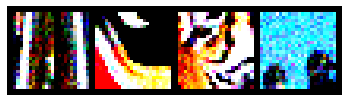

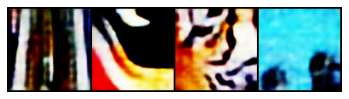

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


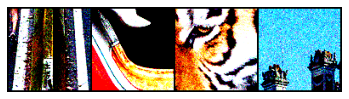

Epoch: 70
Generator Loss: 0.37510217875242235
Discriminator Loss: 1.120712439842464e-05
D(x): 0.9999908208847046
D(G(z)): 1.7087522792280652e-06
PSNR for validation sample 69: 52.65442114962444
SSIM for validation sample 69: 0.5326029143961115


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


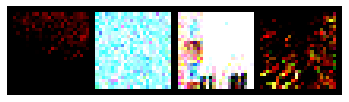

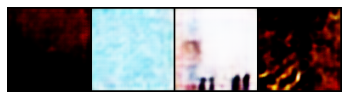

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


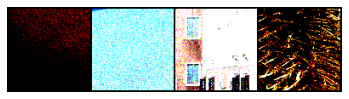

Epoch: 71
Generator Loss: 0.3684110367298126
Discriminator Loss: 1.1013314133379026e-05
D(x): 0.9999984502792358
D(G(z)): 6.822630780334293e-07
PSNR for validation sample 70: 57.25326992466731
SSIM for validation sample 70: 0.6199205268968666


100%|██████████| 50/50 [02:04<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


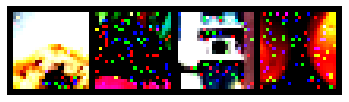

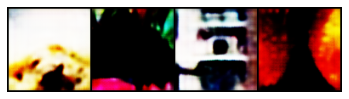

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


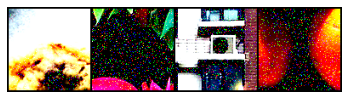

Epoch: 72
Generator Loss: 0.37401004135608673
Discriminator Loss: 1.0166742326873645e-05
D(x): 0.9999967813491821
D(G(z)): 1.3367171050049365e-06
PSNR for validation sample 71: 54.23584368771217
SSIM for validation sample 71: 0.5813849324361233


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


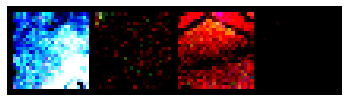

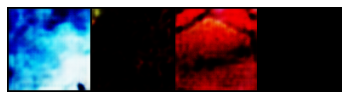

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


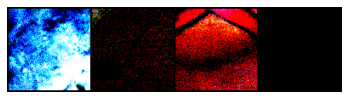

Epoch: 73
Generator Loss: 0.3755139535665512
Discriminator Loss: 9.022183028264409e-06
D(x): 0.9999973773956299
D(G(z)): 1.1532596317920252e-06
PSNR for validation sample 72: 50.82087409322249
SSIM for validation sample 72: 0.5012615766232769


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


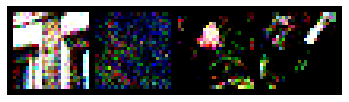

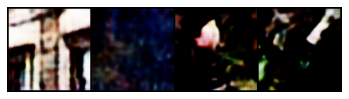

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


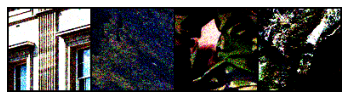

Epoch: 74
Generator Loss: 0.3689755034446716
Discriminator Loss: 1.024636068223117e-05
D(x): 0.9999947547912598
D(G(z)): 3.4103304642485455e-06
PSNR for validation sample 73: 48.995789136356784
SSIM for validation sample 73: 0.84680762215945


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


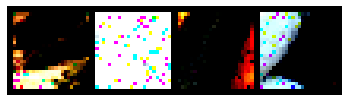

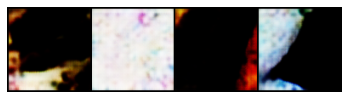

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


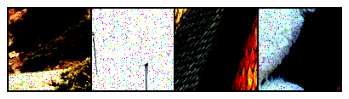

Epoch: 75
Generator Loss: 0.36915352046489713
Discriminator Loss: 1.0286717599683471e-05
D(x): 0.9999713897705078
D(G(z)): 2.5688377718324773e-06
PSNR for validation sample 74: 50.33615162272184
SSIM for validation sample 74: 0.5874594593991166


100%|██████████| 50/50 [02:04<00:00,  2.49s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


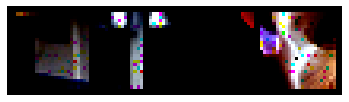

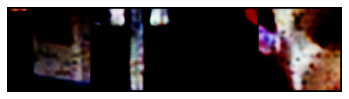

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


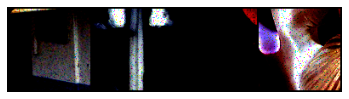

Epoch: 76
Generator Loss: 0.37460683584213256
Discriminator Loss: 1.0213951613877725e-05
D(x): 0.9999938011169434
D(G(z)): 5.71992222830886e-06
PSNR for validation sample 75: 46.48748270178996
SSIM for validation sample 75: 0.5001506199720338


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


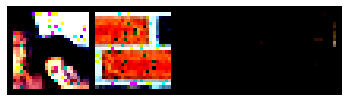

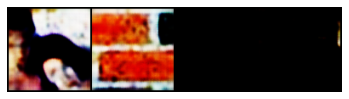

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


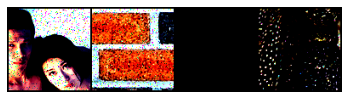

Epoch: 77
Generator Loss: 0.3750465750694275
Discriminator Loss: 1.147810946804384e-05
D(x): 0.9999967813491821
D(G(z)): 2.2312487999442965e-06
PSNR for validation sample 76: 48.06413916803427
SSIM for validation sample 76: 0.5033668677495899


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


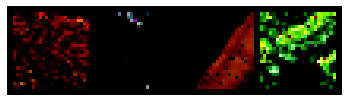

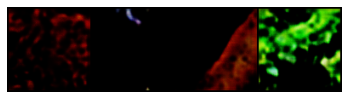

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


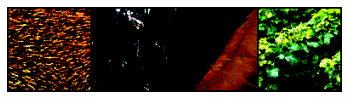

Epoch: 78
Generator Loss: 0.3733295756578445
Discriminator Loss: 8.288900348816241e-06
D(x): 0.9999938607215881
D(G(z)): 1.395449089613976e-06
PSNR for validation sample 77: 48.76237827712275
SSIM for validation sample 77: 0.5269884769365422


100%|██████████| 50/50 [02:05<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


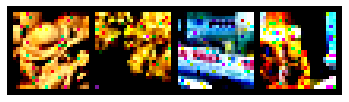

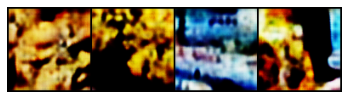

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


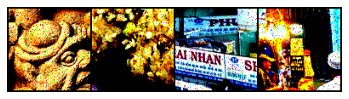

Epoch: 79
Generator Loss: 0.37445983558893203
Discriminator Loss: 6.92587257390187e-06
D(x): 0.9999960660934448
D(G(z)): 3.3665282899164595e-06
PSNR for validation sample 78: 53.92819768042629
SSIM for validation sample 78: 0.6562398992563562


100%|██████████| 50/50 [02:04<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


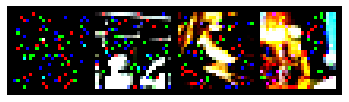

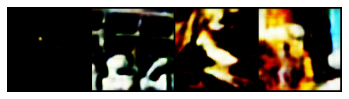

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


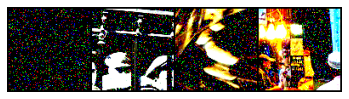

Epoch: 80
Generator Loss: 0.36980428874492643
Discriminator Loss: 7.3989400402751925e-06
D(x): 0.9999974370002747
D(G(z)): 2.0481888896028977e-06
PSNR for validation sample 79: 59.20446740873422
SSIM for validation sample 79: 0.6888202777104744


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


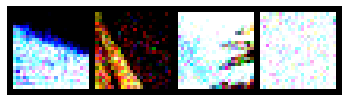

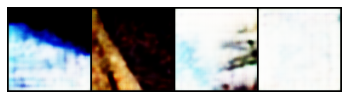

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


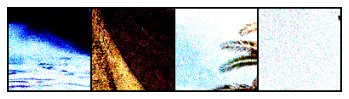

Epoch: 81
Generator Loss: 0.3691266268491745
Discriminator Loss: 6.58177216337208e-06
D(x): 0.9999985098838806
D(G(z)): 1.4396664482774213e-06
PSNR for validation sample 80: 53.903463804577086
SSIM for validation sample 80: 0.5616834904343107


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


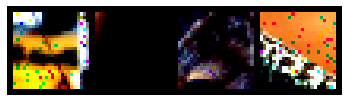

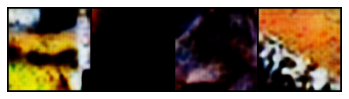

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


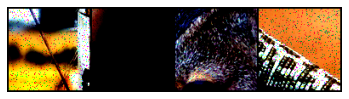

Epoch: 82
Generator Loss: 0.36960590809583665
Discriminator Loss: 6.061162594050984e-06
D(x): 0.9999974966049194
D(G(z)): 1.4100725138632697e-06
PSNR for validation sample 81: 51.17578932796598
SSIM for validation sample 81: 0.6520832602014328


100%|██████████| 50/50 [02:04<00:00,  2.49s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


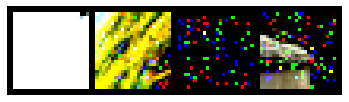

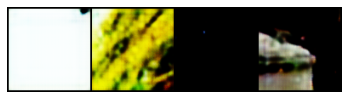

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


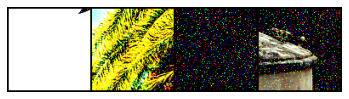

Epoch: 83
Generator Loss: 0.37070903182029724
Discriminator Loss: 8.52004000080342e-06
D(x): 0.9999991655349731
D(G(z)): 8.21122284833109e-07
PSNR for validation sample 82: 56.95608810504559
SSIM for validation sample 82: 0.5035799187021145


100%|██████████| 50/50 [02:06<00:00,  2.53s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


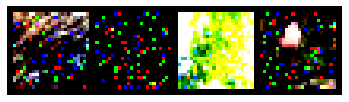

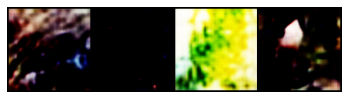

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


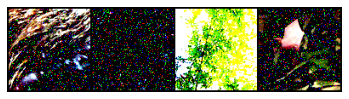

Epoch: 84
Generator Loss: 0.37231373488903047
Discriminator Loss: 5.976354245831317e-06
D(x): 0.9999963045120239
D(G(z)): 2.378001227043569e-06
PSNR for validation sample 83: 52.390181369714256
SSIM for validation sample 83: 0.5634536189758957


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


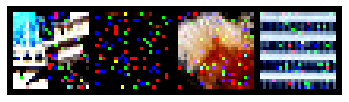

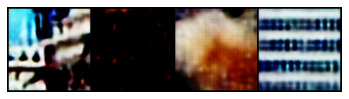

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


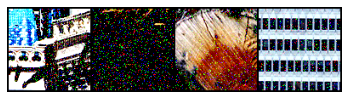

Epoch: 85
Generator Loss: 0.3667546746134758
Discriminator Loss: 6.112189309988026e-06
D(x): 0.9999987483024597
D(G(z)): 1.0675105386326322e-06
PSNR for validation sample 84: 51.9621812484548
SSIM for validation sample 84: 0.501774571632463


100%|██████████| 50/50 [02:06<00:00,  2.53s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


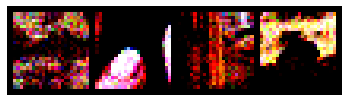

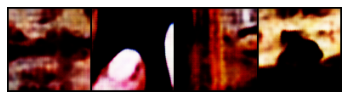

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


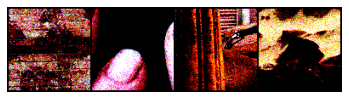

Epoch: 86
Generator Loss: 0.3692897906899452
Discriminator Loss: 5.0738226718749505e-06
D(x): 0.9999988079071045
D(G(z)): 8.27698045213765e-07
PSNR for validation sample 85: 55.832524550617606
SSIM for validation sample 85: 0.6393544246824396


100%|██████████| 50/50 [02:06<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


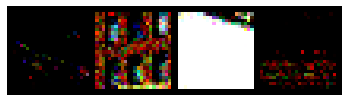

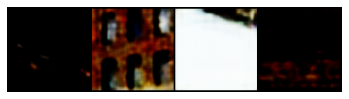

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


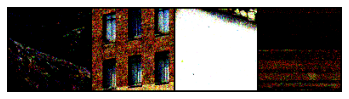

Epoch: 87
Generator Loss: 0.37278325855731964
Discriminator Loss: 6.398454478357962e-06
D(x): 0.9999953508377075
D(G(z)): 1.0502319582883501e-06
PSNR for validation sample 86: 50.11961857692246
SSIM for validation sample 86: 0.5508236809019043


100%|██████████| 50/50 [02:05<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


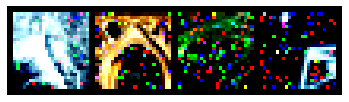

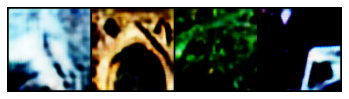

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


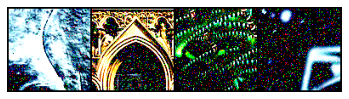

Epoch: 88
Generator Loss: 0.3736275473237038
Discriminator Loss: 5.424448143003247e-06
D(x): 0.9999797344207764
D(G(z)): 1.1020065358025022e-05
PSNR for validation sample 87: 54.22164579939877
SSIM for validation sample 87: 0.7055858020852444


100%|██████████| 50/50 [02:07<00:00,  2.54s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


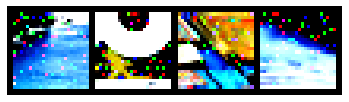

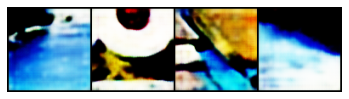

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


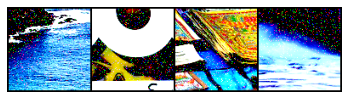

Epoch: 89
Generator Loss: 0.36648868829011916
Discriminator Loss: 5.087074466700869e-06
D(x): 0.9999881982803345
D(G(z)): 5.270971541904146e-06
PSNR for validation sample 88: 57.06689784798395
SSIM for validation sample 88: 0.6400216737582504


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


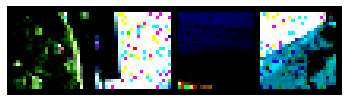

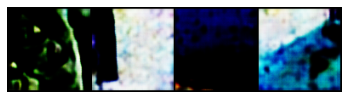

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


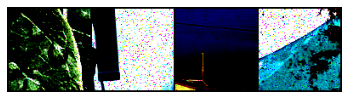

Epoch: 90
Generator Loss: 0.3758298569917679
Discriminator Loss: 4.938615969649618e-06
D(x): 0.9999984502792358
D(G(z)): 8.287260016004439e-07
PSNR for validation sample 89: 52.59381666548239
SSIM for validation sample 89: 0.5459342481101752


100%|██████████| 50/50 [02:05<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


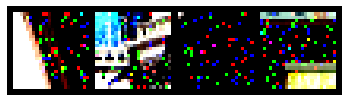

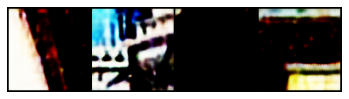

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


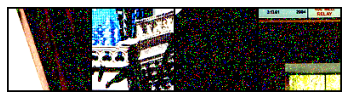

Epoch: 91
Generator Loss: 0.3669606781005859
Discriminator Loss: 5.573956384523626e-06
D(x): 0.9999989867210388
D(G(z)): 1.0397138794360217e-06
PSNR for validation sample 90: 52.788101341288005
SSIM for validation sample 90: 0.6093749657287021


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


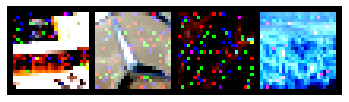

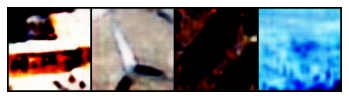

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


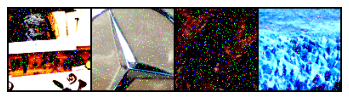

Epoch: 92
Generator Loss: 0.3735697114467621
Discriminator Loss: 4.0766134043224155e-06
D(x): 0.9999991655349731
D(G(z)): 4.421350752181752e-07
PSNR for validation sample 91: 53.19197699315505
SSIM for validation sample 91: 0.527878935941354


100%|██████████| 50/50 [02:06<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


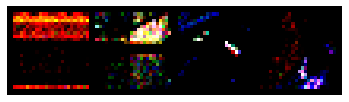

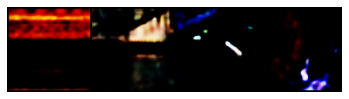

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


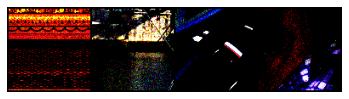

Epoch: 93
Generator Loss: 0.3611945915222168
Discriminator Loss: 4.095790319524894e-06
D(x): 0.9999978542327881
D(G(z)): 8.294831786770374e-06
PSNR for validation sample 92: 46.55862917915731
SSIM for validation sample 92: 0.5000829941233411


100%|██████████| 50/50 [02:05<00:00,  2.51s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


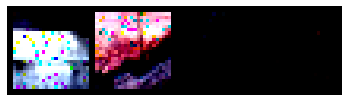

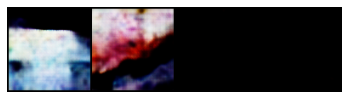

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


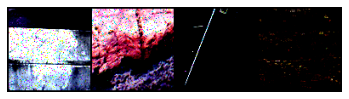

Epoch: 94
Generator Loss: 0.3608011135458946
Discriminator Loss: 4.572532130850959e-06
D(x): 0.9999983906745911
D(G(z)): 1.0325563835067442e-06
PSNR for validation sample 93: 50.619133424910565
SSIM for validation sample 93: 0.5167220147952652


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


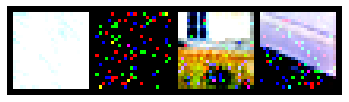

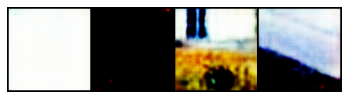

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


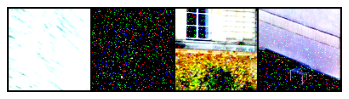

Epoch: 95
Generator Loss: 0.37360074758529666
Discriminator Loss: 3.6114096201345093e-06
D(x): 0.9999993443489075
D(G(z)): 3.3087309248003294e-07
PSNR for validation sample 94: 52.54413774279571
SSIM for validation sample 94: 0.5221539797461767


100%|██████████| 50/50 [02:05<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


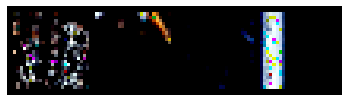

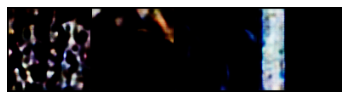

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


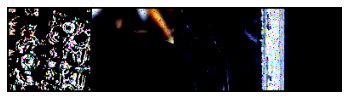

Epoch: 96
Generator Loss: 0.36573978066444396
Discriminator Loss: 4.358175107199713e-06
D(x): 0.9999970197677612
D(G(z)): 2.5437786916882033e-06
PSNR for validation sample 95: 48.938834656693466
SSIM for validation sample 95: 0.5064249357778631


100%|██████████| 50/50 [02:05<00:00,  2.50s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


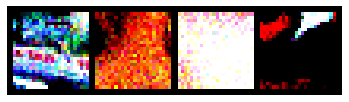

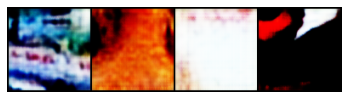

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


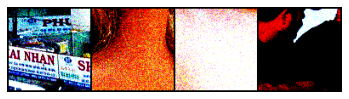

Epoch: 97
Generator Loss: 0.36834646612405775
Discriminator Loss: 3.6975008572426303e-06
D(x): 0.999998927116394
D(G(z)): 1.9300819076306652e-06
PSNR for validation sample 96: 48.24463570806303
SSIM for validation sample 96: 0.5247333948479251


100%|██████████| 50/50 [02:06<00:00,  2.53s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


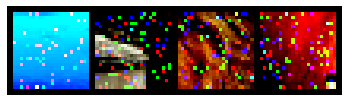

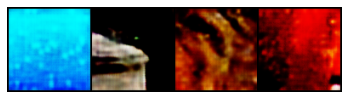

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


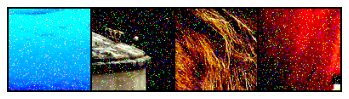

Epoch: 98
Generator Loss: 0.3639846357703209
Discriminator Loss: 5.7995812267108705e-06
D(x): 0.9999959468841553
D(G(z)): 7.004946382949129e-06
PSNR for validation sample 97: 50.90974000963435
SSIM for validation sample 97: 0.5660056751801048


100%|██████████| 50/50 [02:05<00:00,  2.52s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


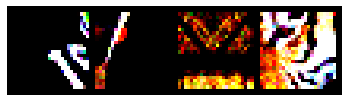

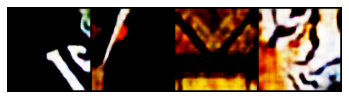

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


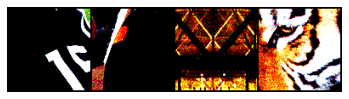

Epoch: 99
Generator Loss: 0.3667423981428146
Discriminator Loss: 4.584549088804124e-06
D(x): 0.9999977946281433
D(G(z)): 2.7640030566544738e-06
PSNR for validation sample 98: 49.15626644382493
SSIM for validation sample 98: 0.5145604107825762


100%|██████████| 50/50 [02:07<00:00,  2.55s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


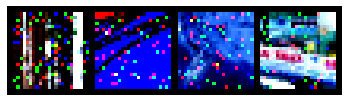

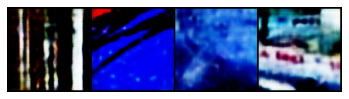

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


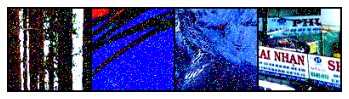

Epoch: 100
Generator Loss: 0.37162298798561094
Discriminator Loss: 3.659314639889999e-06
D(x): 0.9999979734420776
D(G(z)): 7.088501661201008e-07
PSNR for validation sample 99: 52.54387180717124
SSIM for validation sample 99: 0.6173574364288996
=> Saving checkpoint
=> Saving checkpoint
CPU times: user 21min 18s, sys: 42.4 s, total: 22min 1s
Wall time: 3h 30min 28s


In [ ]:
%%time
netG_improved, netD_improved = training_loop(D_xs_improved, D_G_zs_improved, psnrs_improved, ssims_improved, True)

## Training results

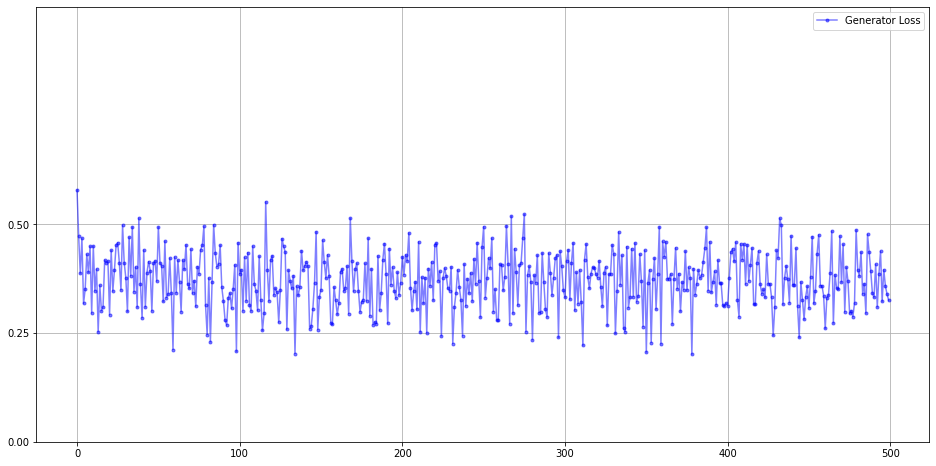

In [ ]:
plot_progress(netG_improved.progress, "Generator Loss", (0, 0.25, 0.5), (0, 1.0), 
              "blue", ".")

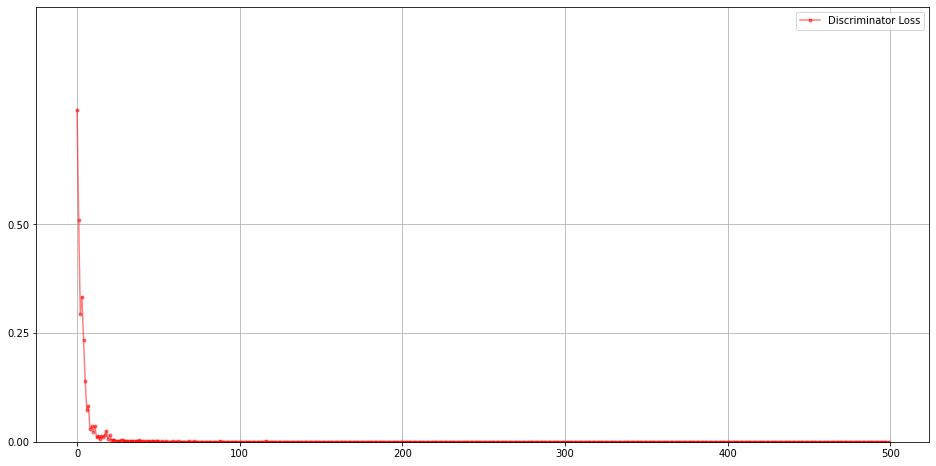

In [ ]:
plot_progress(netD_improved.progress, "Discriminator Loss", (0, 0.25, 0.5), (0, 1.0), 
              "red", ".")

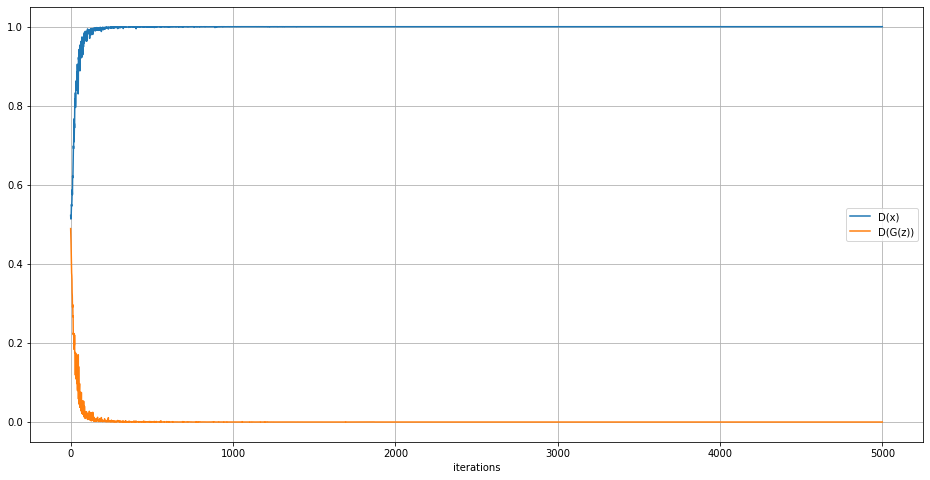

In [ ]:
# D(x) and D(G(z)) behavior
plt.figure(figsize=(16,8))
plt.plot(D_xs_improved,label="D(x)")
plt.plot(D_G_zs_improved,label="D(G(z))")
plt.xlabel("iterations")
plt.grid(True)
plt.legend()
plt.show()

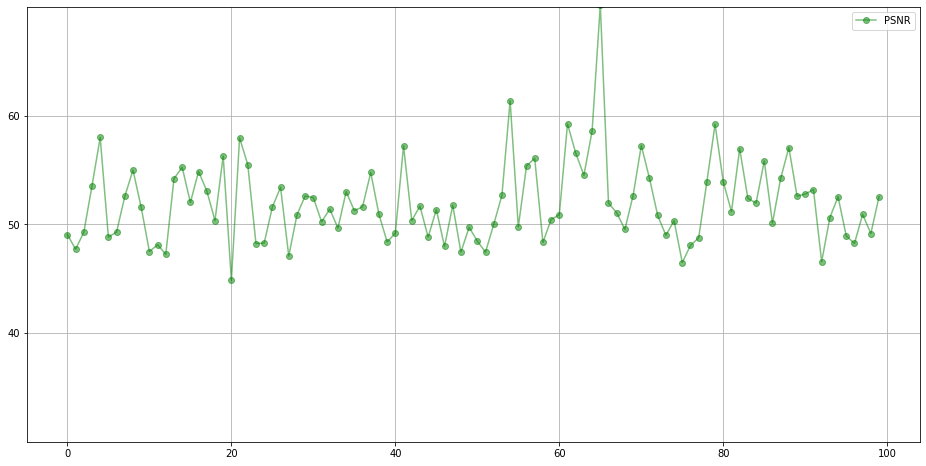

In [ ]:
plot_progress(psnrs_improved, "PSNR", (0, 40, 50, 60), (30, 70), 
              "green", "o")

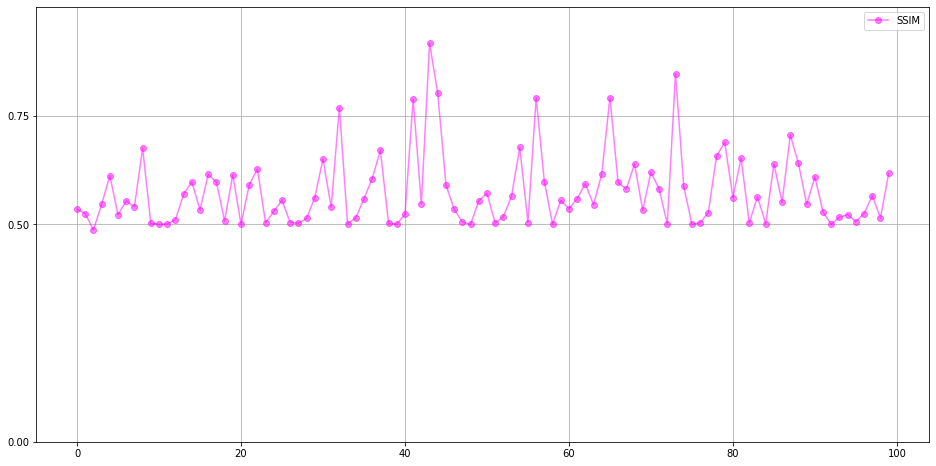

In [ ]:
plot_progress(ssims_improved, "SSIM", (0, 0.5, 0.75), (0, 1.0), 
              "magenta", "o")

In [ ]:
if LOAD_MODEL:

    netG_improved = Generator(scale_factor=4).to(DEVICE)
    netD_improved = Discriminator().to(DEVICE)
    
    load_checkpoint(CHECKPOINT_IMPROVED_GEN, netG_improved, optimizerG, LEARNING_RATE)
    load_checkpoint(CHECKPOINT_IMPROVED_DISC, netD_improved, optimizerD, LEARNING_RATE)

=> Loading checkpoint
=> Loading checkpoint


What we can notice up to here is that a convergence to 0.5 of $D(x)$ and $D(G(z))$ still does not occur. Rather, we can observe a clear improvement with respect to generator's loss which now assumes lower values and within a narrower range.

## Test results

We evaluate again the model against the Set5 dataset

In [ ]:
#improved SRGAN approach results
set5_improved = get_sr_images(netG_improved)

In [ ]:
psnr_values_improved, ssim_values_improved = compute_PSNR_SSIM(set5_improved)

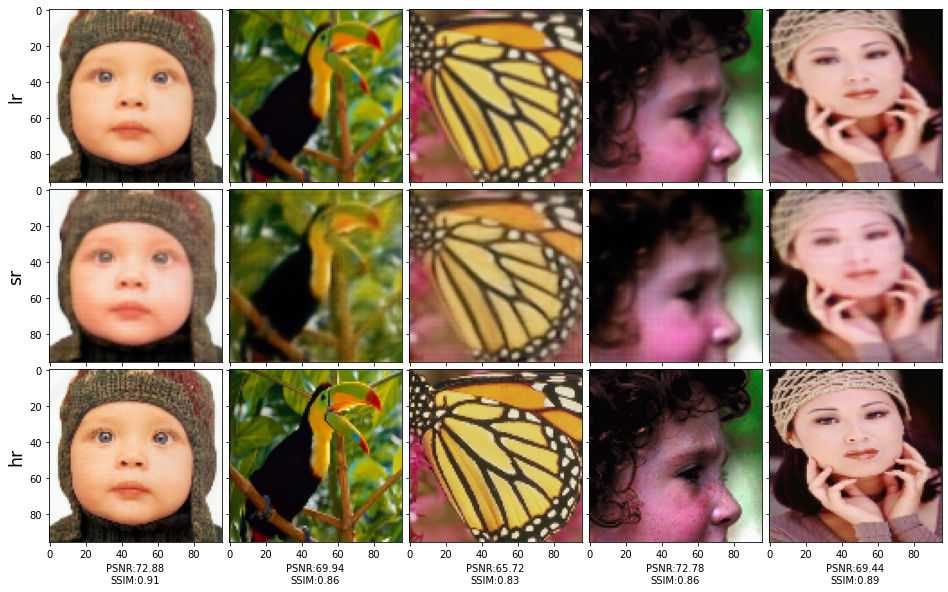

In [ ]:
in_set_improved = get_images_set(set5_improved)
show_grid(
    images=in_set_improved, 
    rows=3, 
    cols=5, 
    psnr_values=psnr_values_improved, 
    ssim_values=ssim_values_improved
    )

The output grid shows **low resolution images at row 0**, **super resolved images at row 1** and **original high resolution images at row 2**.

Even this noisy version of the SRGAN shows nice performances, corroborated by evaluation metric values.

# Comparison

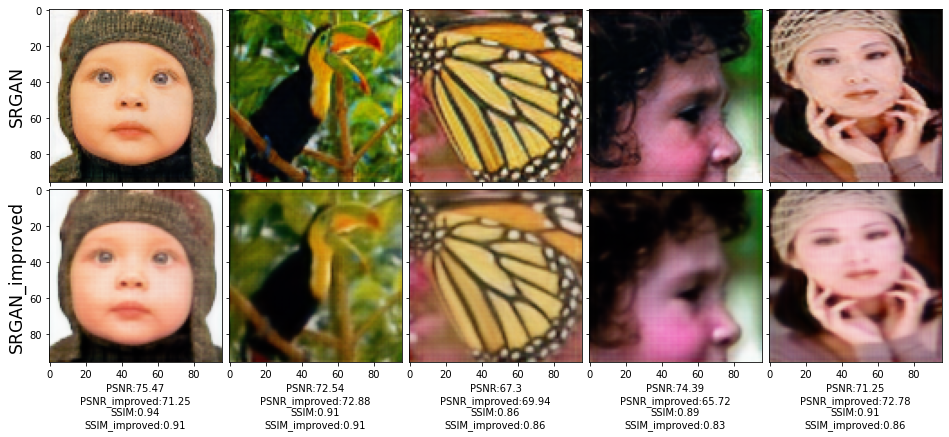

In [ ]:
in_set_comparison = join_sets(set5_gan, set5_improved)
psnr_comparison = join_sets(psnr_values_gan, psnr_values_improved)
ssim_comparison = join_sets(ssim_values_gan, ssim_values_improved)
show_grid(
    images=in_set_comparison, 
    rows=2, 
    cols=5, 
    psnr_values=psnr_comparison, 
    ssim_values=ssim_comparison,
    first_comparison=False
    )

What we can notice is that the noise presence does not bring us to a better model (with respect to the PSNR and SSIM metrics). In some sample the noise means better metrics but not necessarily in all. What we do notice, instead, is the absence of the above mentioned *edge halos*, even if there is still some *blurring artifacts*.
Both models provides acceptable results and evaluation matric values are comparable.

# References

1. [Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network](https://arxiv.org/abs/1609.04802) (Ledig et al. 2017)
2. [NTIRE 2017 Challenge on Single Image Super-Resolution: Dataset and Study](https://people.ee.ethz.ch/~timofter/publications/Agustsson-CVPRW-2017.pdf) (Agustsson and Timofte, 2017)
3. [Image quality assessment: from error visibility to structural similarity](https://www.cns.nyu.edu/pub/lcv/wang03-preprint.pdf) (Wang et al. 2004)

# Contributors



*   Valerio Valente (valeriovalente96@gmail.com)
*   Elisa Foderaro (foderaro.1946278@studenti.uniroma1.it)


